In [ ]:
import tensorflow as tf
from keras import backend as K
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from keras.metrics import categorical_accuracy, binary_accuracy,mae, mape
from keras.optimizers import Adam
from keras.utils import to_categorical

import lightgbm as lgb

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from math import floor, ceil



from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression, SGDRegressor
from sklearn.metrics import r2_score, f1_score, accuracy_score
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

from ulib.experiments import *

from sklearn.datasets import make_blobs, make_classification, \
                              make_circles, make_moons
%matplotlib inline

# Params

In [0]:
SEED = 1812
GET_MODEL_FROM_GDRIVE = False

# Init seeds

In [0]:
np.random.seed(SEED)
tf.set_random_seed(seed=SEED)

# Generate dataset

In [0]:
# X, y = make_moons(n_samples=10000, noise=0.25, random_state=SEED)

In [0]:
# X, y = make_circles(n_samples=10000, random_state=SEED, factor=0.7, noise=0.2)

In [0]:
# X, y = make_blobs(n_samples=1000, center_box=(-5, 5), cluster_std=5, n_features=2, centers=2, random_state=SEED)

In [0]:
# X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)

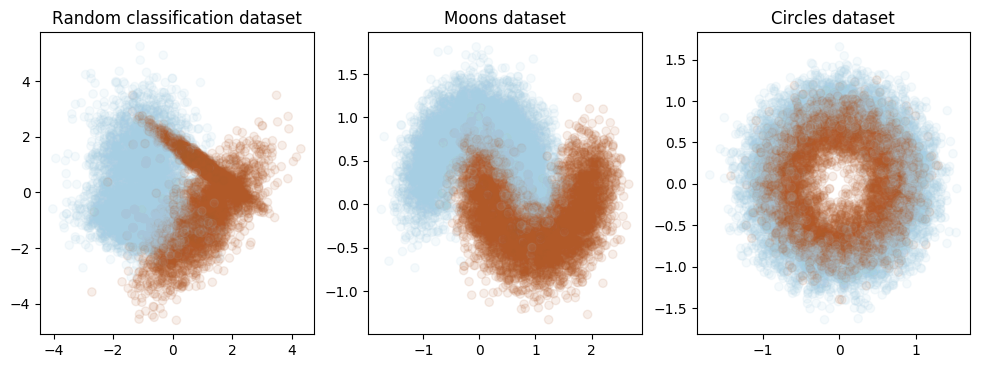

In [0]:
plt.figure(figsize=(12,4), dpi=100)

X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)
plt.subplot(1, 3, 1)

plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, alpha=0.1)
plt.title('Random classification dataset')

X, y = make_moons(n_samples=10000, noise=0.25, random_state=SEED)
plt.subplot(1, 3, 2)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, alpha=0.1)
plt.title('Moons dataset')

X, y = make_circles(n_samples=10000, random_state=SEED, factor=0.7, noise=0.2)
plt.subplot(1, 3, 3)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, alpha=0.1)
plt.title('Circles dataset')
plt.show()

# Run Experiment

## Make Random Classification Dataset

In [0]:
X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)

### Experiment_1 - LinReg: 
- **Linear Regression** in TF
- **Linear** activation on the end
- **MAE** loss


/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


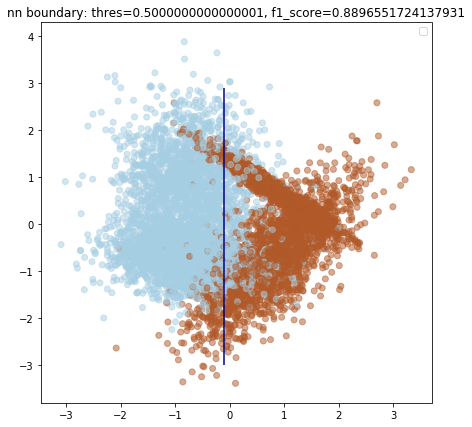

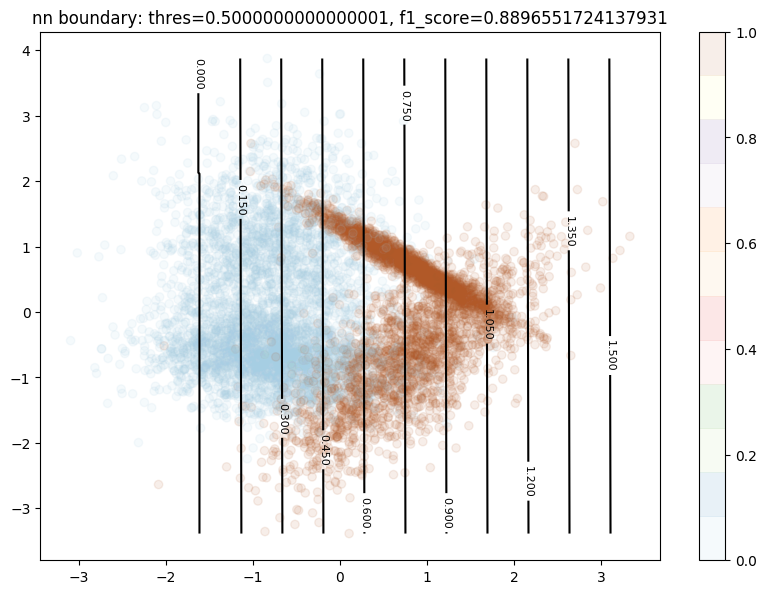


NN acc = 0.8905, f1 = 0.8917449332674247


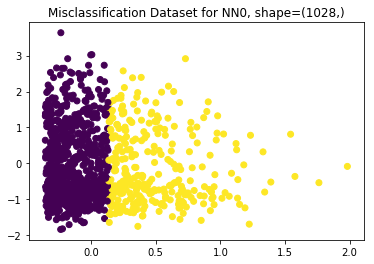

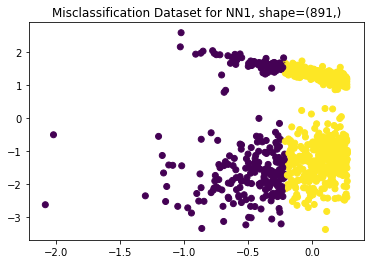

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


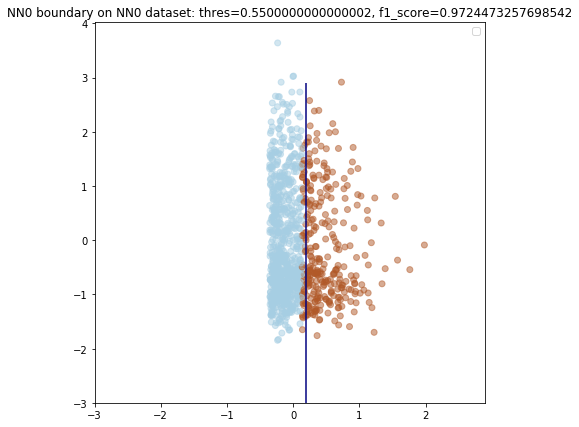

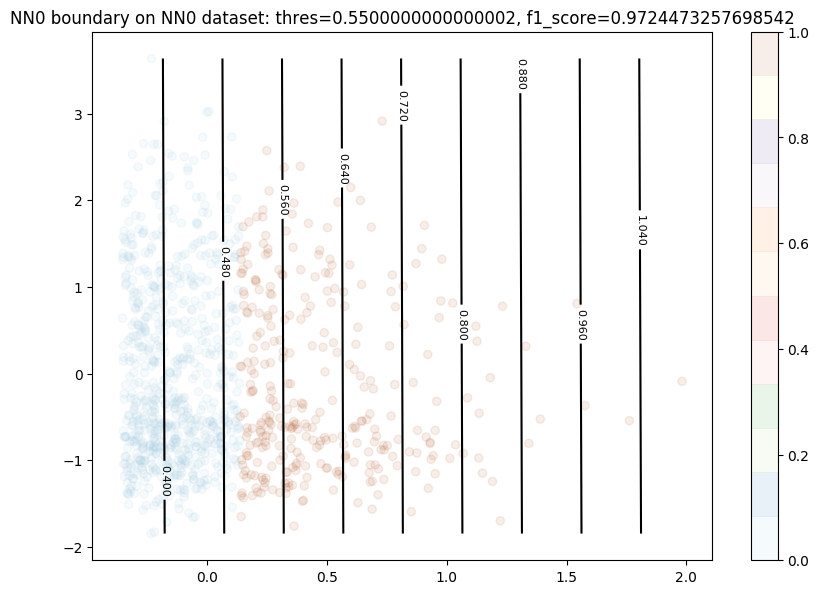

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


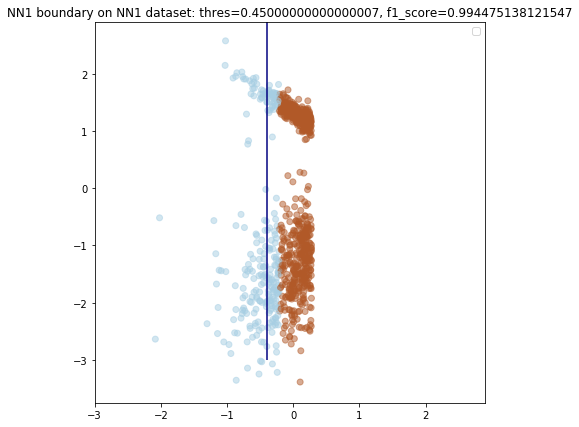

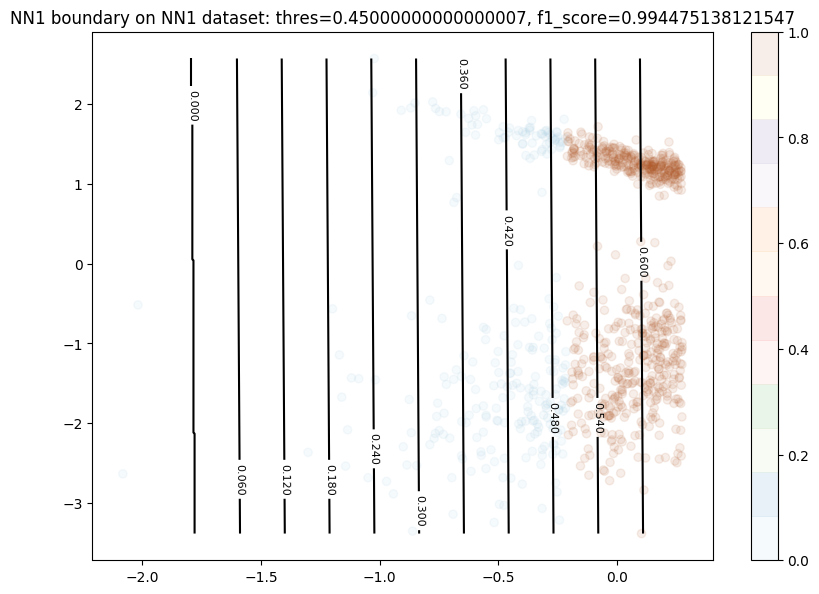

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


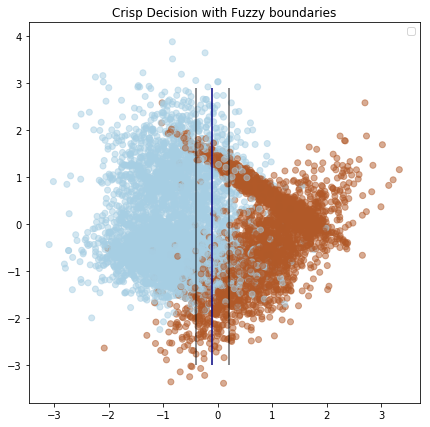

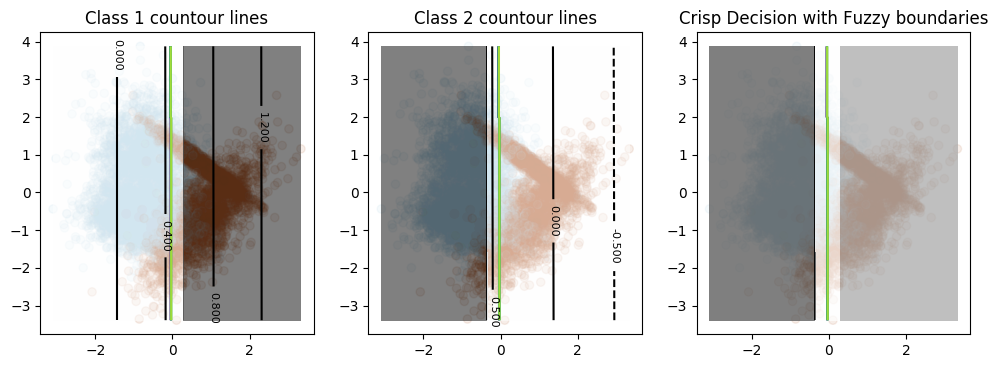

(100,)
(100,)


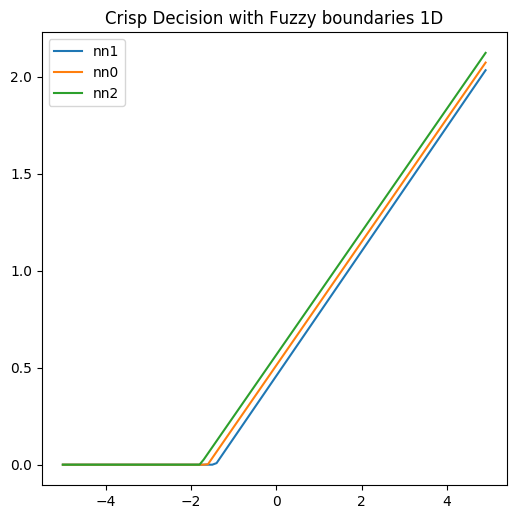

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 200,
    "epochs": 20,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Neuro_lin_exp_decomp',
      'lmbd': -0.2, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.4,
      'right_proba': 0.6
  }
  
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_2 - LinClass: 
- **Linear Classification** in TF
- **Softmax, Sigmoid, Sigmoid**  activation on the end
- **categorical_cross_entropy, MAE, MAE** loss

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


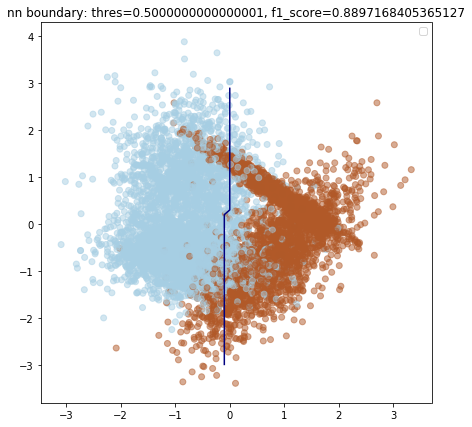

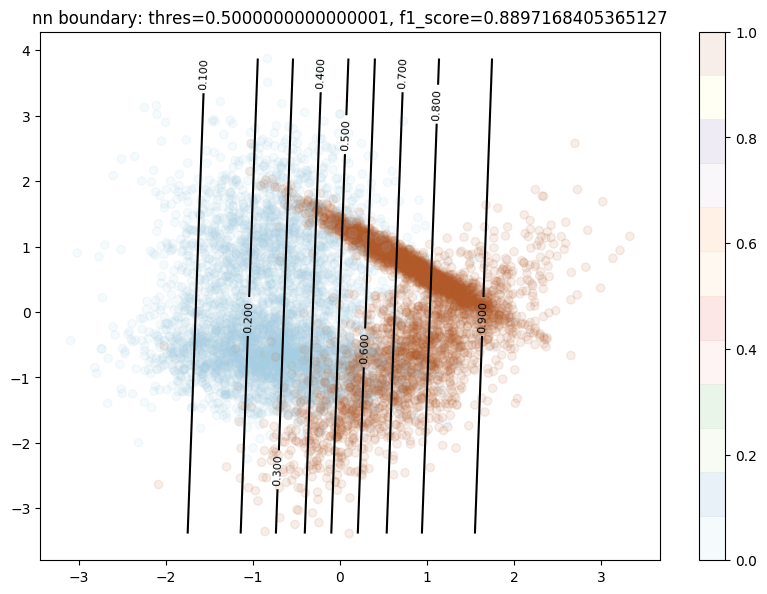


NN acc = 0.89, f1 = 0.8905472636815921


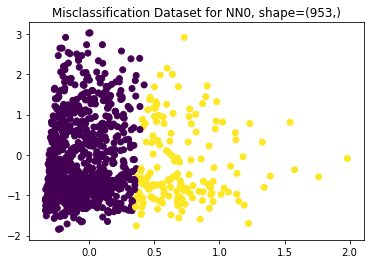

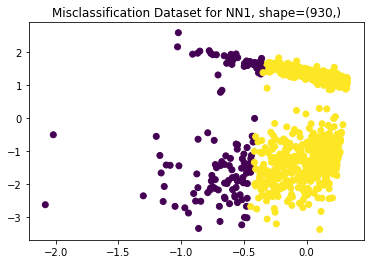

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


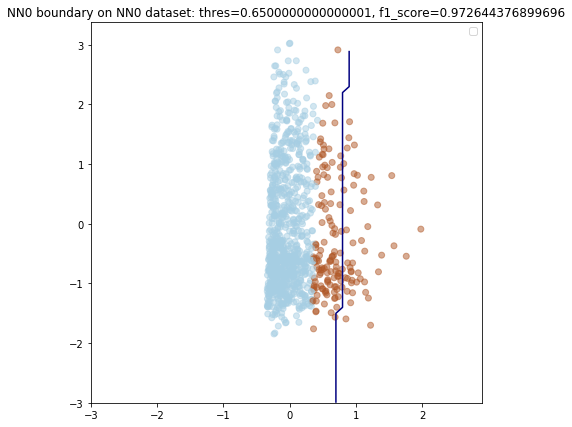

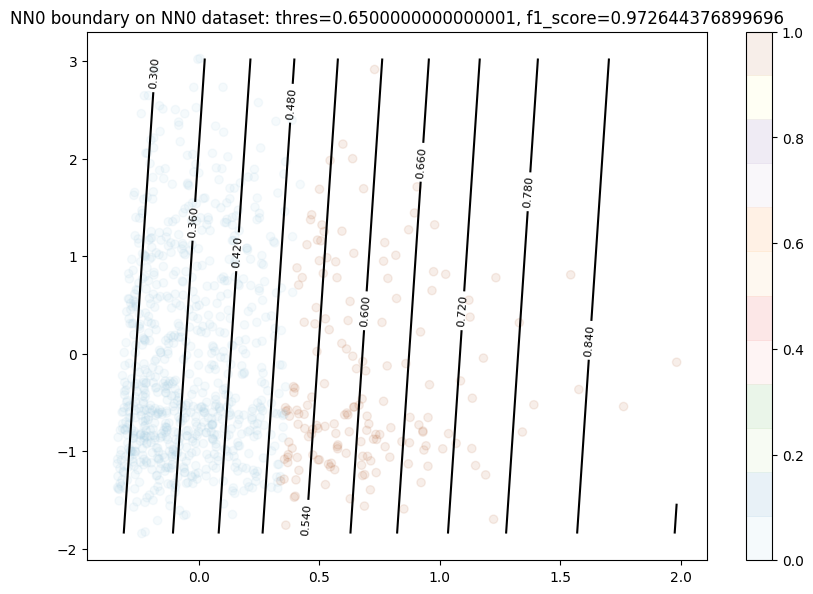

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


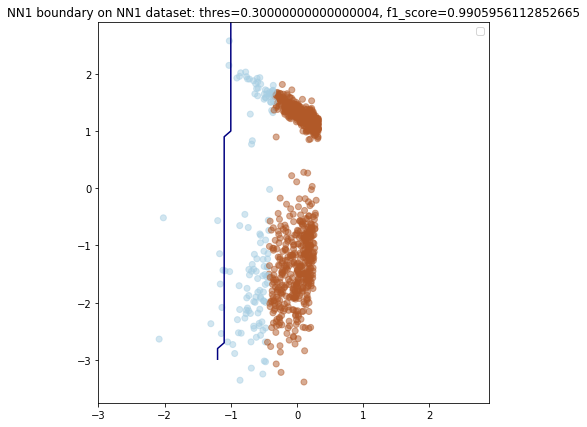

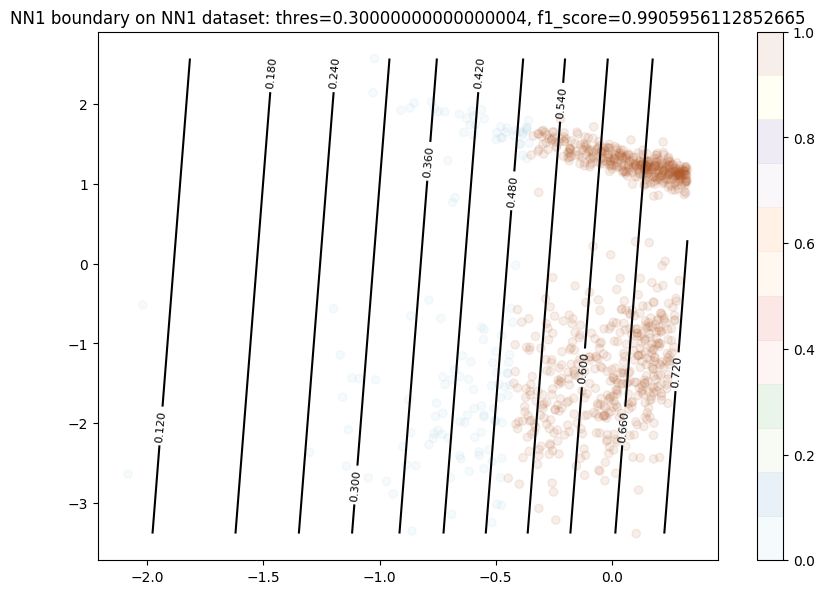

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


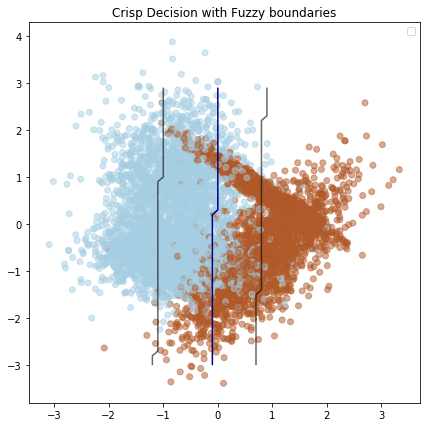

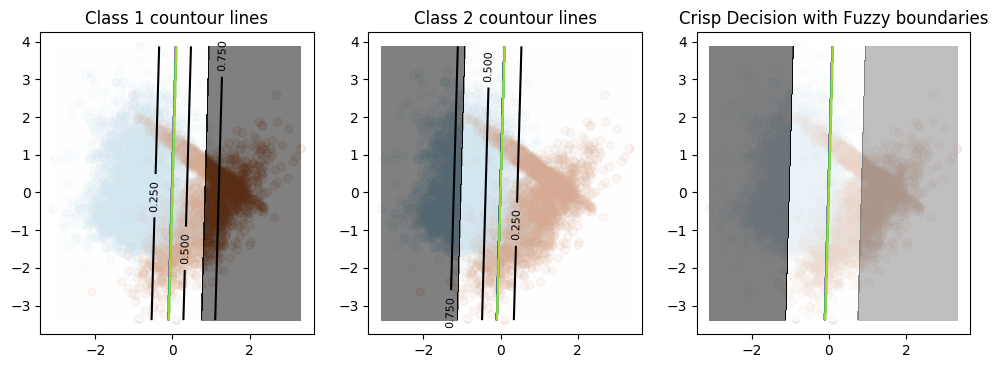

(100,)
(100,)


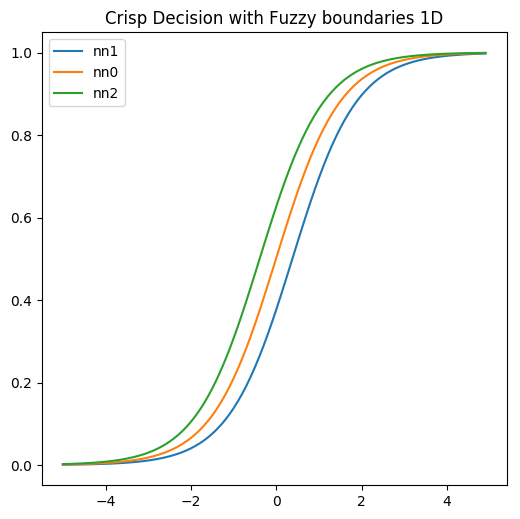

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 200,
    "epochs": 20,
    "num_classes": 2,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [mae, mape],
    "get_model_method": make_binary_model,
    "last_activation": "softmax",
    "is_classification": True
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Neuro_lin_exp_decomp',
      'lmbd': -0.4, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.4,
      'right_proba': 0.6
  }
  
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_3 - NN Class: 
- **NN** model in TF  
- **Softmax, linear, linear** activation on the end
- **MAE** loss


In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 512,
    "steps_per_epoch": 2000,
    "epochs": 150,
    "num_classes": 2,
    "last_finished_epoch": 0,
    "dense_layers": [32, 96, 32],
    "dense_dropout": None,
    "activation": ["relu", "relu", "relu"],
    "kernel_init": ['normal', 'normal', 'normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "softmax",
    "is_classification": True
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 256,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [32, 64],
    "dense_dropout": None,
    "activation": ["relu", "relu"],
    "kernel_init": ['normal', 'normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 256,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [32, 64],
    "dense_dropout": None,
    "activation": ["relu", "relu"],
    "kernel_init": ['normal', 'normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Neuro_lin_exp_decomp',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.2,
      'right_proba': 0.8
  }

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


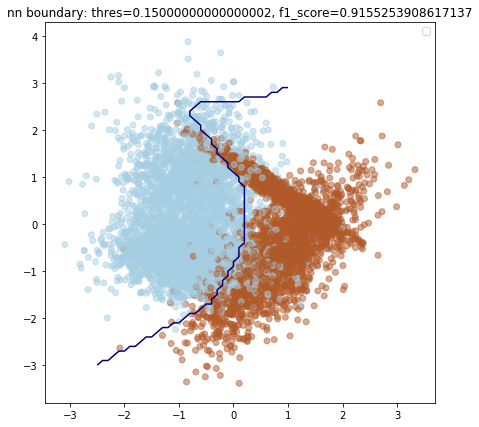

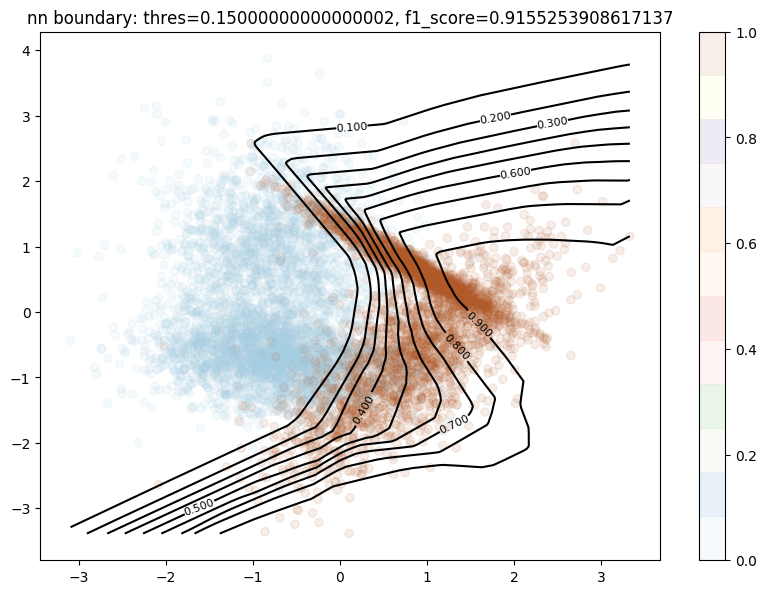


NN acc = 0.916, f1 = 0.9202279202279202


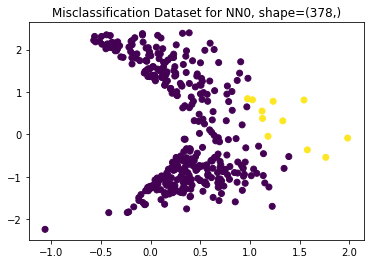

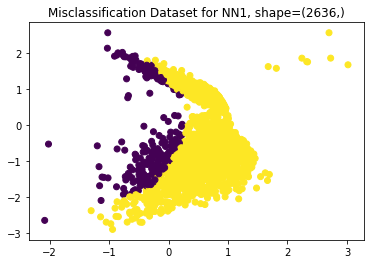

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


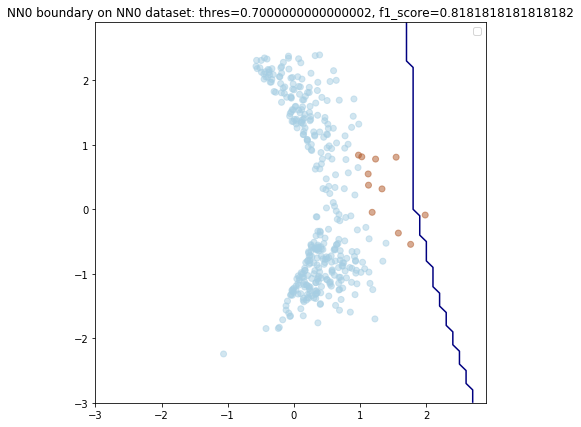

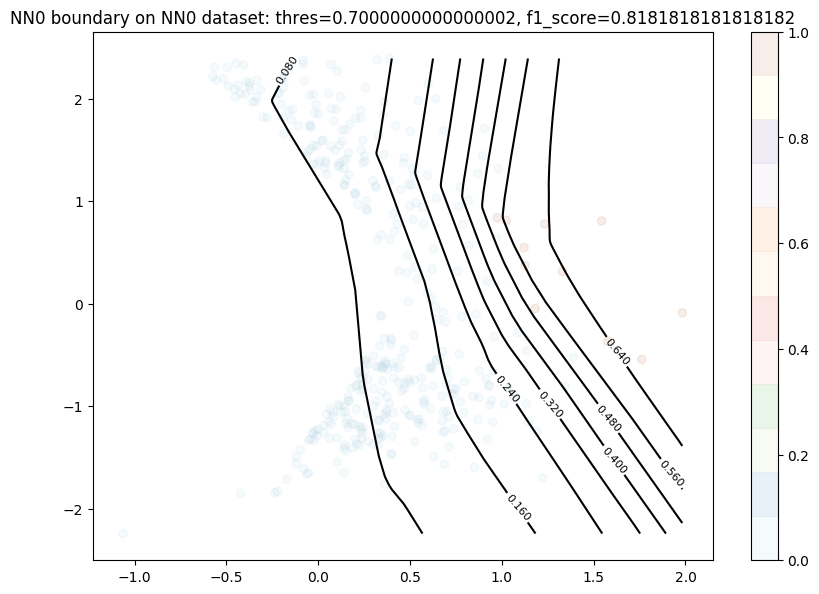

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


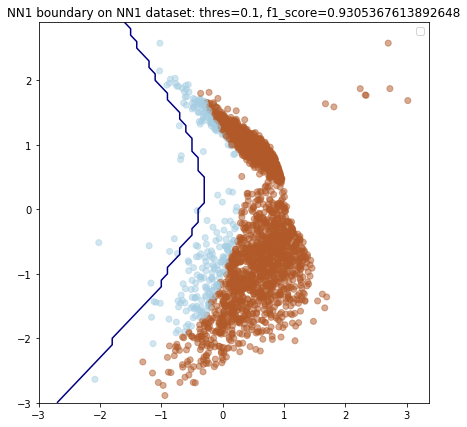

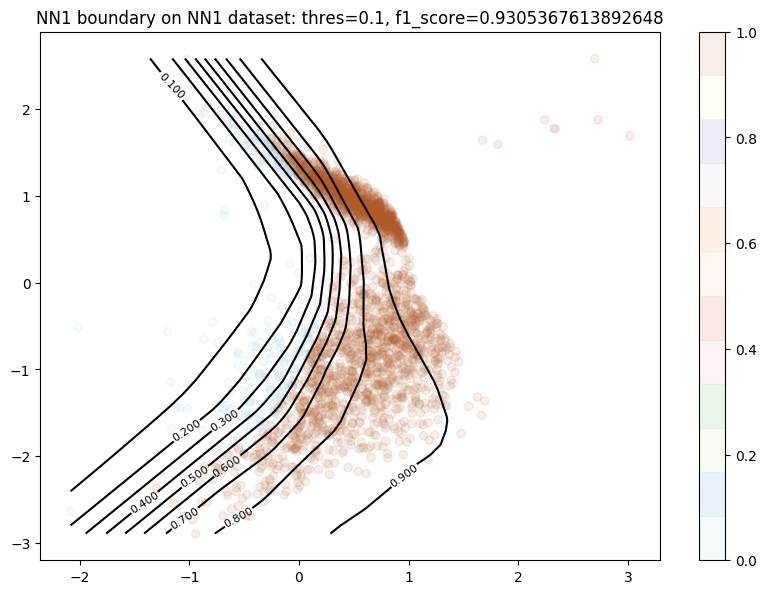

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


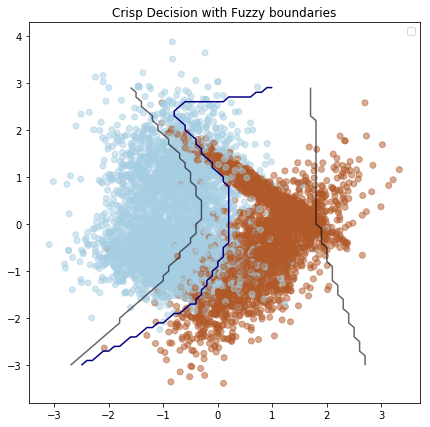

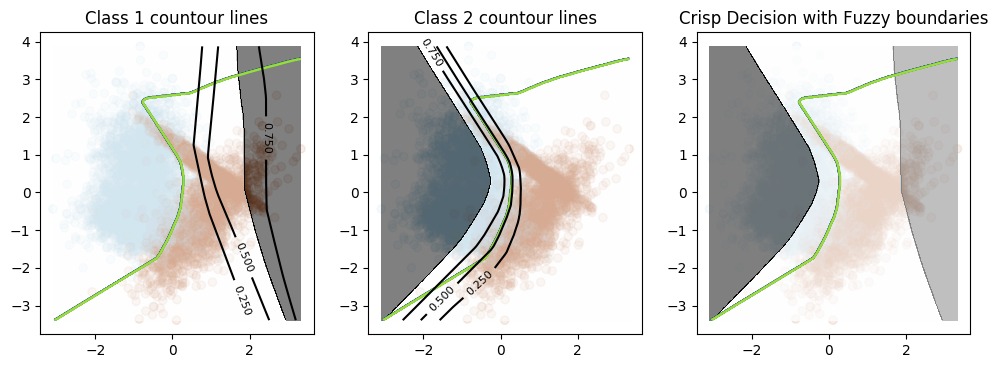

(100,)
(100,)


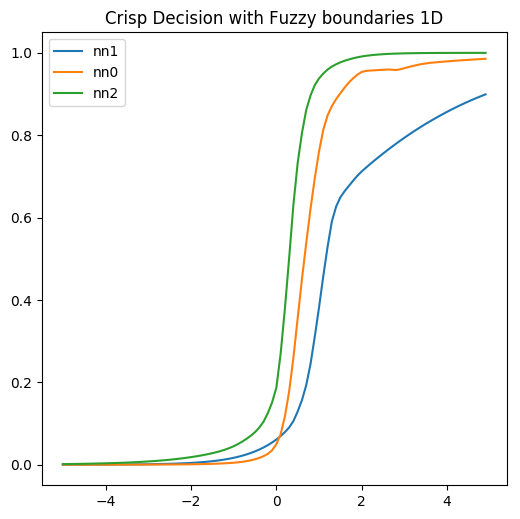

In [0]:
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_4 - RF Class: 
- **RF** classification + regression
- **Gini, MSE, MSE** loss
- Make Classification


In [0]:
# X, y = make_circles(n_samples=10000, random_state=SEED, factor=0.7, noise=0.25)
# X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)

if not GET_MODEL_FROM_GDRIVE:
  rf0_config = {
    "name": "rf0",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 5
  }
  
  rf1_config = {
    "name": "rf1",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 5
  }
  
  rf2_config = {
    "name": "rf2",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 5
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'RF_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.2,
      'right_proba': 0.8
  }

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


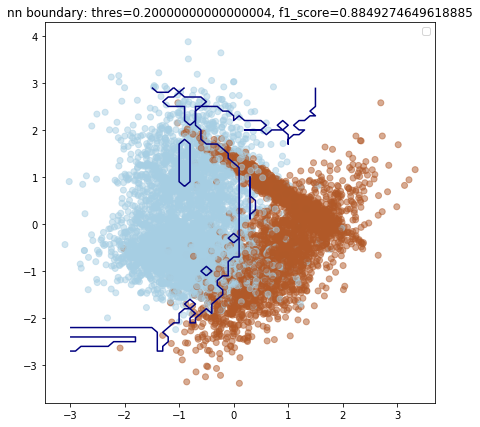

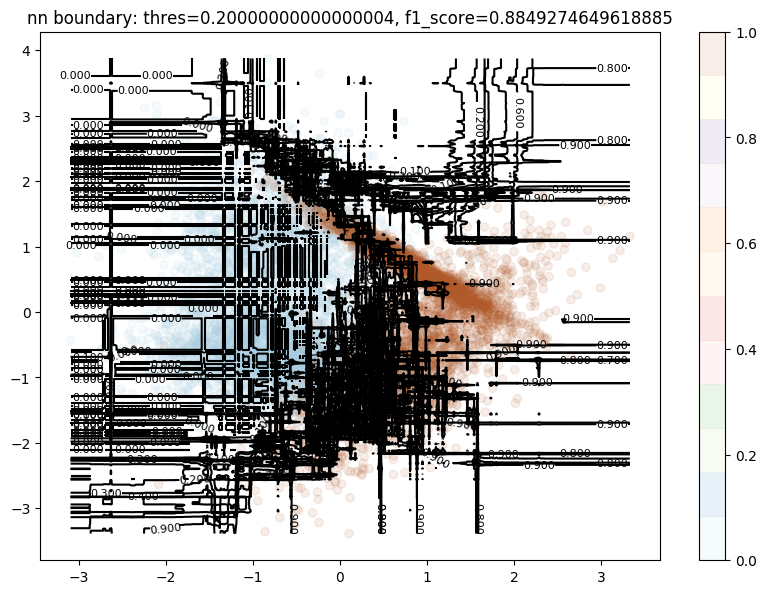

[0.006 0.    0.978 ... 0.032 0.476 0.932]
[1 0 1 ... 0 1 1]

NN acc = 0.925, f1 = 0.9284351145038168


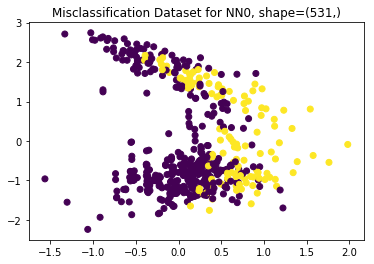

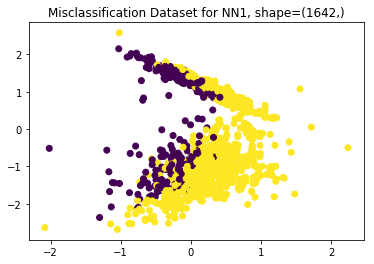

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


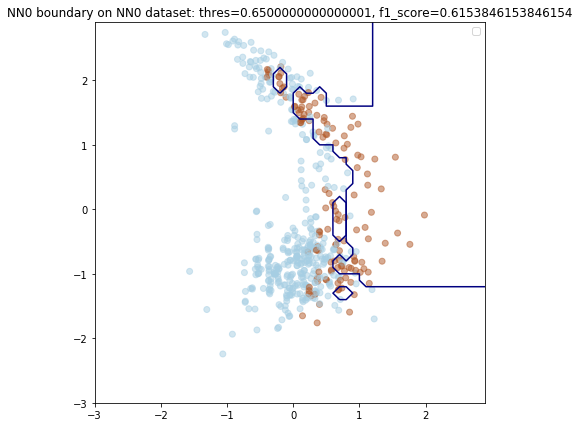

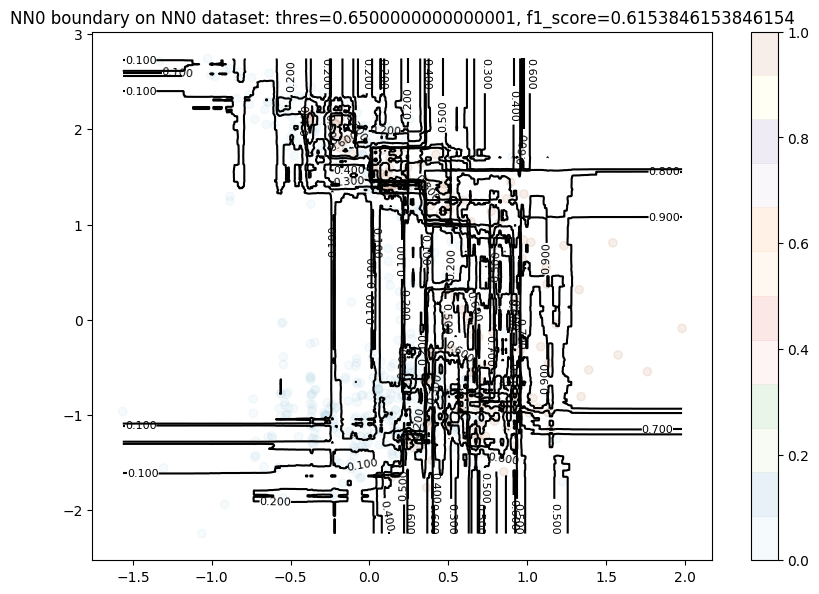

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


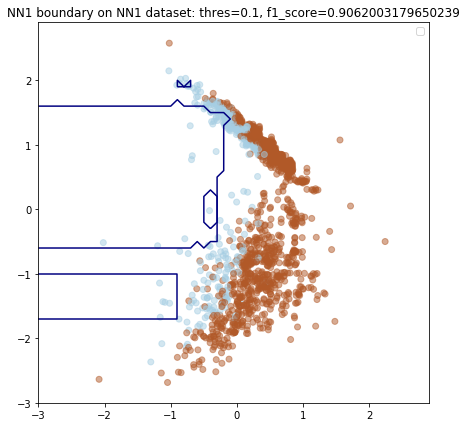

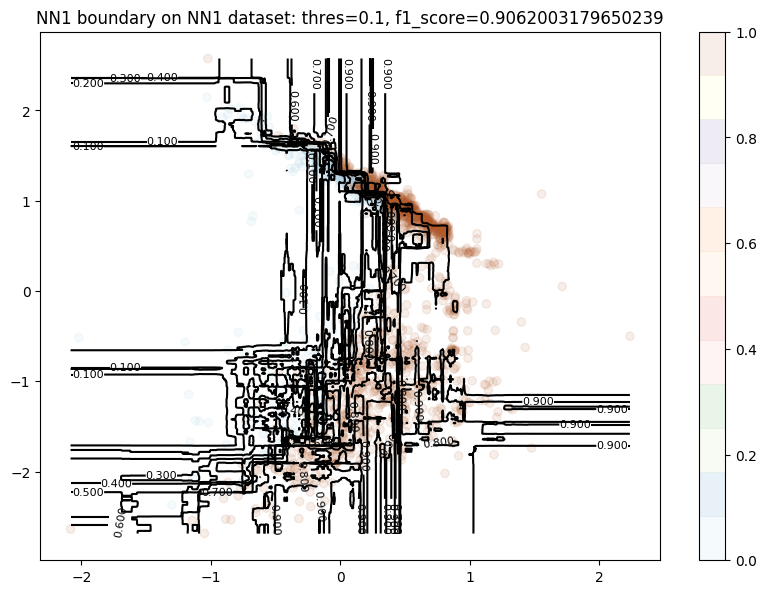

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


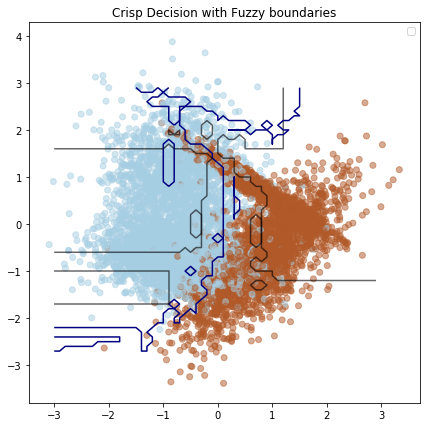

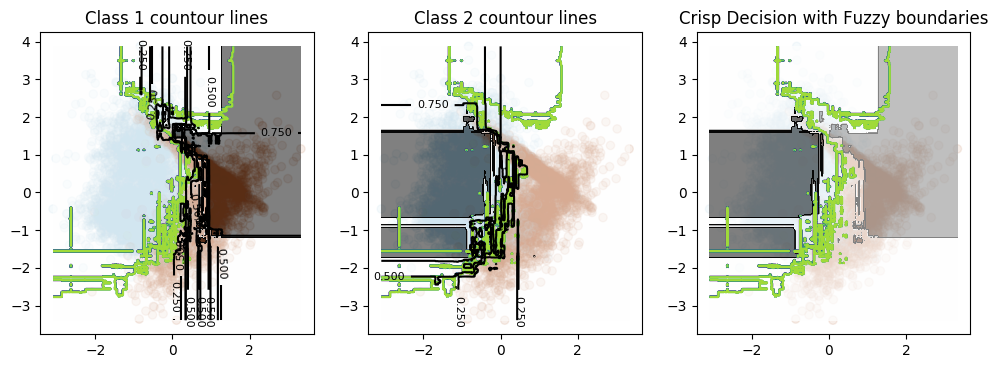

(100,)
(100,)


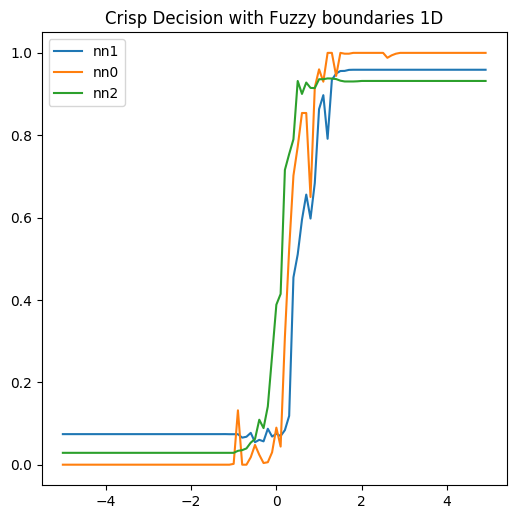

In [0]:
ml_experiment(rf0_config, rf1_config, rf2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_5 - - LGBM Non Monotone: 
- **Gradient boosting** model (**No monotonic constraint**)
- **MAE** loss


In [0]:
# X, y = make_circles(n_samples=10000, random_state=SEED, factor=0.7, noise=0.25)
# X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)

if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 100,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 4,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.5, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=5,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=100,
        n_jobs=-1, num_leaves=31, num_threads=4, objective='binary',
        random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
        subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
        verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


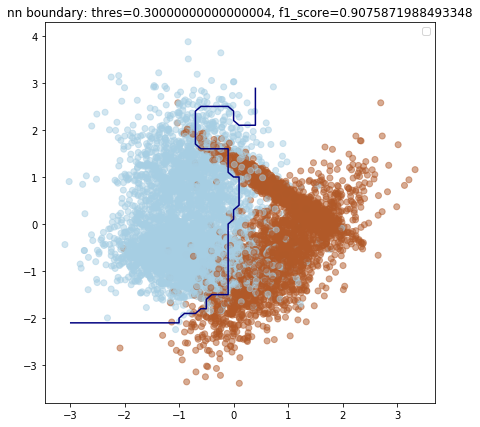

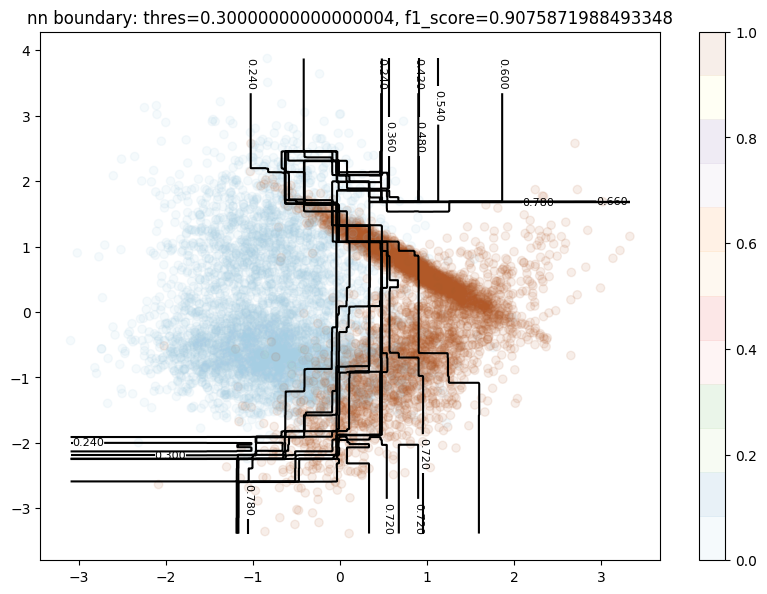

[0.18832714 0.18832714 0.80402884 ... 0.21884847 0.5594717  0.74443531]
[1 0 1 ... 0 1 1]

NN acc = 0.9145, f1 = 0.9192253188474255


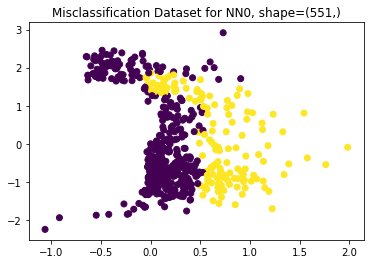

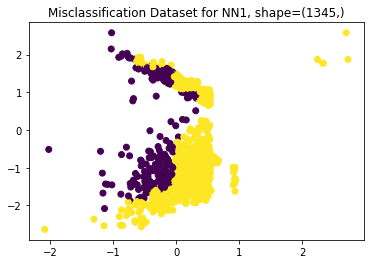

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=4,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=100,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)
LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


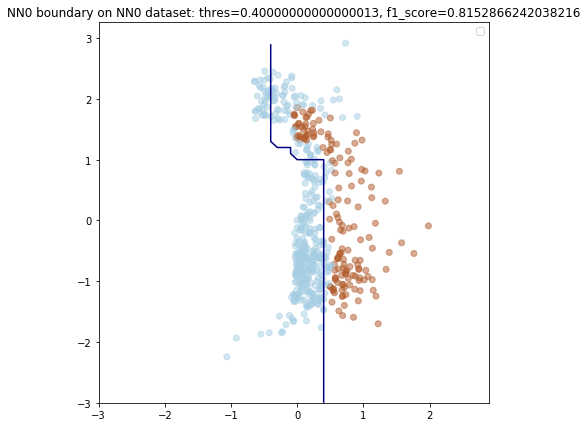

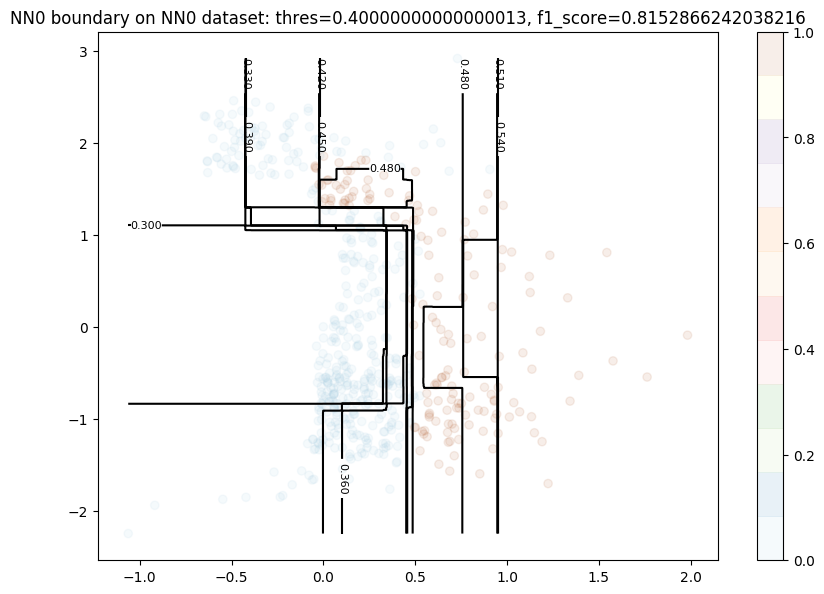

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


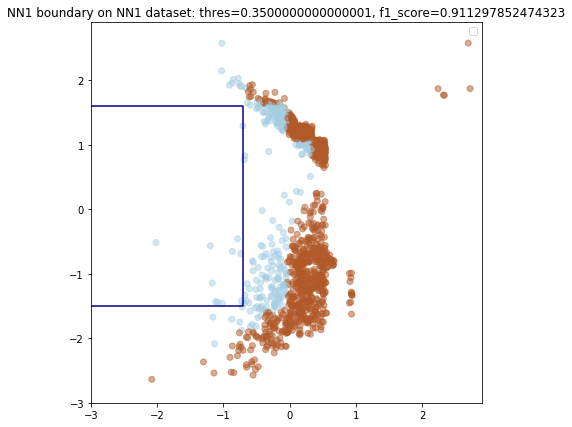

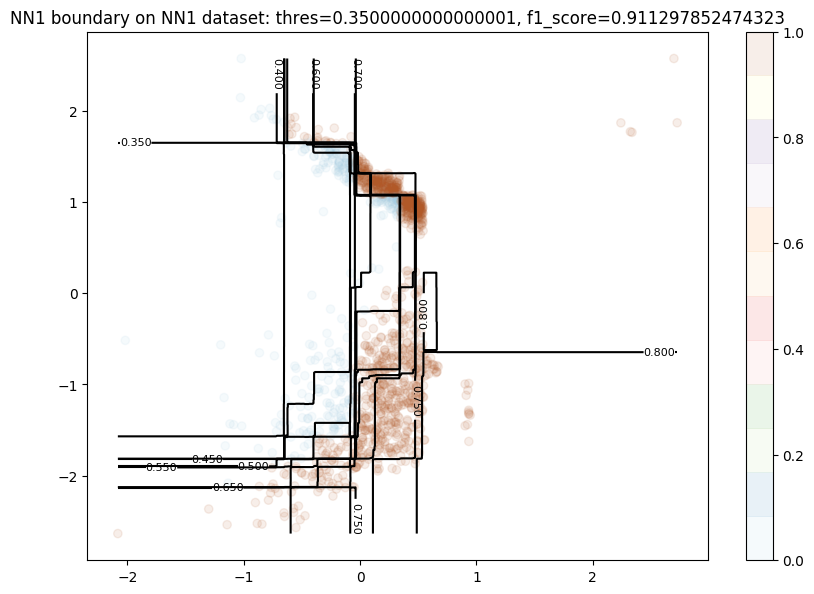

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


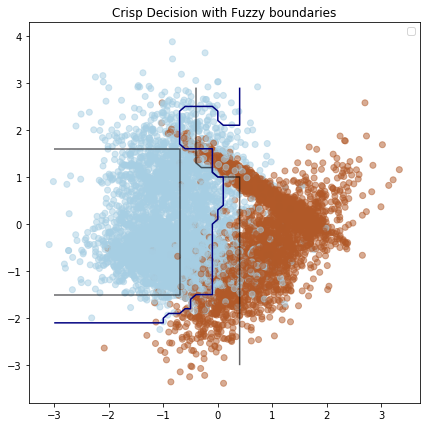

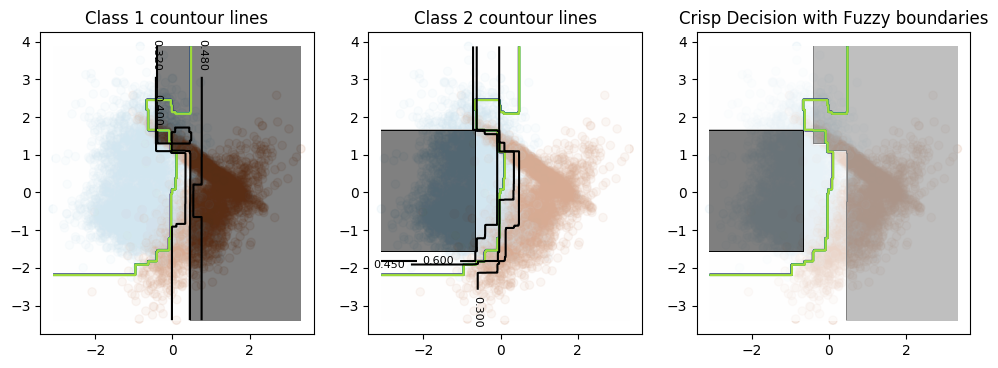

(100,)
(100,)


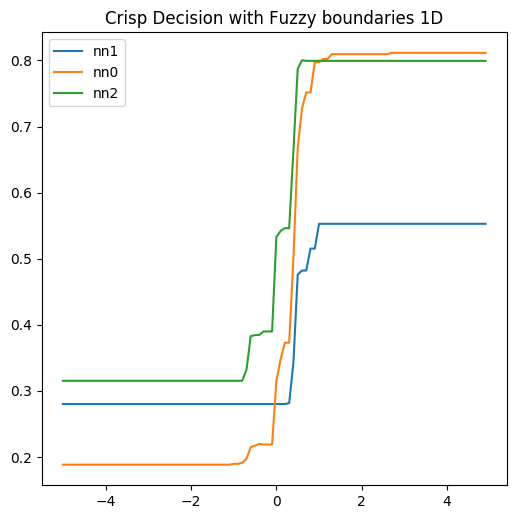

In [0]:
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_6 - LGBM Monotone: 
- **Gradient boosting** model (**With Monotonic constraint**)
- **MAE** loss


In [0]:
# X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)



if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,1)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1, 0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=6,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, monotone_constraints=(1, 1), n_estimators=500,
        n_jobs=-1, num_leaves=31, num_threads=4, objective='binary',
        random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
        subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
        verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


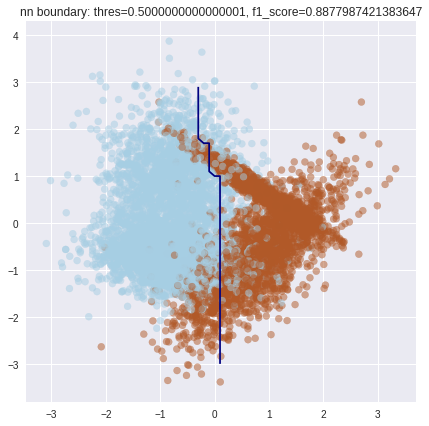

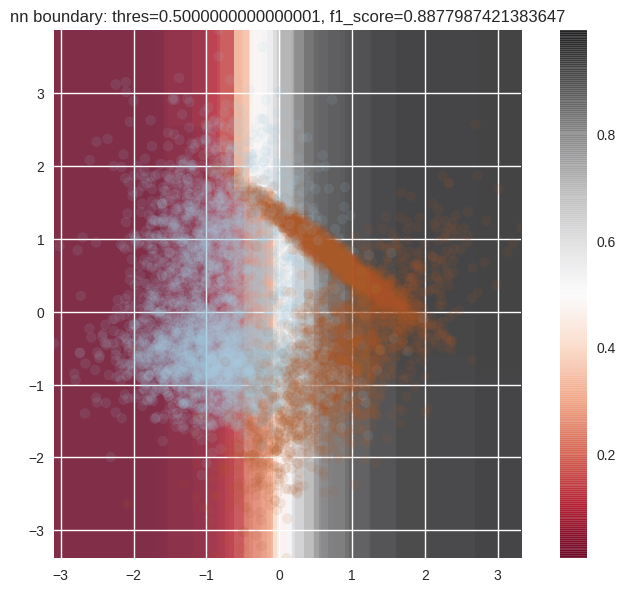

[0.02285421 0.0060561  0.94972994 ... 0.31286782 0.2475967  0.29327342]
[0 0 1 ... 0 0 1]

NN acc = 0.893, f1 = 0.8931068931068931


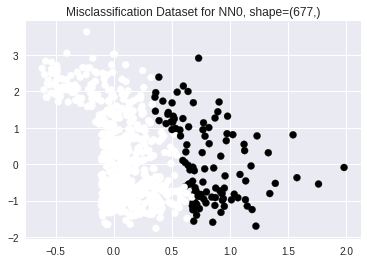

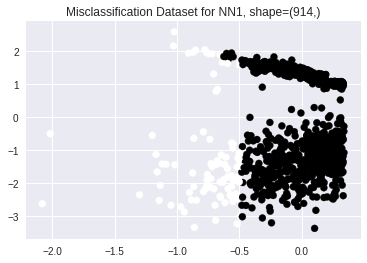

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(1, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(1, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


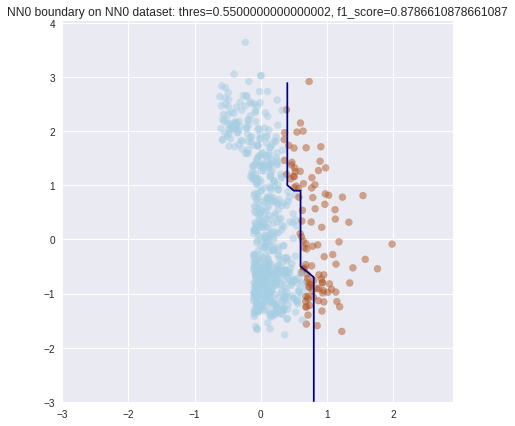

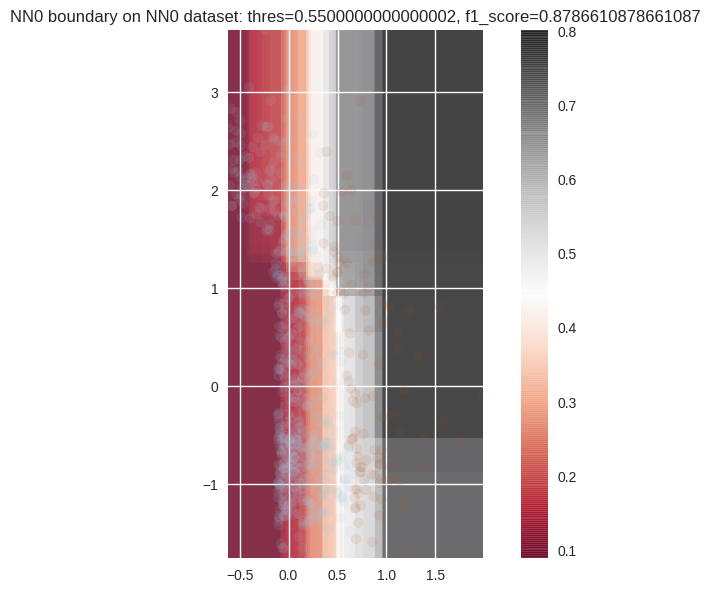

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


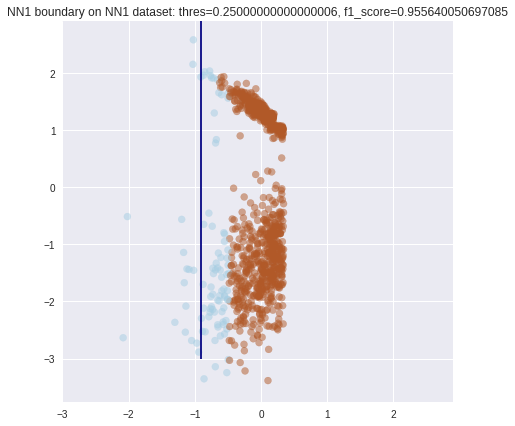

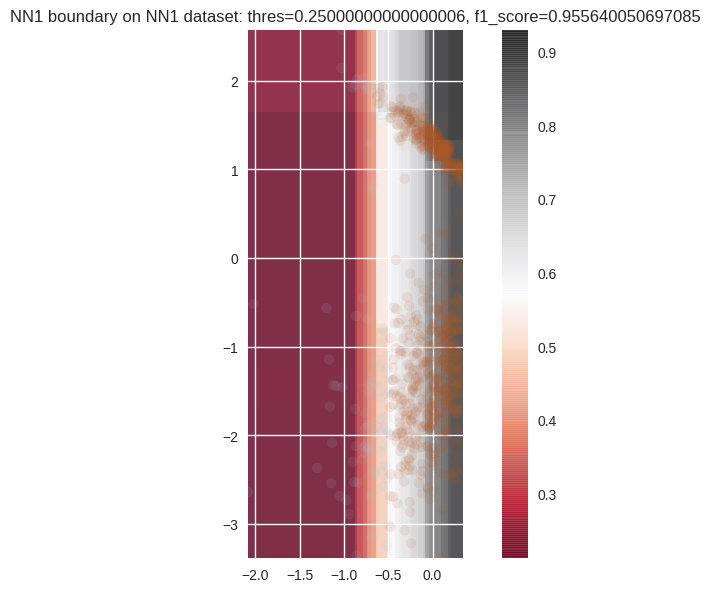

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


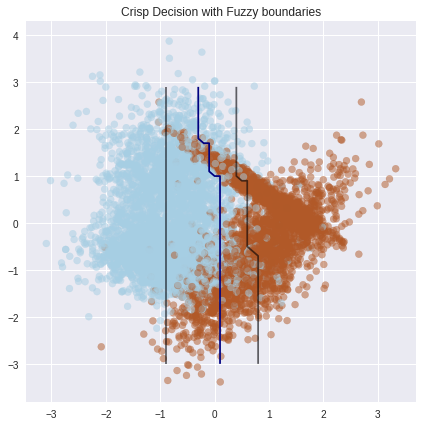

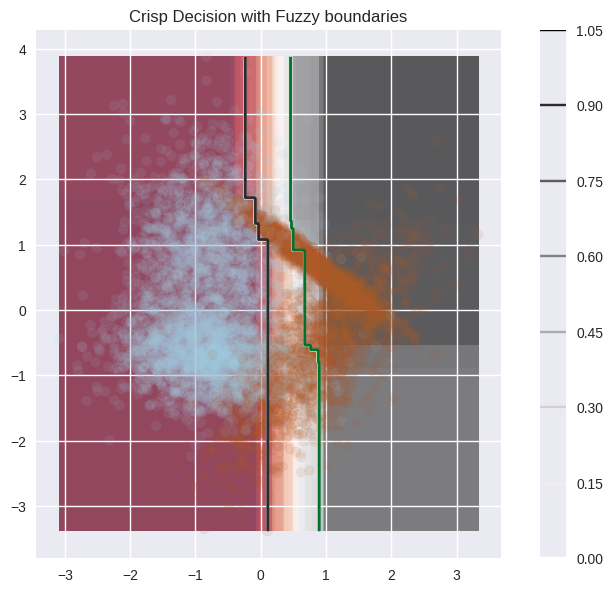

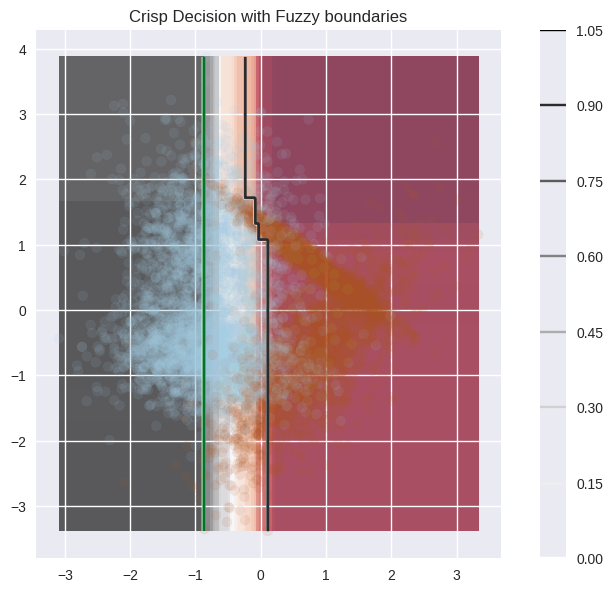

(100,)
(100,)


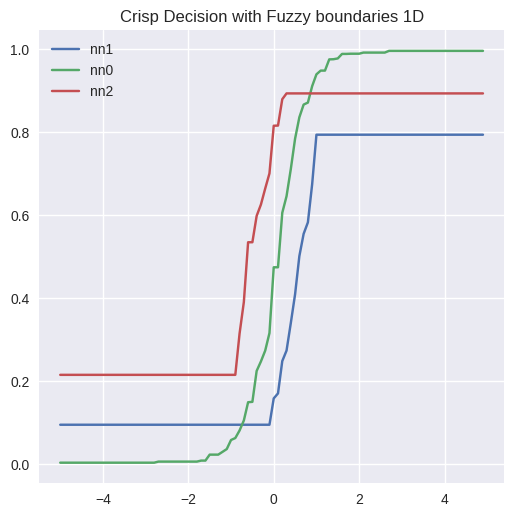

In [0]:
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])


показать, что результаты воспроизводимы  
параметры  
почему именно такие параметры
небольшой самодостаточный вывод - некоторая интерпретация в привязке к изначальной статье   
предположения  
нюансы



большой вывод 
просуммировать все недостатки(надо больше датасетов = что отделяет от обобщения) и еще раз по гипотезам(небольшим заключениям)

## Make moons

In [0]:
X, y = make_moons(n_samples=10000, noise=0.35, random_state=SEED)

### Experiment_1 - LinReg: 
- **Linear Regression** in TF
- **Linear** activation on the end
- **MAE** loss


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


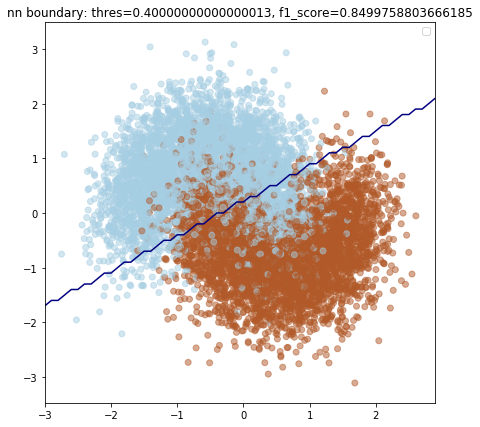

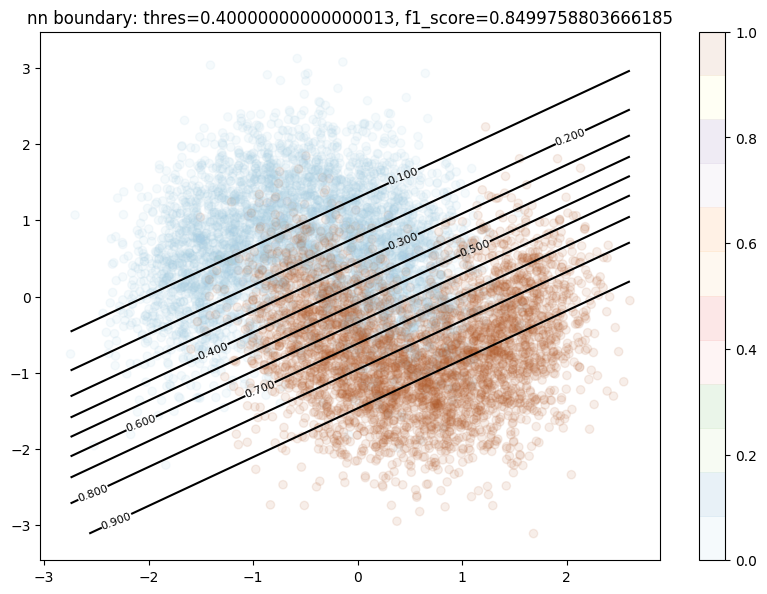


NN acc = 0.822, f1 = 0.8325493885230479


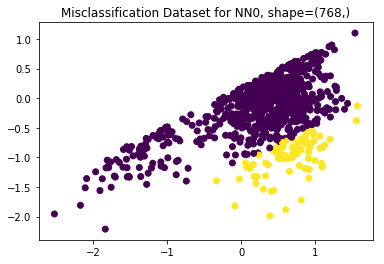

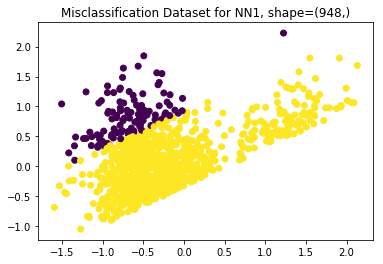

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


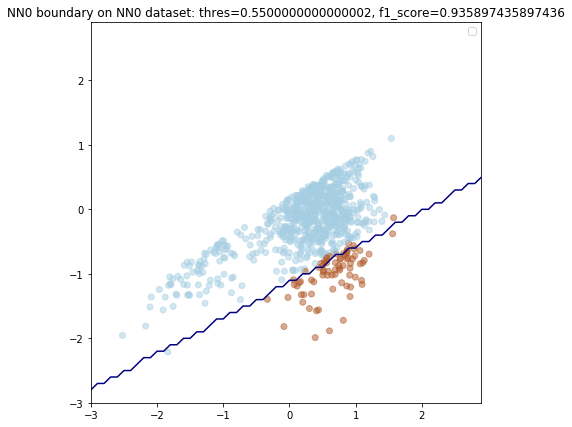

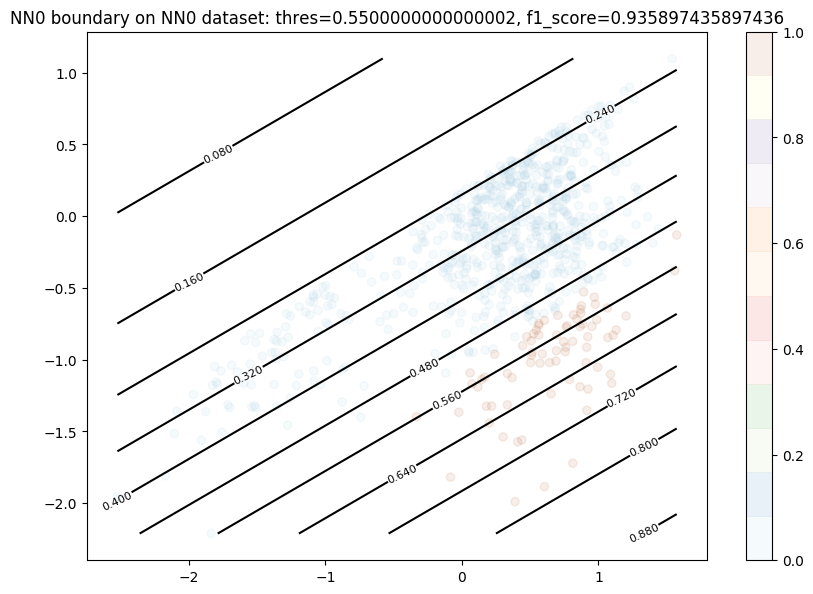

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


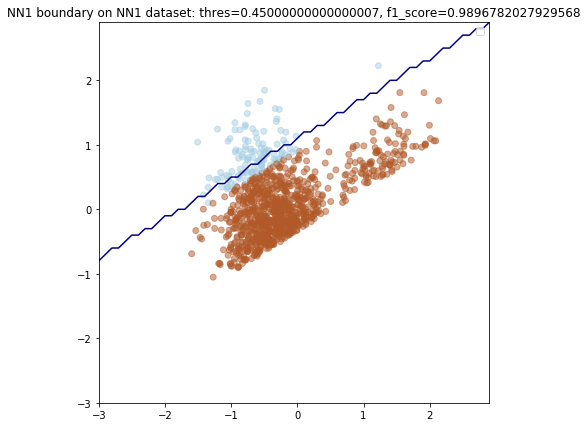

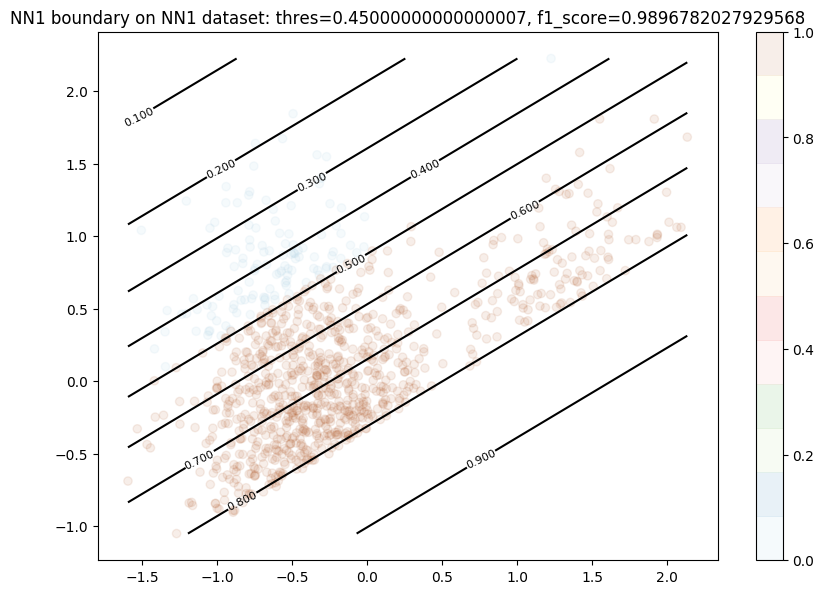

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


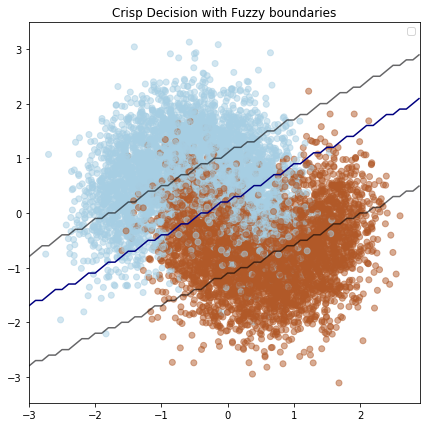

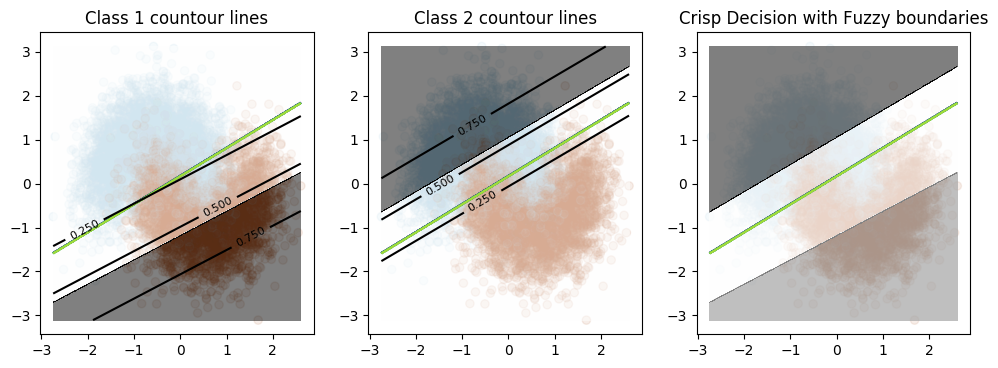

(100,)
(100,)


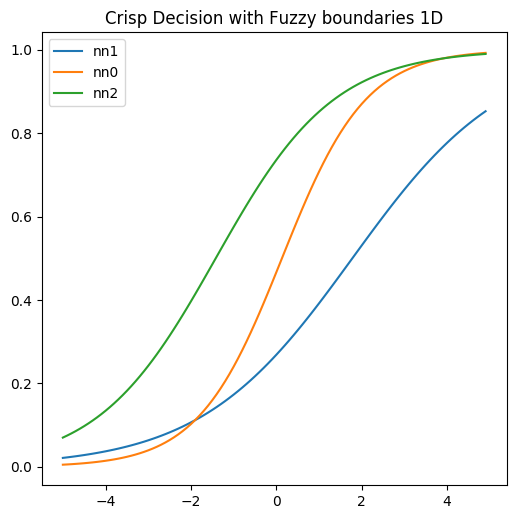

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 200,
    "epochs": 20,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Linear regression with sigmoid',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.4,
      'right_proba': 0.6
  }
  
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_2 - LinClass: 
- **Linear Classification** in TF
- **Softmax, Sigmoid, Sigmoid**  activation on the end
- **categorical_cross_entropy, MAE, MAE** loss

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


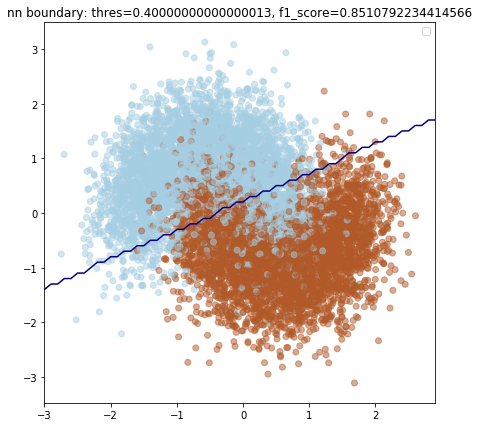

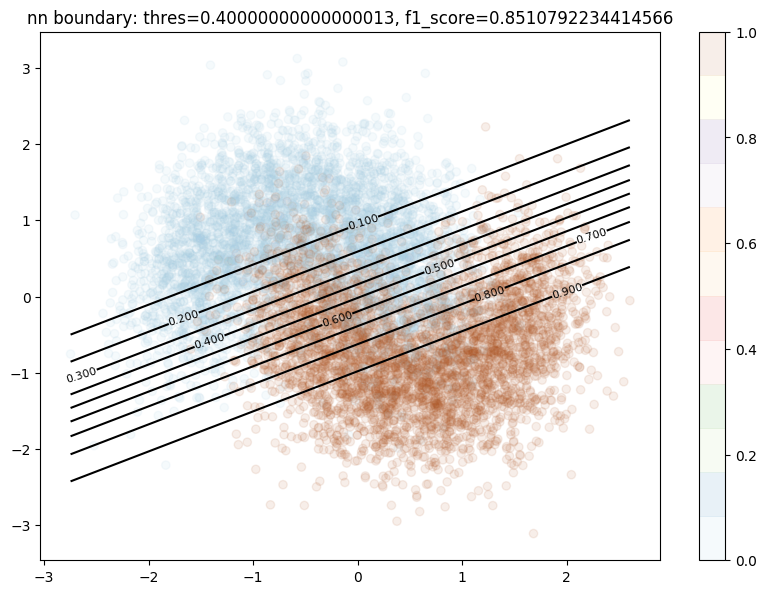


NN acc = 0.8305, f1 = 0.8383404864091558


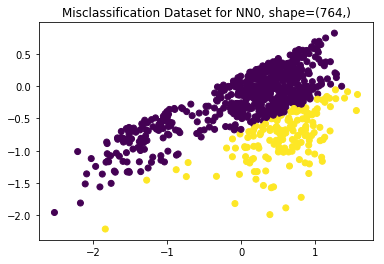

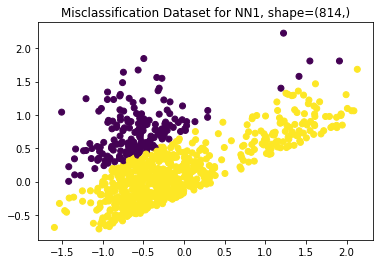

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


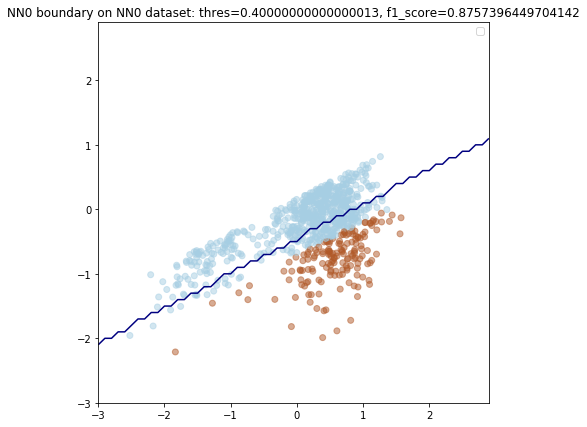

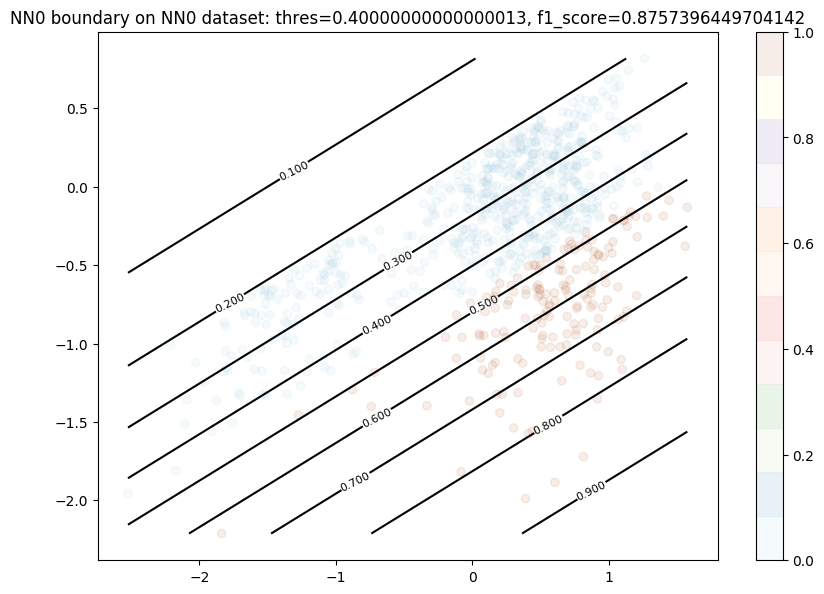

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


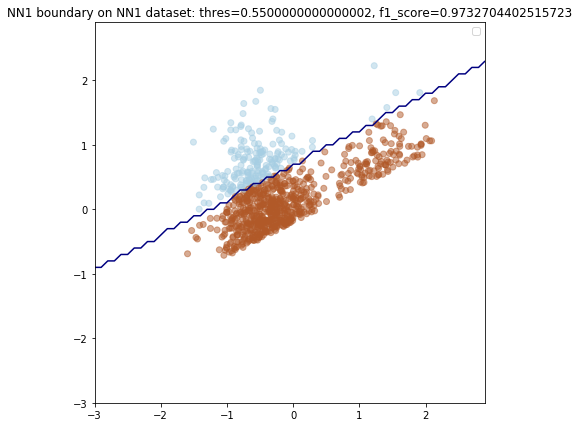

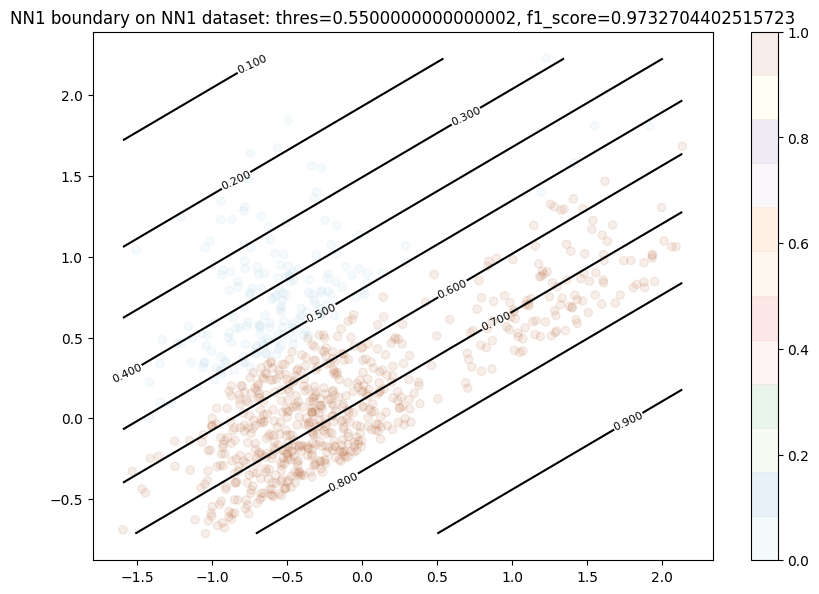

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


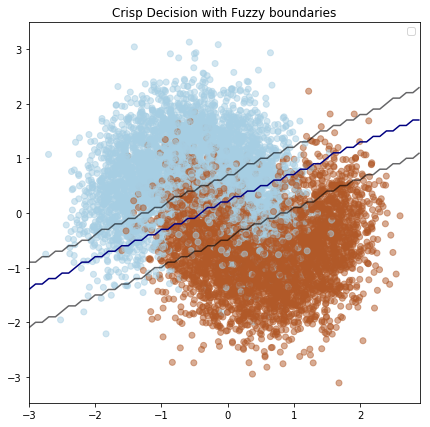

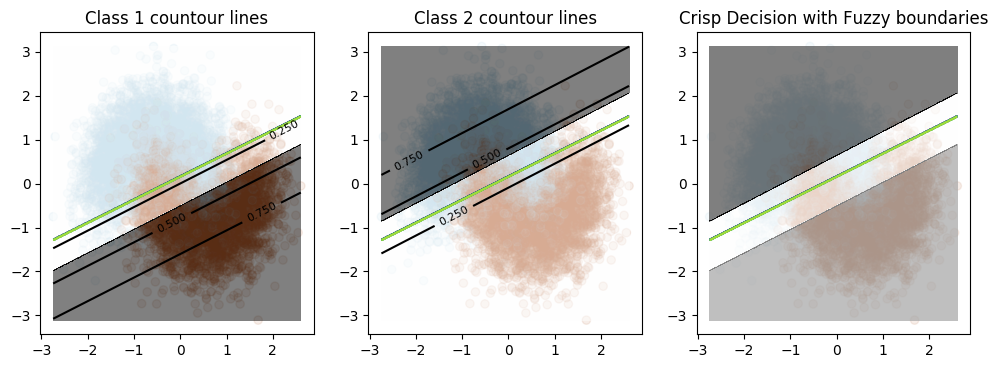

(100,)
(100,)


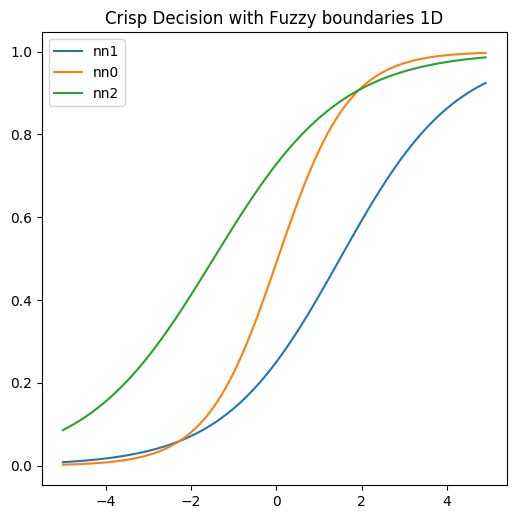

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 200,
    "epochs": 20,
    "num_classes": 2,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [mae, mape],
    "get_model_method": make_binary_model,
    "last_activation": "softmax",
    "is_classification": True
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Linear classifier with sigmoid',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.4,
      'right_proba': 0.6
  }
  
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_3 - NN Class: 
- **NN** model in TF  
- **Softmax, linear, linear** activation on the end
- **MAE** loss


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


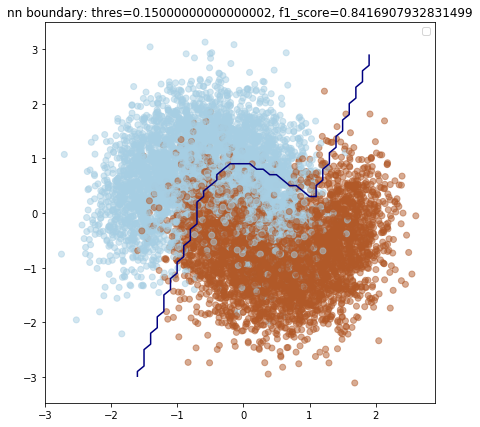

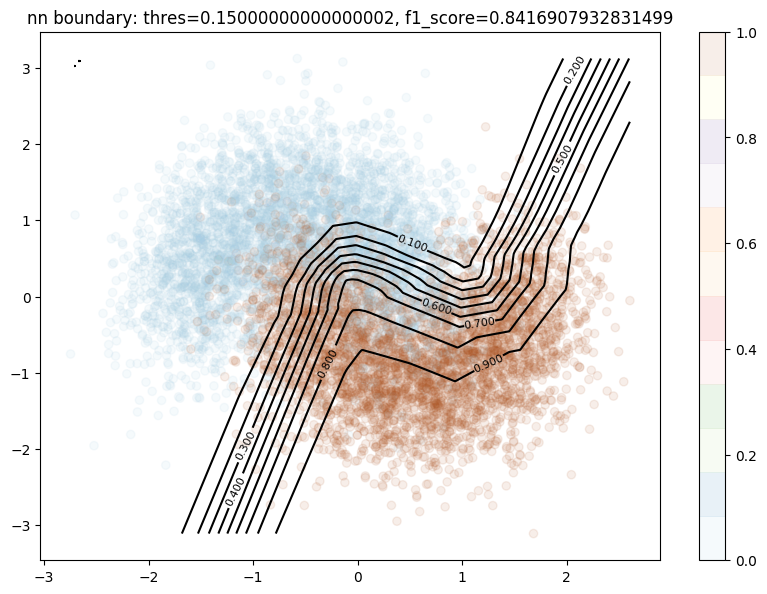


NN acc = 0.836, f1 = 0.8562664329535494


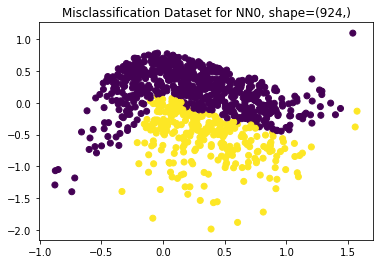

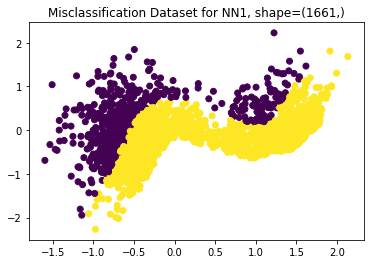

Exception ignored in: <bound method BaseSession._Callable.__del__ of <tensorflow.python.client.session.BaseSession._Callable object at 0x7f3fce754f60>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/tensorflow/python/client/session.py", line 1455, in __del__
    self._session._session, self._handle, status)
  File "/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/errors_impl.py", line 528, in __exit__
    c_api.TF_GetCode(self.status.status))
tensorflow.python.framework.errors_impl.CancelledError: Session has been closed.
Exception ignored in: <bound method BaseSession._Callable.__del__ of <tensorflow.python.client.session.BaseSession._Callable object at 0x7f3fc9eb4748>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/tensorflow/python/client/session.py", line 1455, in __del__
    self._session._session, self._handle, status)
  File "/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/

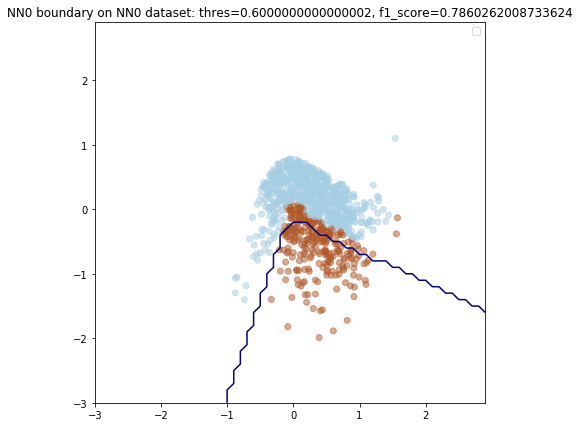

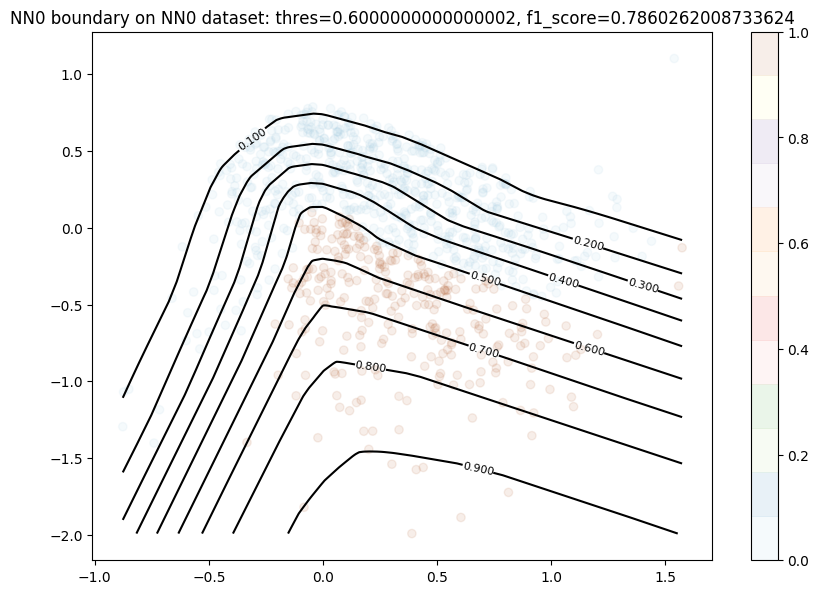

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


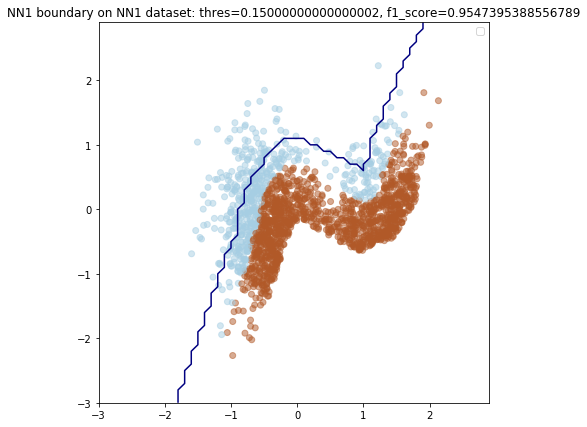

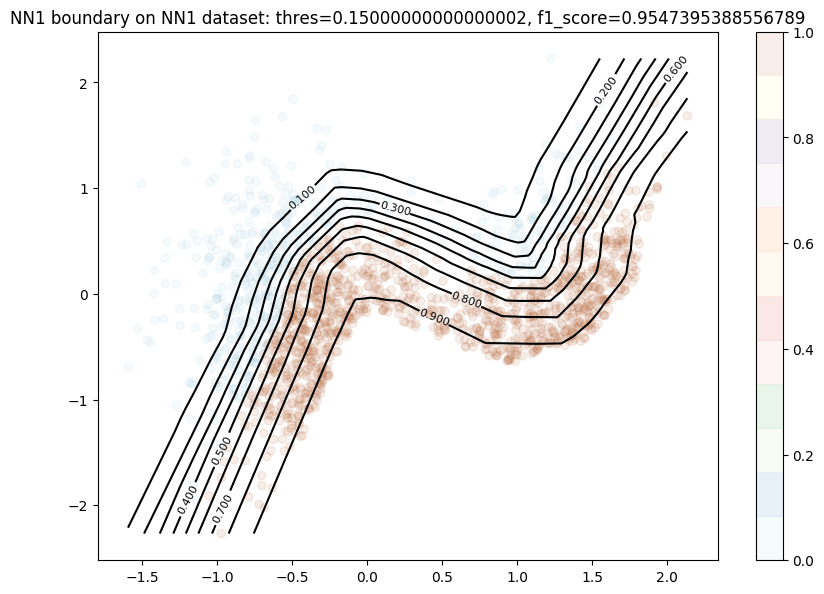

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


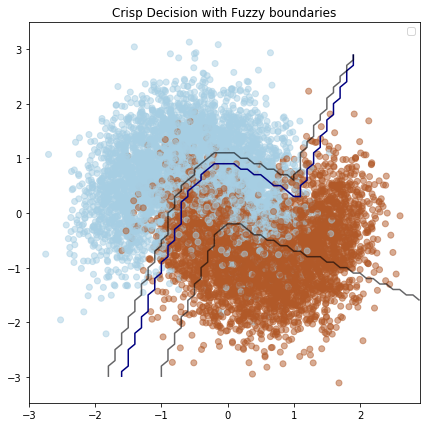

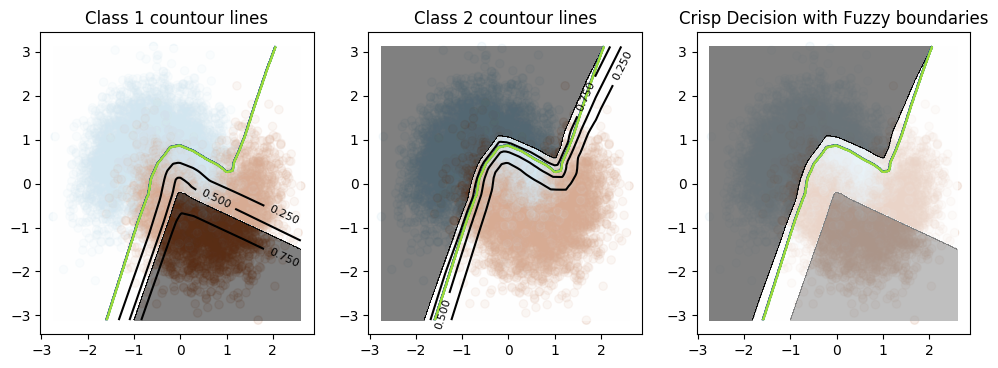

(100,)
(100,)


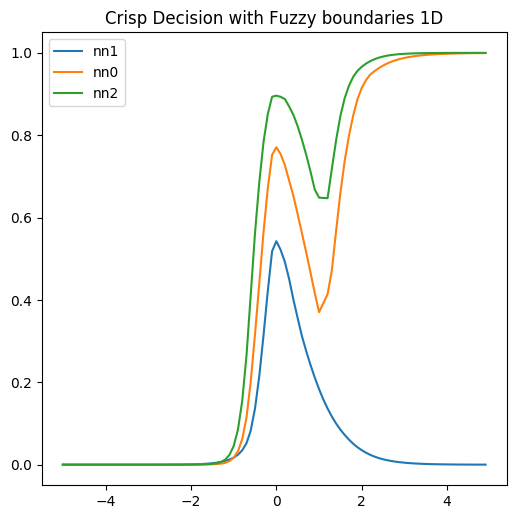

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 512,
    "steps_per_epoch": 2000,
    "epochs": 150,
    "num_classes": 2,
    "last_finished_epoch": 0,
    "dense_layers": [32, 96, 32],
    "dense_dropout": None,
    "activation": ["relu", "relu", "relu"],
    "kernel_init": ['normal', 'normal', 'normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "softmax",
    "is_classification": True
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 256,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [32, 64],
    "dense_dropout": None,
    "activation": ["relu", "relu"],
    "kernel_init": ['normal', 'normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 256,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [32, 64],
    "dense_dropout": None,
    "activation": ["relu", "relu"],
    "kernel_init": ['normal', 'normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Neuro_lin_exp_decomp',
      'lmbd': -0.65, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.2,
      'right_proba': 0.8
  }

dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_4 - RF Class: 
- **RF** classification + regression
- **Gini, MSE, MSE** loss
- Make Classification


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


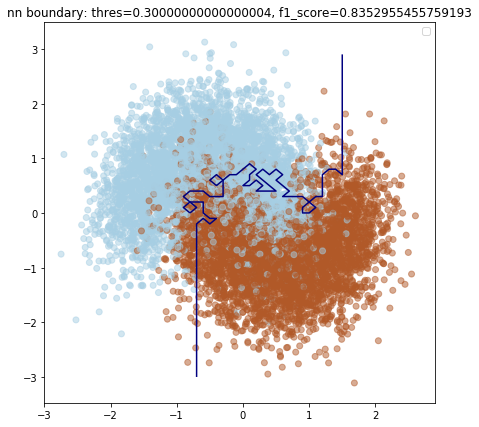

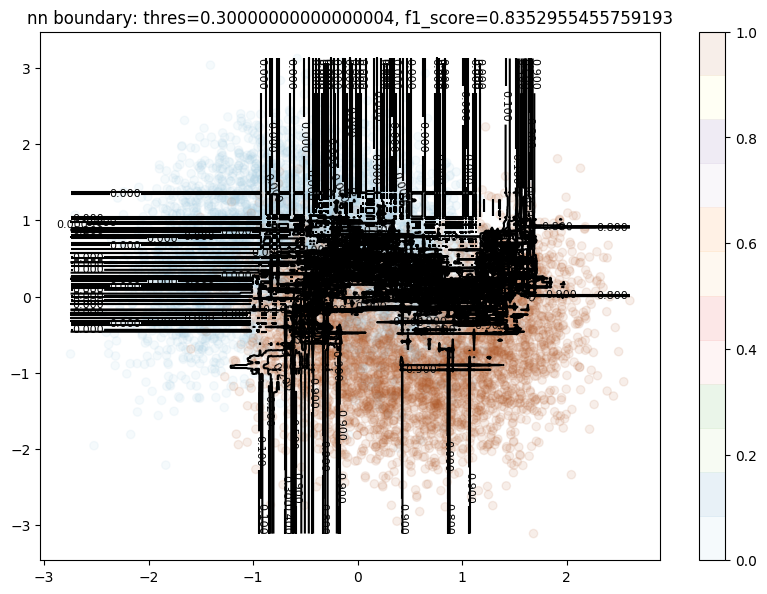

[0.002 0.    0.74  ... 0.044 0.072 1.   ]
[1 0 0 ... 0 1 1]

NN acc = 0.8605, f1 = 0.8683341198678622


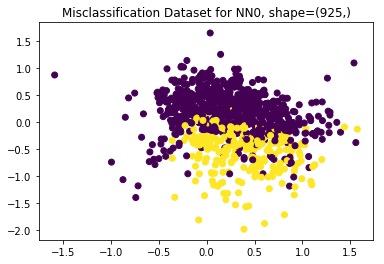

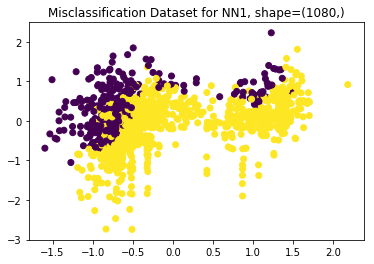

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


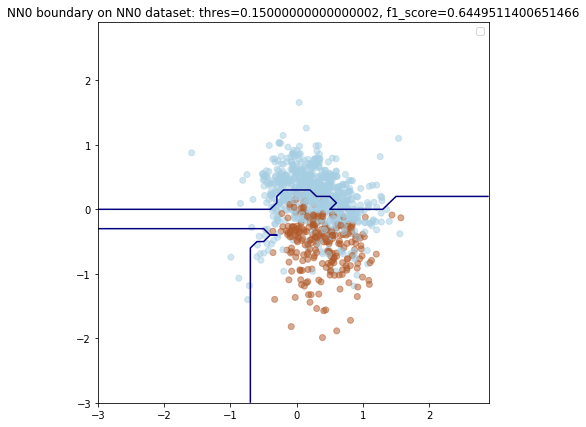

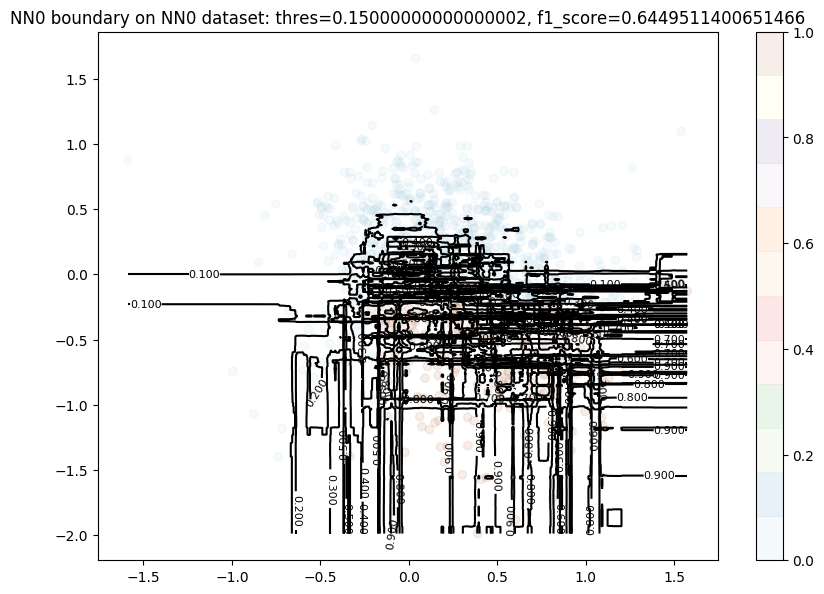

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


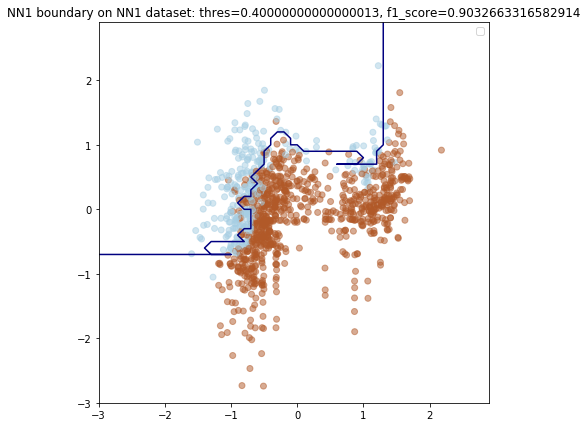

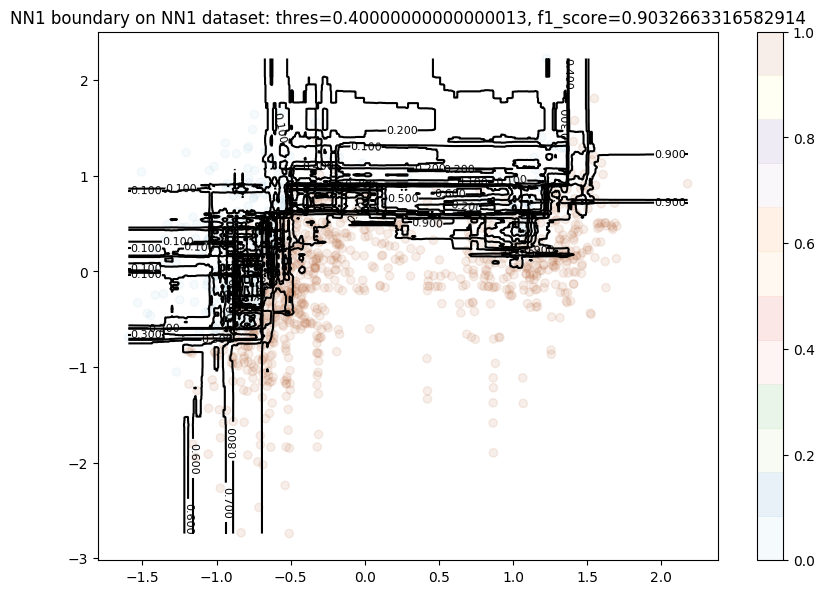

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


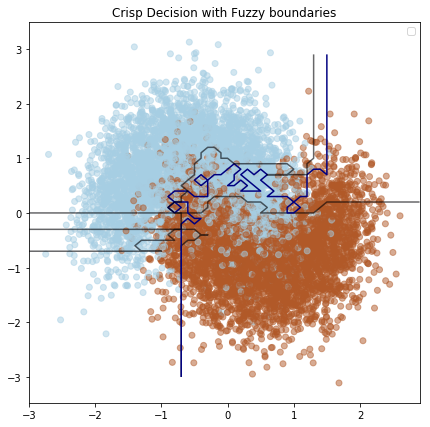

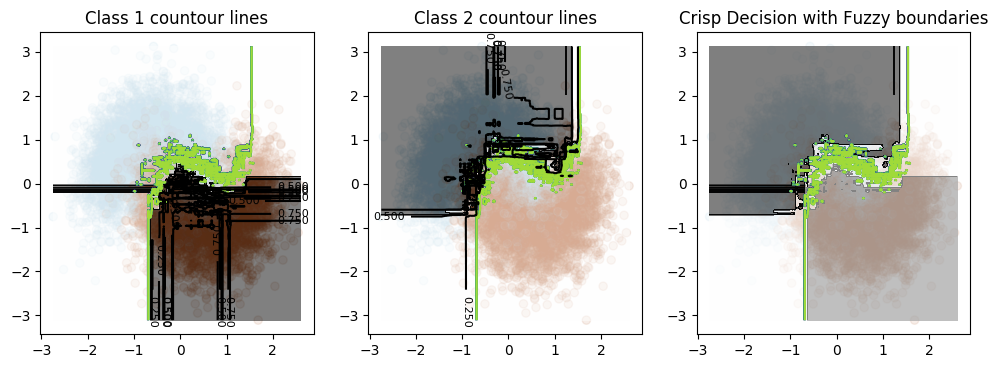

(100,)
(100,)


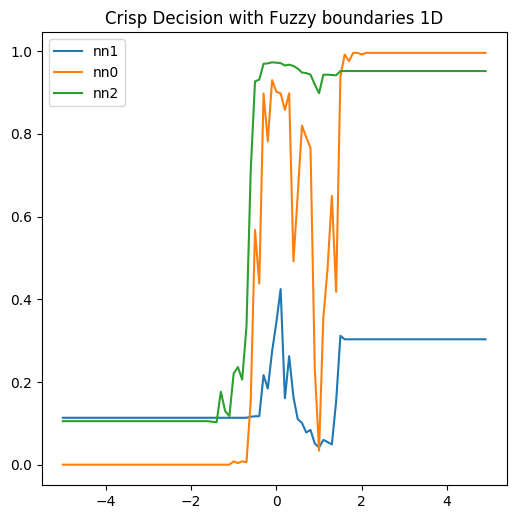

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  rf0_config = {
    "name": "rf0",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 5
  }
  
  rf1_config = {
    "name": "rf1",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 4
  }
  
  rf2_config = {
    "name": "rf2",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 4
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'RF_class',
      'lmbd': -0.95, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.2,
      'right_proba': 0.8
  }
  
  
  
ml_experiment(rf0_config, rf1_config, rf2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_5 - - LGBM Non Monotone: 
- **Gradient boosting** model (**No monotonic constraint**)
- **MAE** loss


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=6,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=500,
        n_jobs=-1, num_leaves=31, num_threads=4, objective='binary',
        random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
        subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
        verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


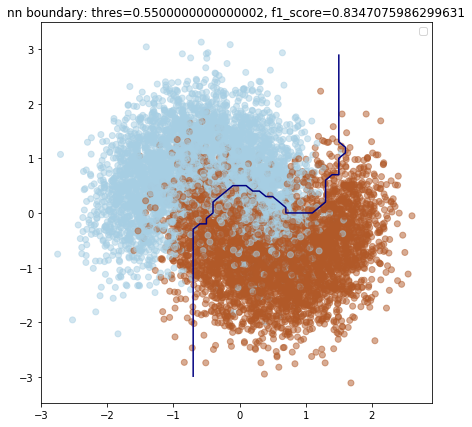

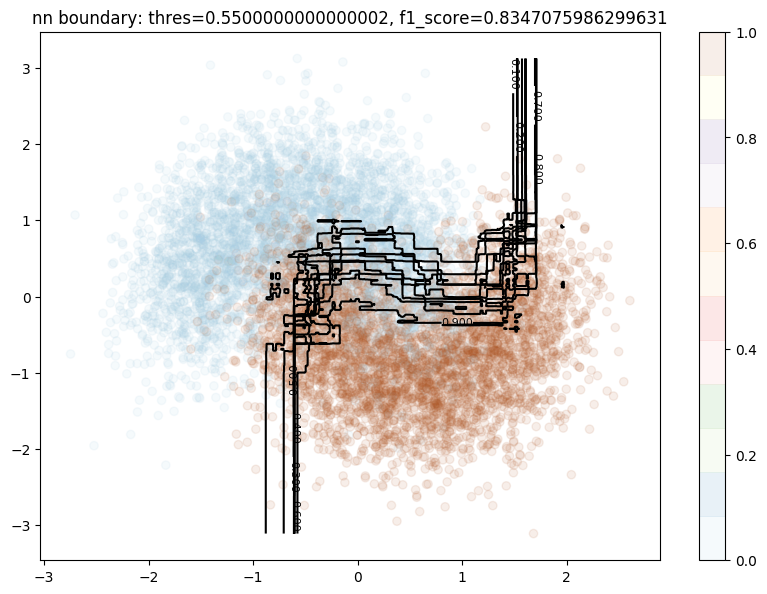

[0.02238656 0.00463737 0.90202008 ... 0.00386801 0.00647039 0.99160082]
[1 0 0 ... 0 1 1]

NN acc = 0.874, f1 = 0.8716904276985744


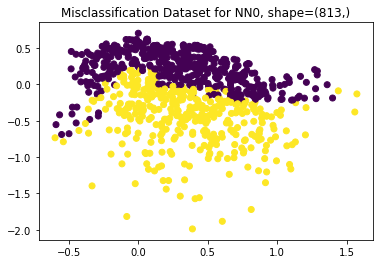

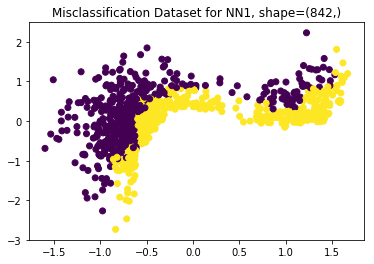

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


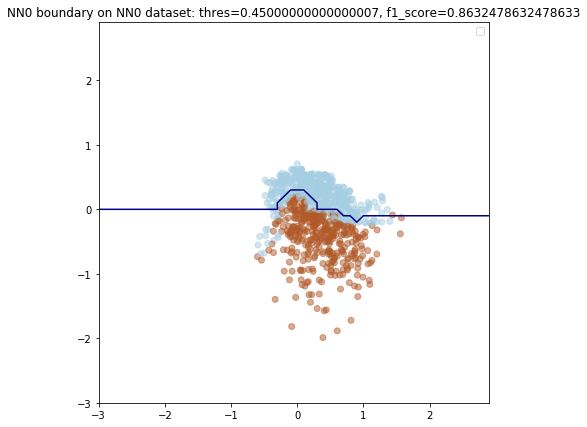

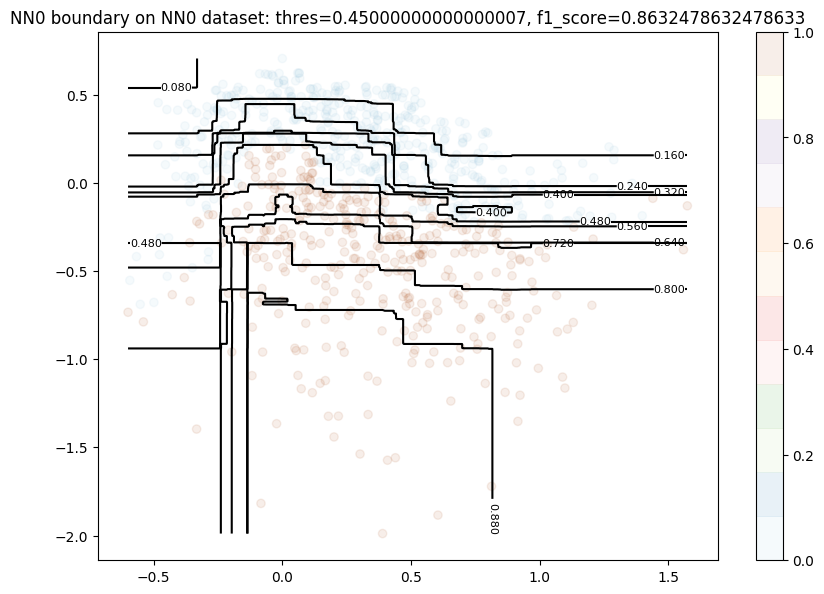

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


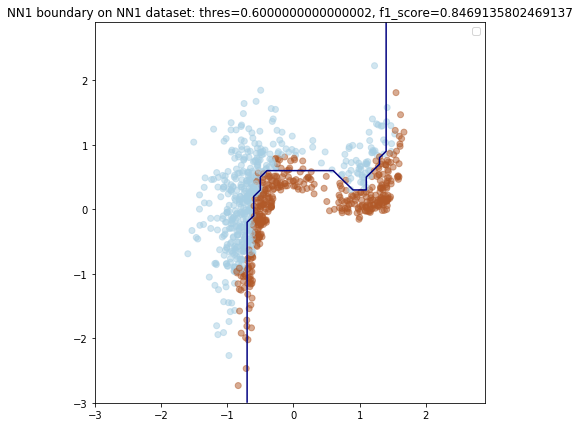

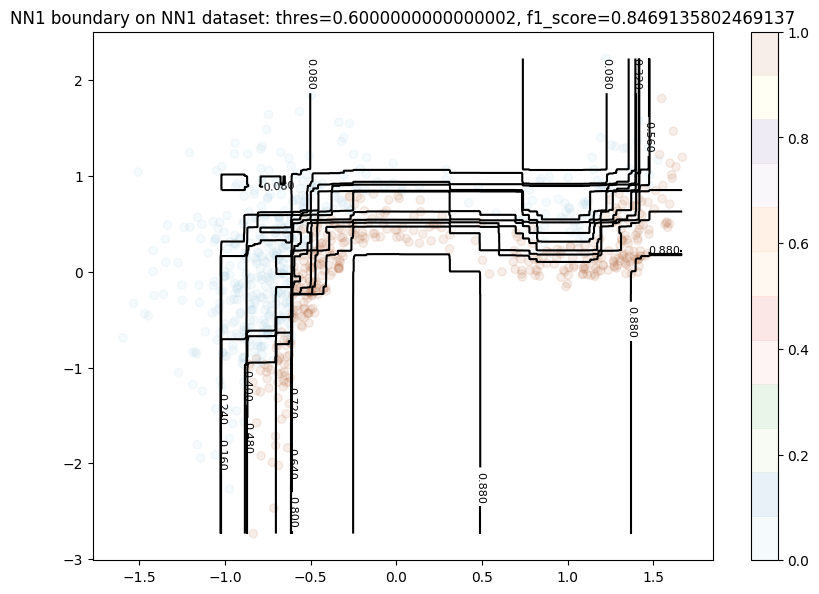

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


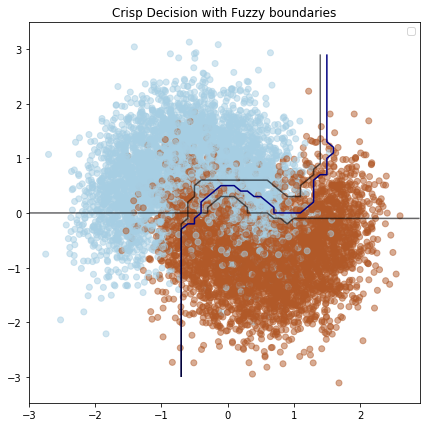

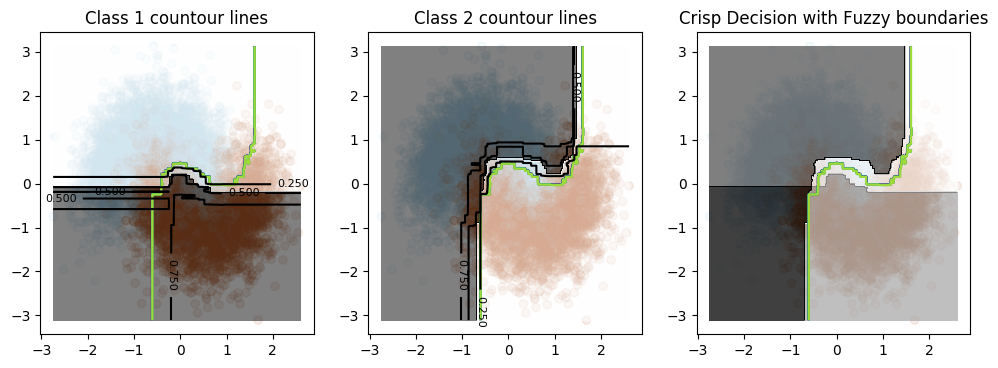

(100,)
(100,)


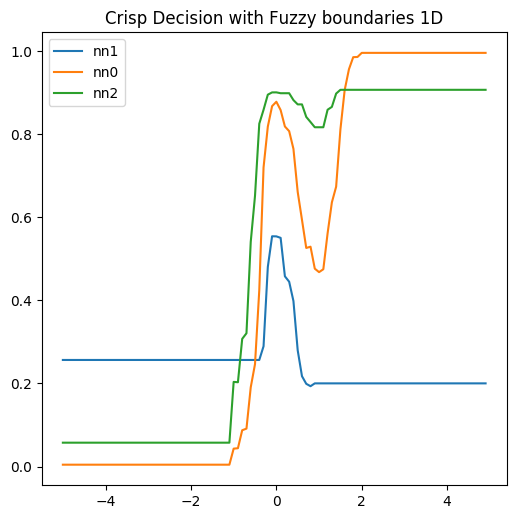

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }
  
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])
  


### Experiment_6 - LGBM Monotone: 
- **Gradient boosting** model (**With Monotonic constraint**)
- **MAE** loss


In [0]:
if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,1)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,1)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }
  
  
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

## Make circles

In [0]:
X, y = make_circles(n_samples=10000, random_state=SEED, factor=0.7, noise=0.2)

### Experiment_1 - LinReg: 
- **Linear Regression** in TF
- **Linear** activation on the end
- **MAE** loss


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


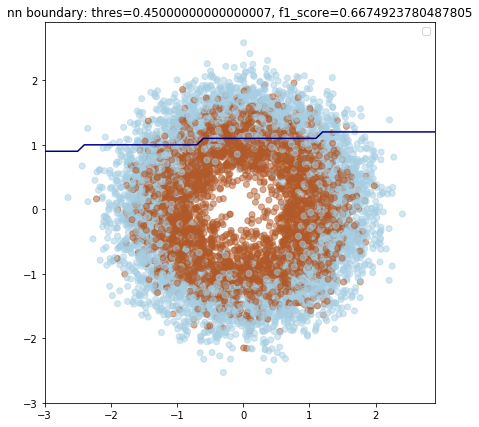

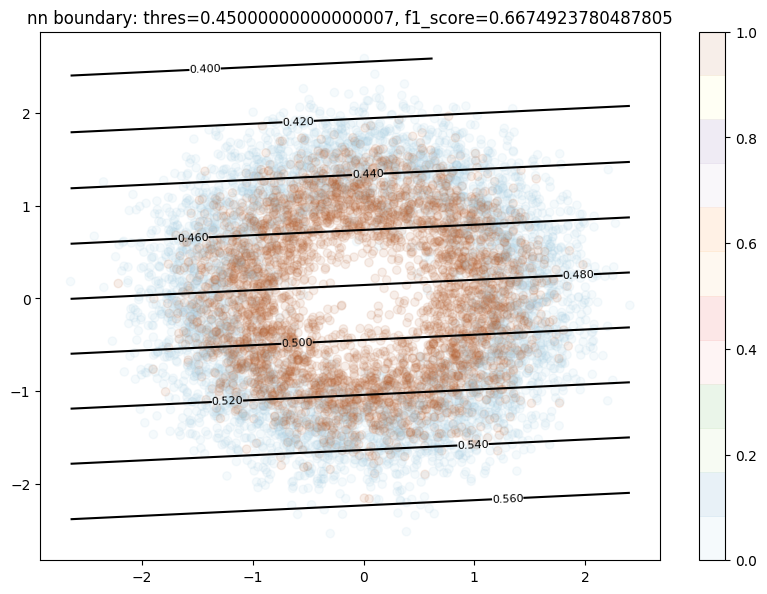


NN acc = 0.539, f1 = 0.6831615120274913


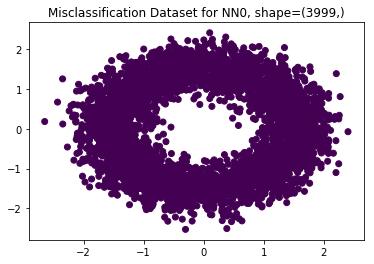

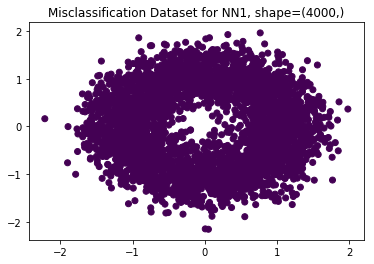

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


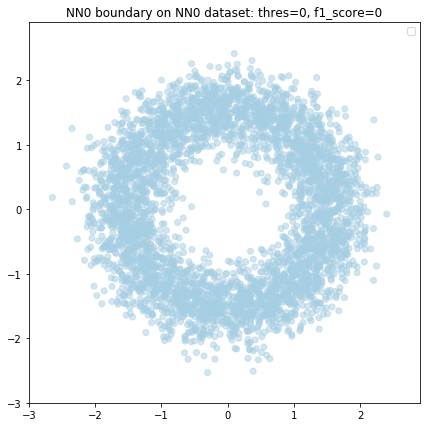

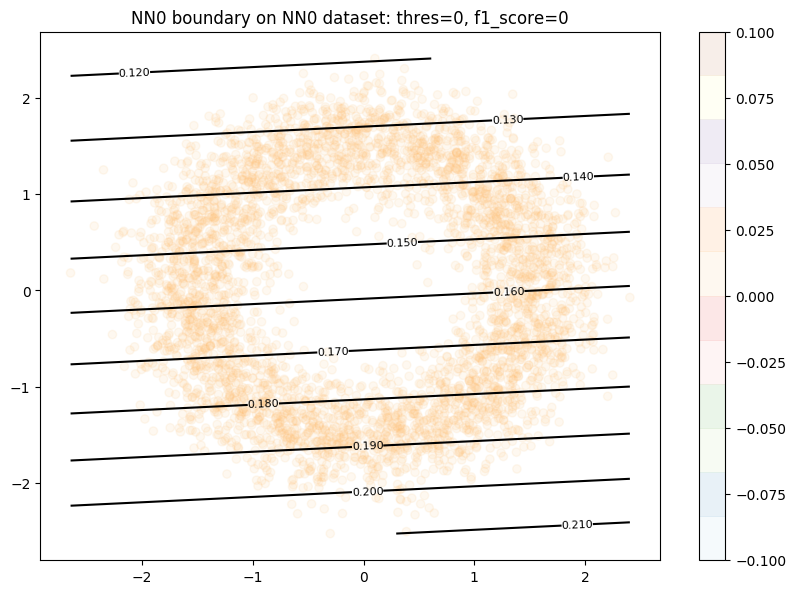

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


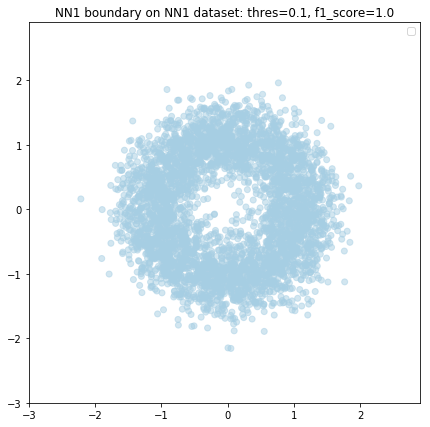

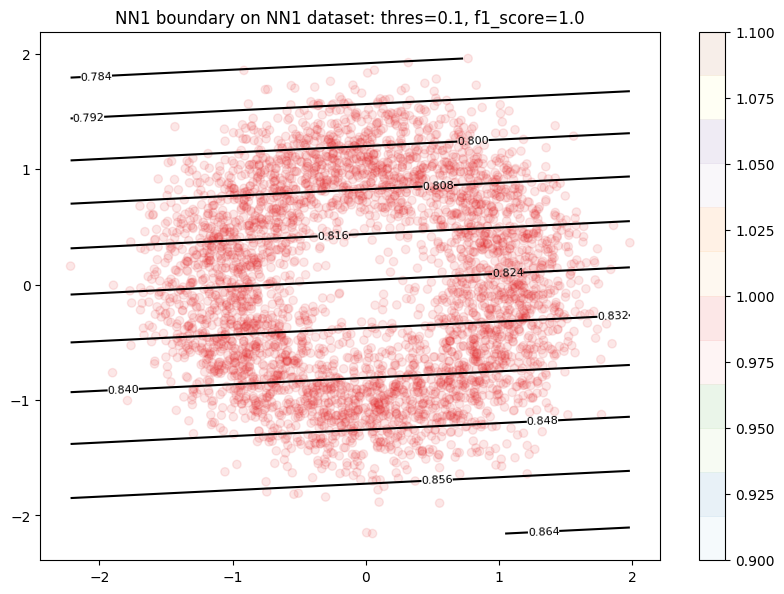

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


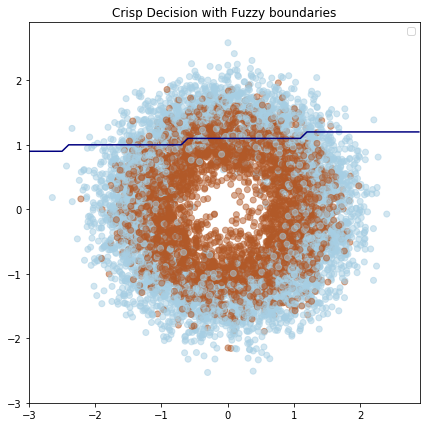

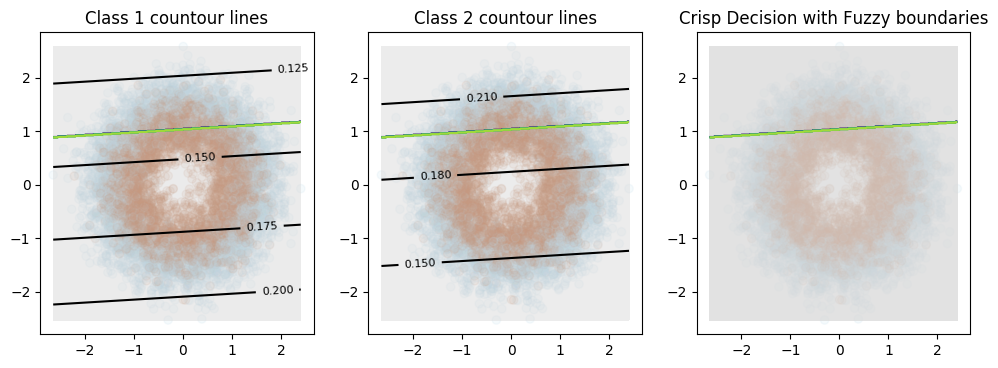

(100,)
(100,)


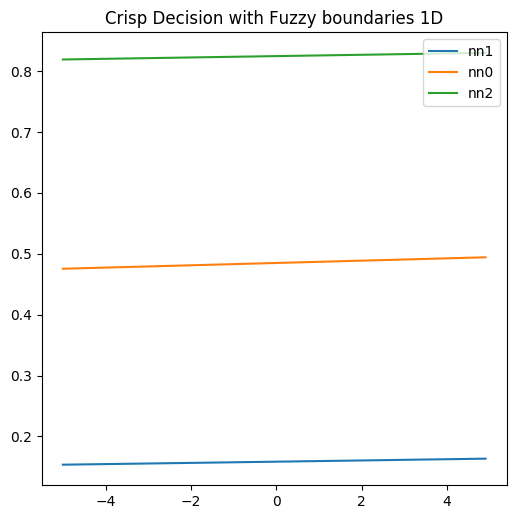

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 200,
    "epochs": 20,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Linear regression with sigmoid',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.4,
      'right_proba': 0.6
  }
  
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_2 - LinClass: 
- **Linear Classification** in TF
- **Softmax, Sigmoid, Sigmoid**  activation on the end
- **categorical_cross_entropy, MAE, MAE** loss

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


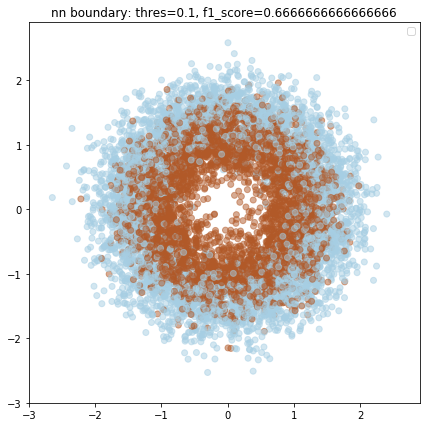

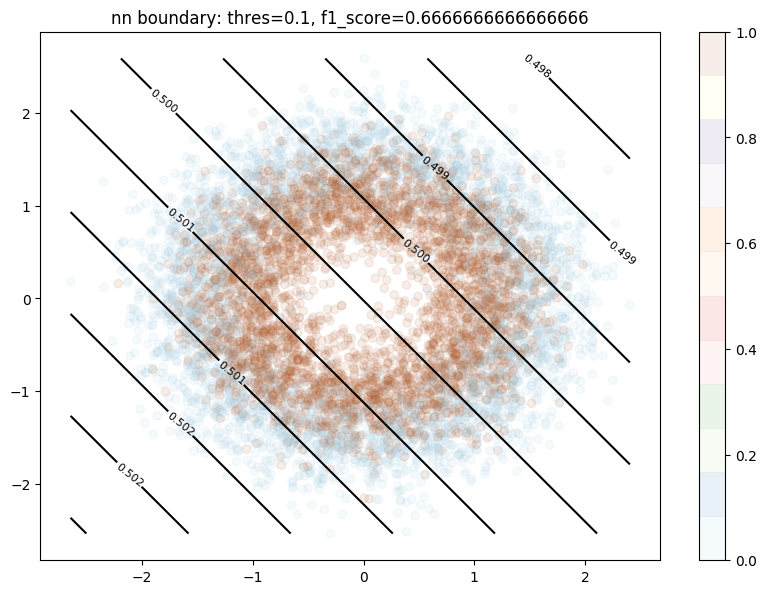


NN acc = 0.5, f1 = 0.6666666666666666


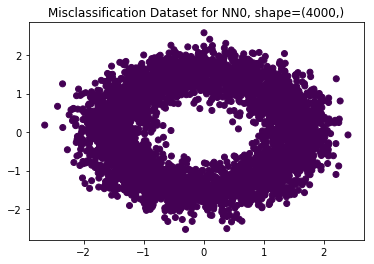

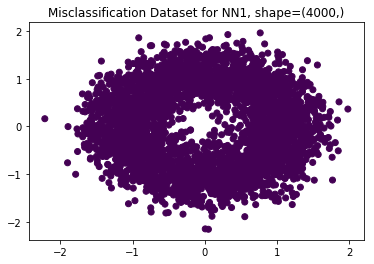

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


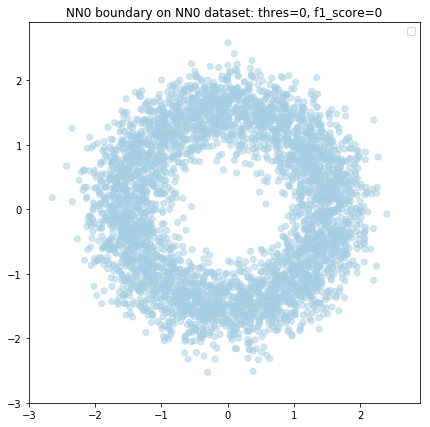

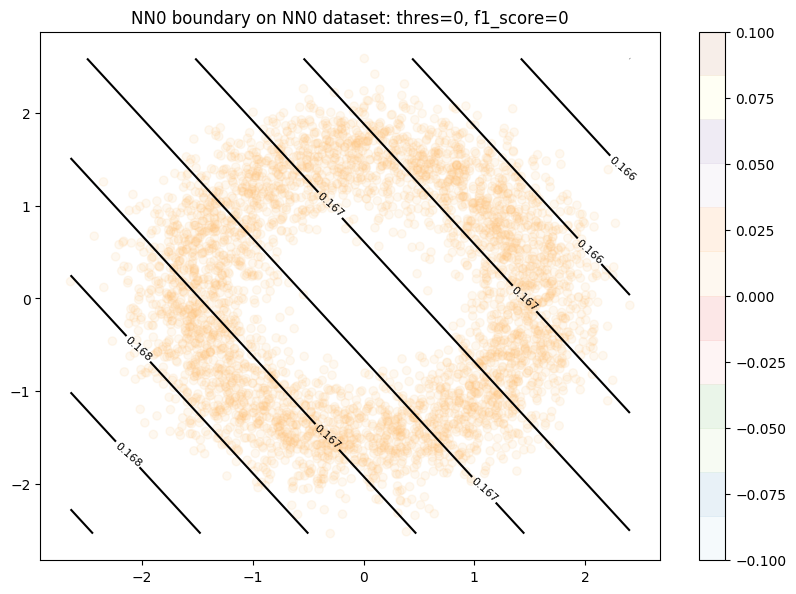

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


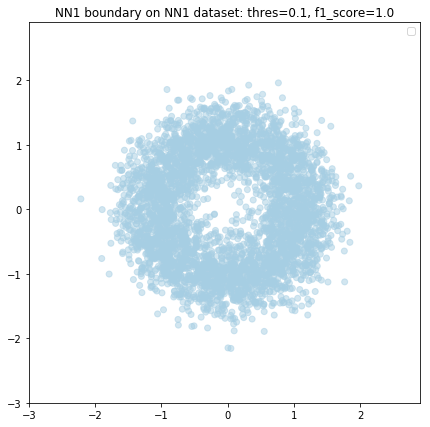

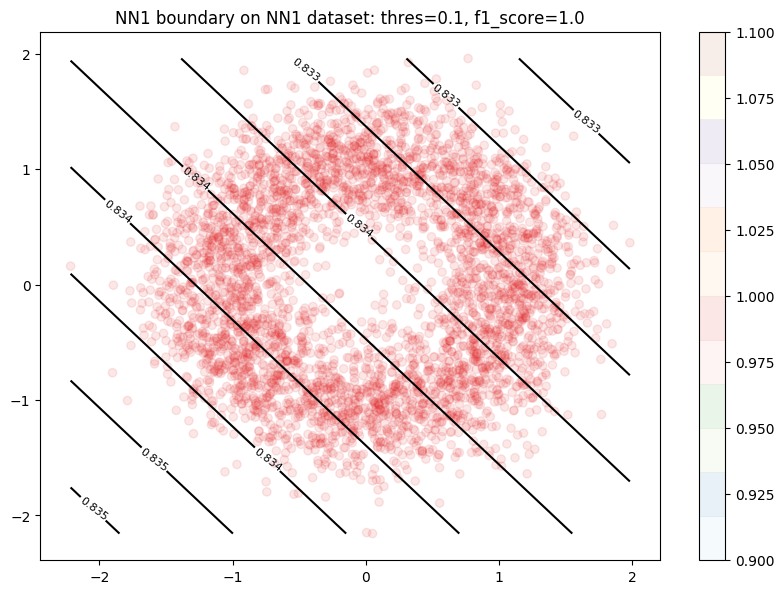

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


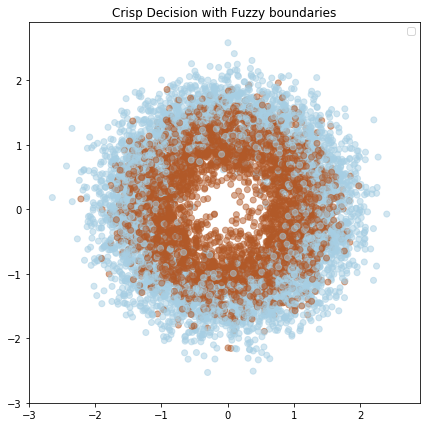

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


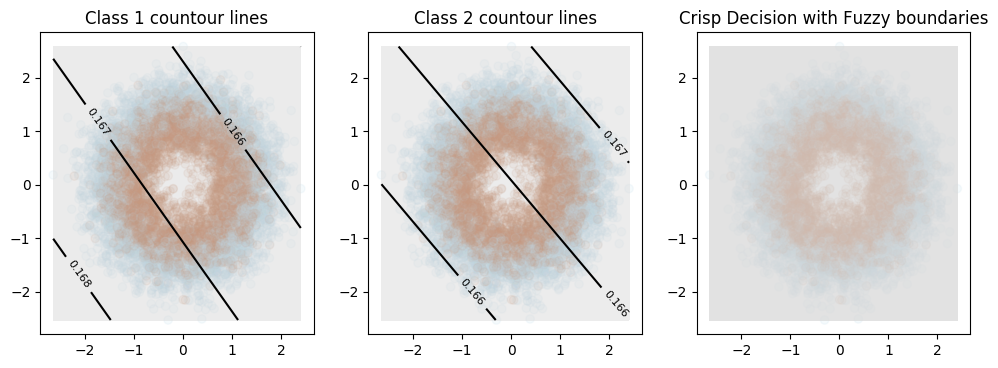

(100,)
(100,)


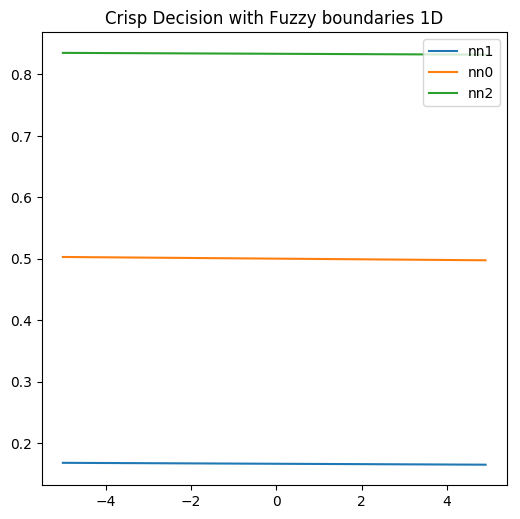

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 200,
    "epochs": 20,
    "num_classes": 2,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [mae, mape],
    "get_model_method": make_binary_model,
    "last_activation": "softmax",
    "is_classification": True
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 128,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [0],
    "dense_dropout": None,
    "activation": ["sigmoid"],
    "kernel_init": ['normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "sigmoid",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Linear classifier with sigmoid',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.4,
      'right_proba': 0.6
  }
  
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_3 - NN Class: 
- **NN** model in TF  
- **Softmax, linear, linear** activation on the end
- **MAE** loss


Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


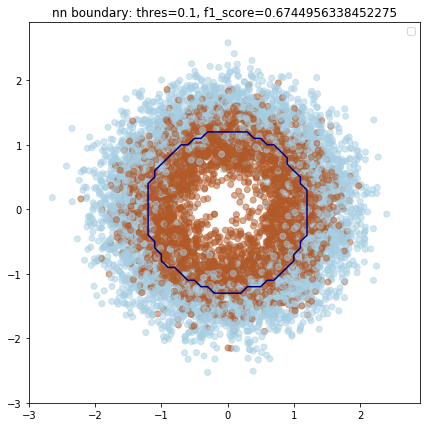

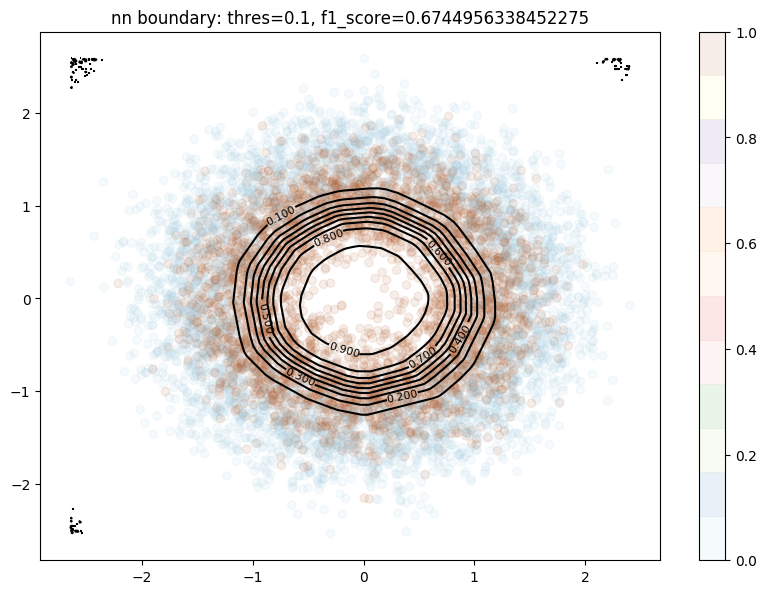


NN acc = 0.605, f1 = 0.7145953757225433


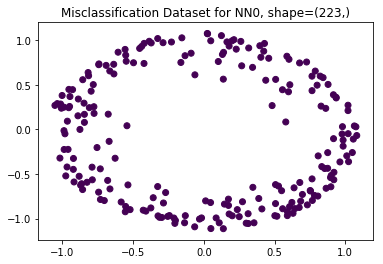

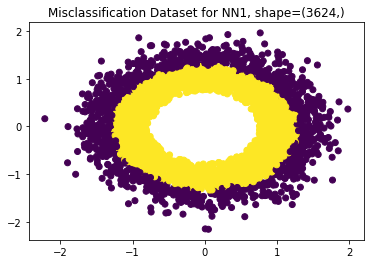

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


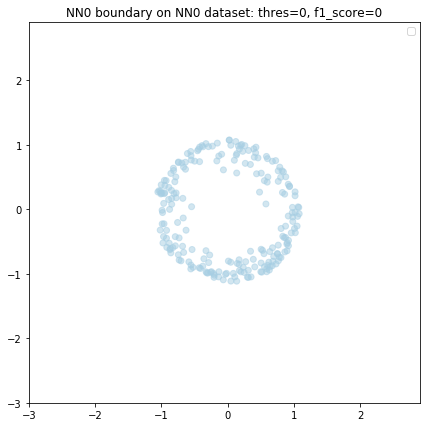

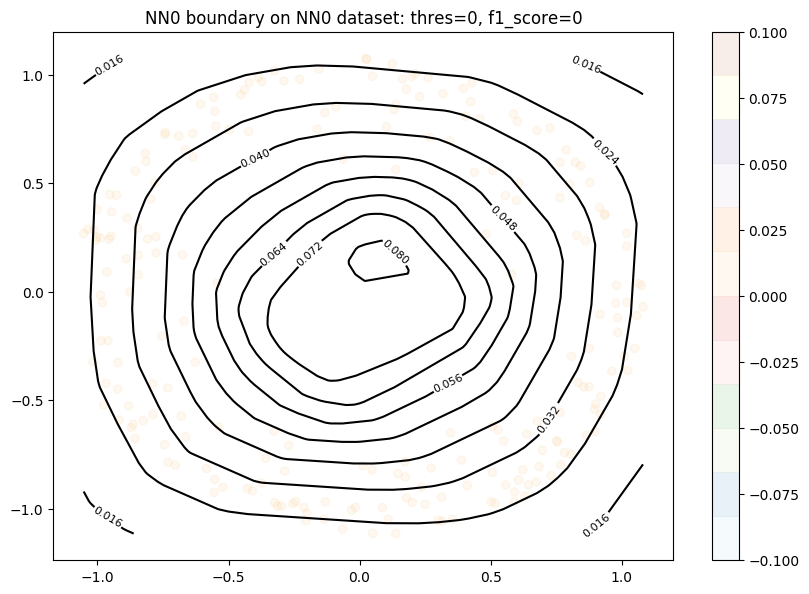

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


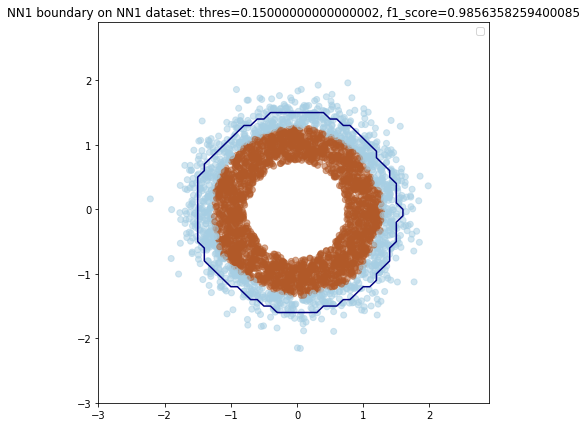

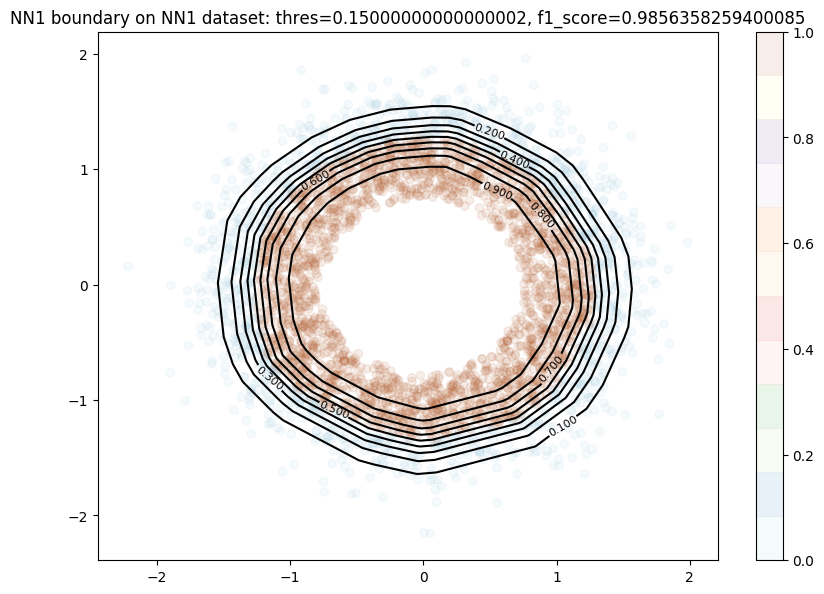

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


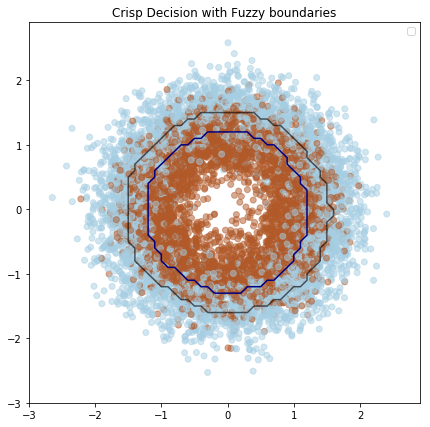

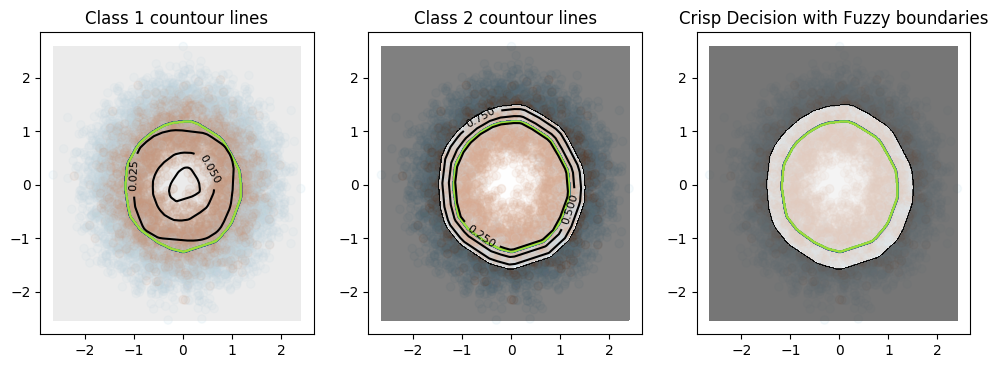

(100,)
(100,)


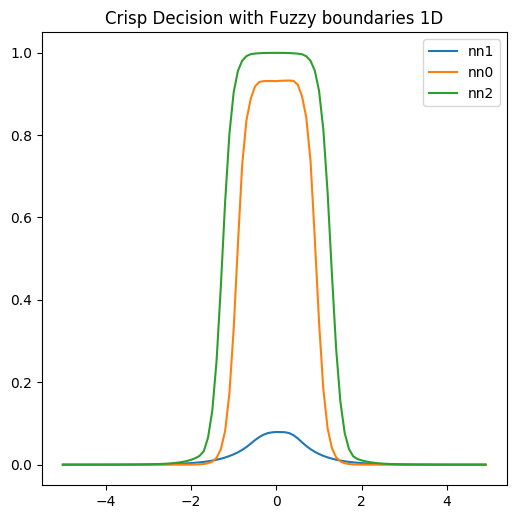

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  nn_config = {
    "name": "nn_mlp",
    "input_dim": 2,
    "batch_size": 512,
    "steps_per_epoch": 2000,
    "epochs": 150,
    "num_classes": 2,
    "last_finished_epoch": 0,
    "dense_layers": [32, 96, 32],
    "dense_dropout": None,
    "activation": ["relu", "relu", "relu"],
    "kernel_init": ['normal', 'normal', 'normal'],
    "verbose": False,
    "reset_session": True,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_binary_model,
    "last_activation": "softmax",
    "is_classification": True
  }
  
  nn0_config = {
    "name": "nn0_mlp",
    "input_dim": 2,
    "batch_size": 256,
    "steps_per_epoch": 50,
    "epochs": 150,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [32, 32],
    "dense_dropout": None,
    "activation": ["relu", "relu"],
    "kernel_init": ['normal', 'normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  nn1_config = {
    "name": "nn1_mlp",
    "input_dim": 2,
    "batch_size": 256,
    "steps_per_epoch": 50,
    "epochs": 100,
    "num_classes": 1,
    "last_finished_epoch": 0,
    "dense_layers": [32, 32],
    "dense_dropout": None,
    "activation": ["relu", "relu"],
    "kernel_init": ['normal', 'normal'],
    "verbose":  False,
    "reset_session": False,
    "scaler": StandardScaler(),
    "loss": 'mean_absolute_error',
    "metrics": [mae, mape],
    'get_model_method': make_binary_model,
    "last_activation": "linear",
    "is_classification": False
  }
  
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'Neuro_lin_exp_decomp',
      'lmbd': -0.95, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.2,
      'right_proba': 0.8
  }
  
  
dl_experiment(nn_config, nn0_config, nn1_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_4 - RF Class: 
- **RF** classification + regression
- **Gini, MSE, MSE** loss
- Make Classification


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


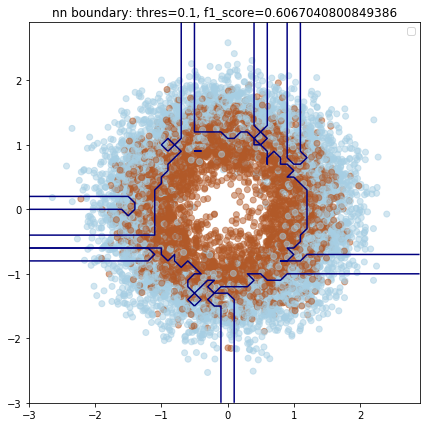

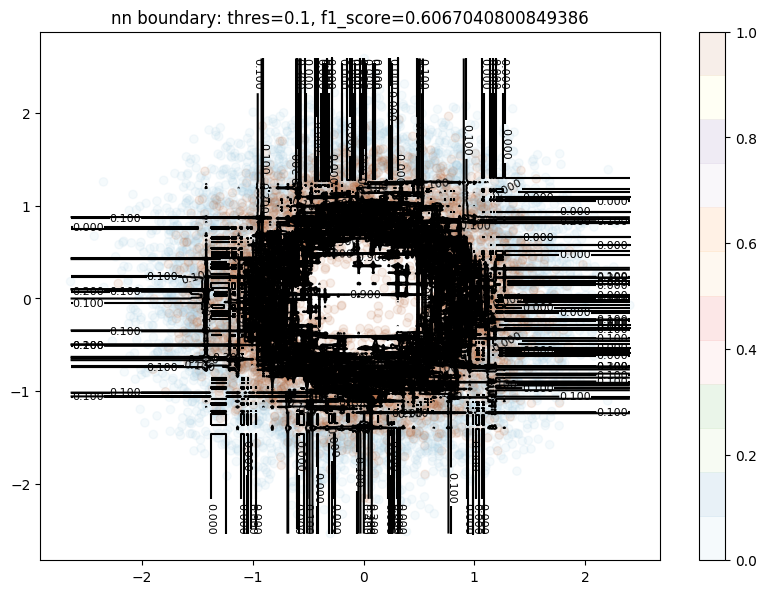

[0.136 0.022 0.704 ... 0.002 0.004 0.004]
[1 1 1 ... 1 1 1]

NN acc = 0.656, f1 = 0.7359938603223332


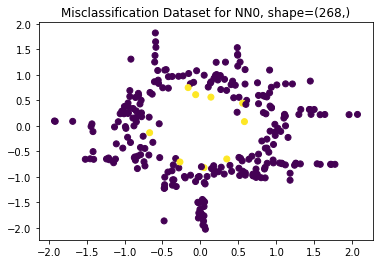

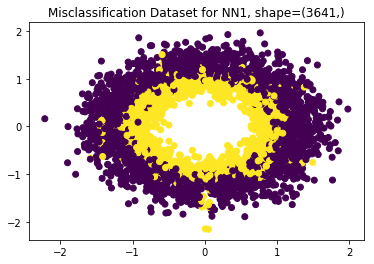

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


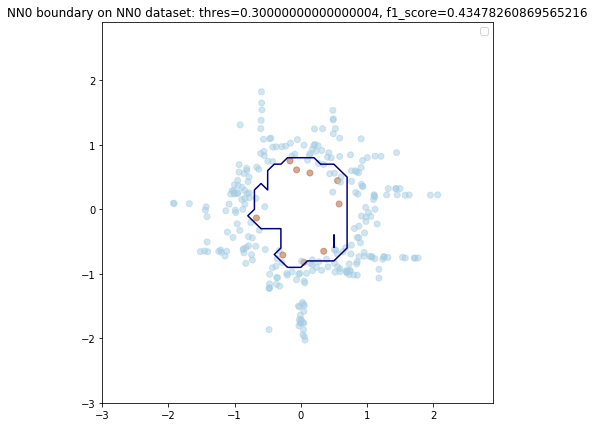

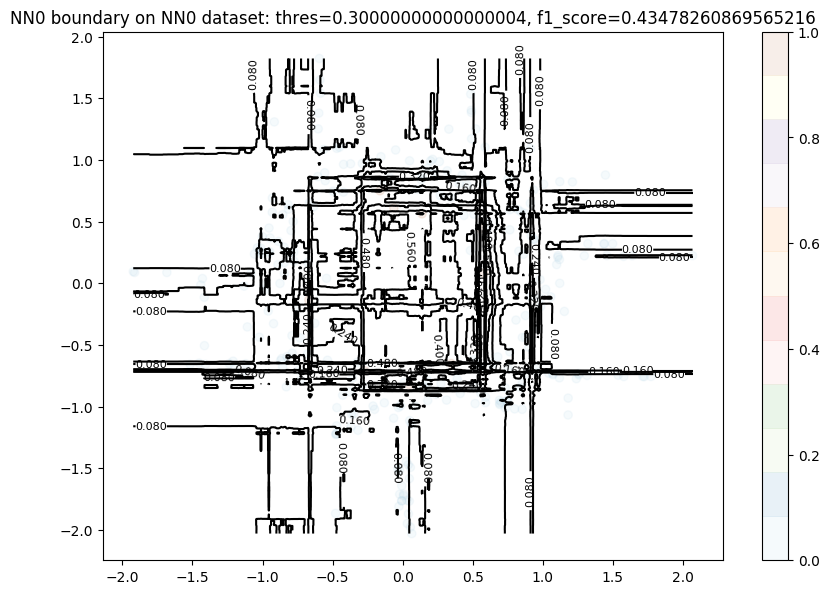

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


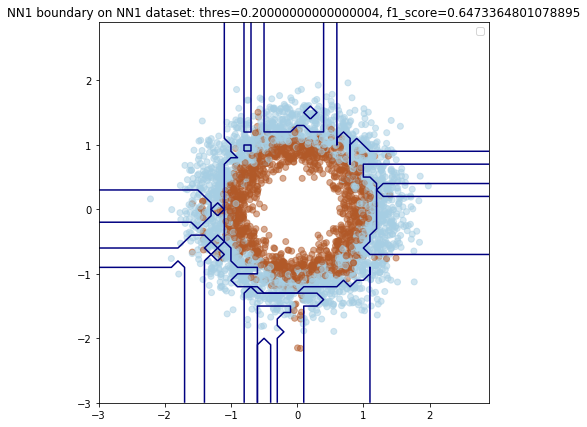

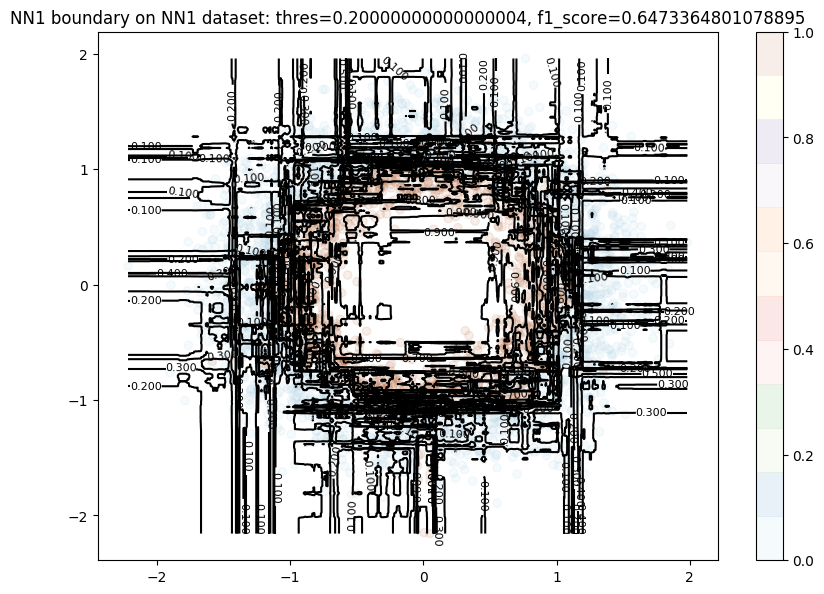

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


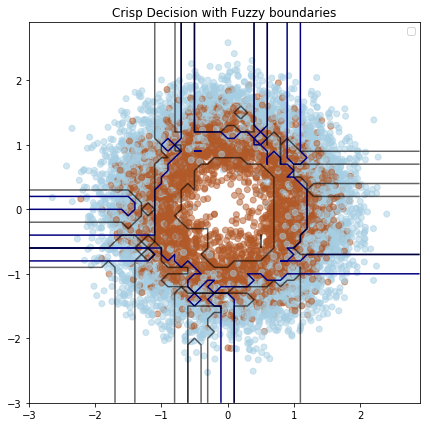

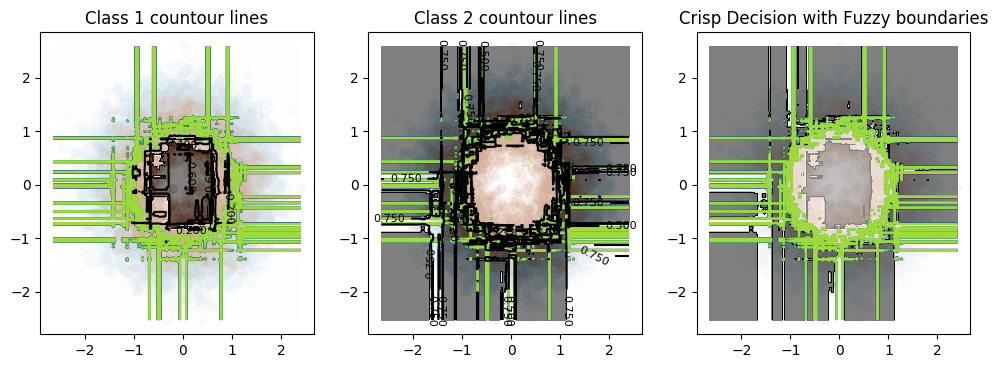

(100,)
(100,)


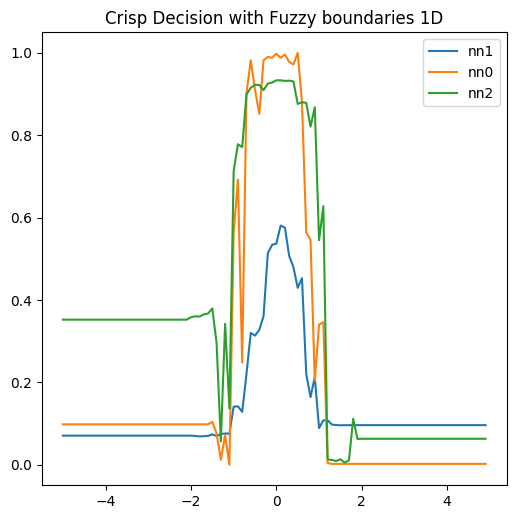

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  rf0_config = {
    "name": "rf0",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 10
  }
  
  rf1_config = {
    "name": "rf1",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 5
  }
  
  rf2_config = {
    "name": "rf2",
    "verbose": False,
    "scaler": StandardScaler(),
    "loss": 'categorical_crossentropy',
    "metrics": [binary_accuracy],
    'get_model_method': make_rf_model,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 5
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'RF_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.2,
      'right_proba': 0.8
  }
  
ml_experiment(rf0_config, rf1_config, rf2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_5 - - LGBM Non Monotone: 
- **Gradient boosting** model (**No monotonic constraint**)
- **MAE** loss


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=6,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=500,
        n_jobs=-1, num_leaves=31, num_threads=4, objective='binary',
        random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
        subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
        verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


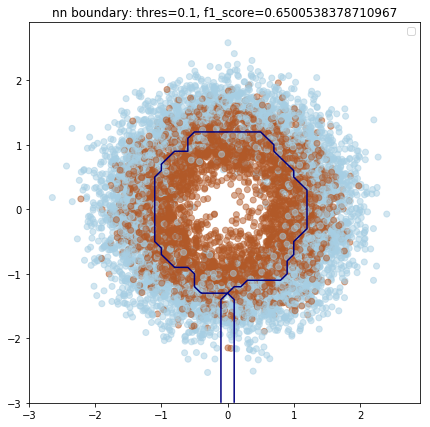

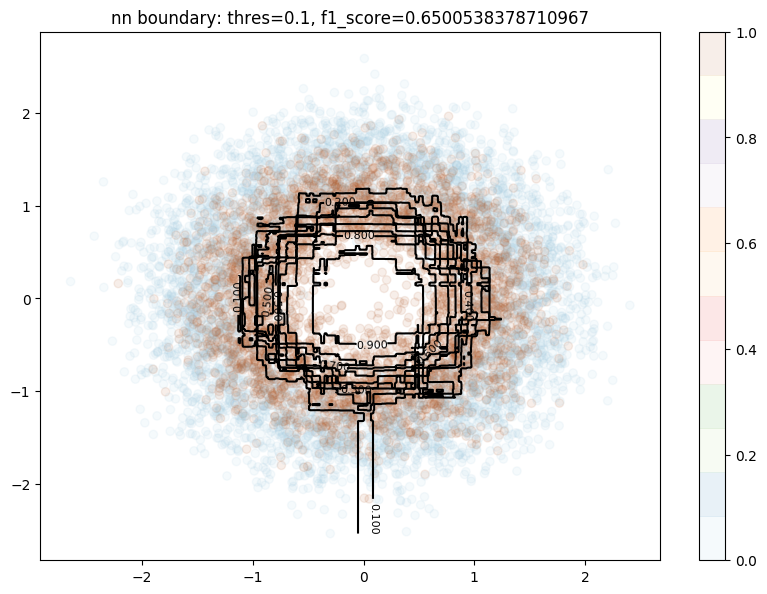

[0.01544784 0.02843137 0.45556105 ... 0.02161848 0.02565089 0.04468766]
[1 1 0 ... 1 1 1]

NN acc = 0.627, f1 = 0.7237037037037037


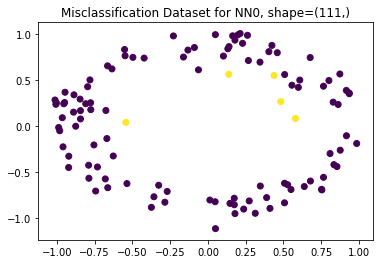

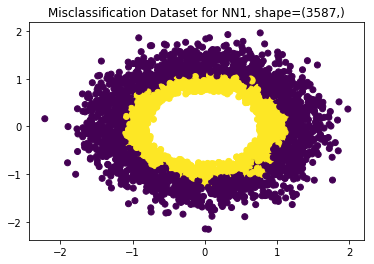

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=4,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=100,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)
LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(0, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


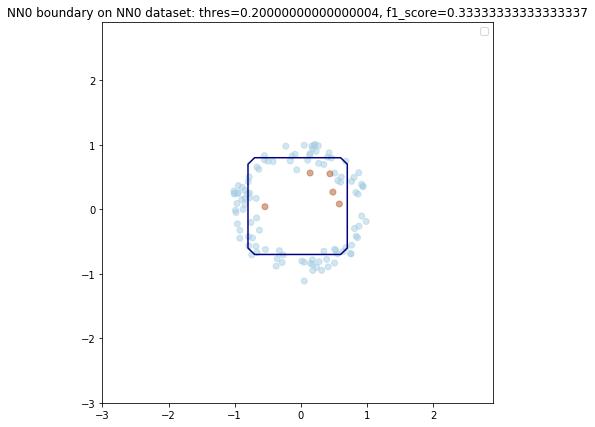

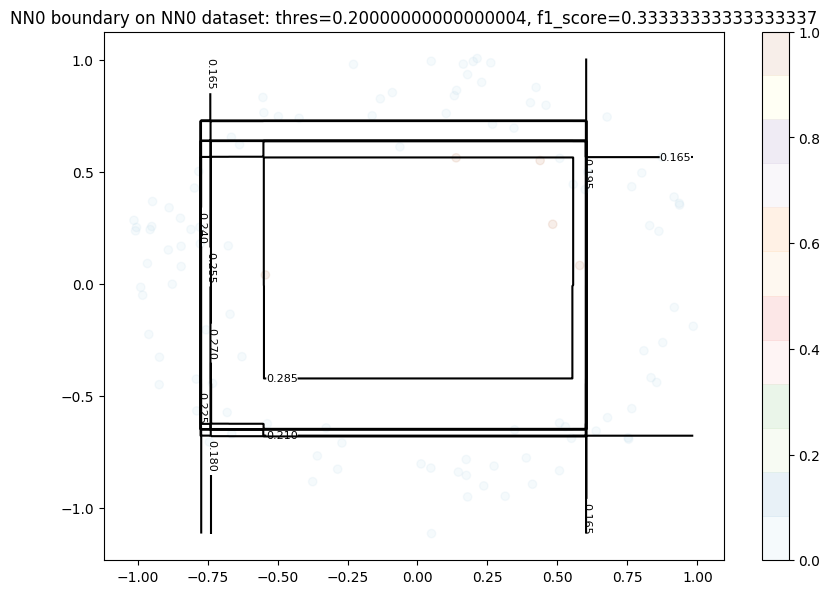

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


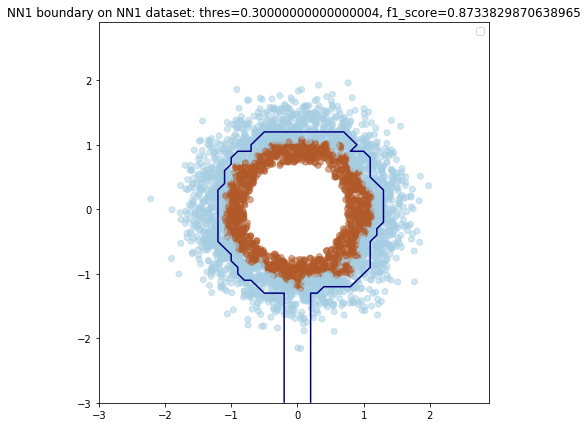

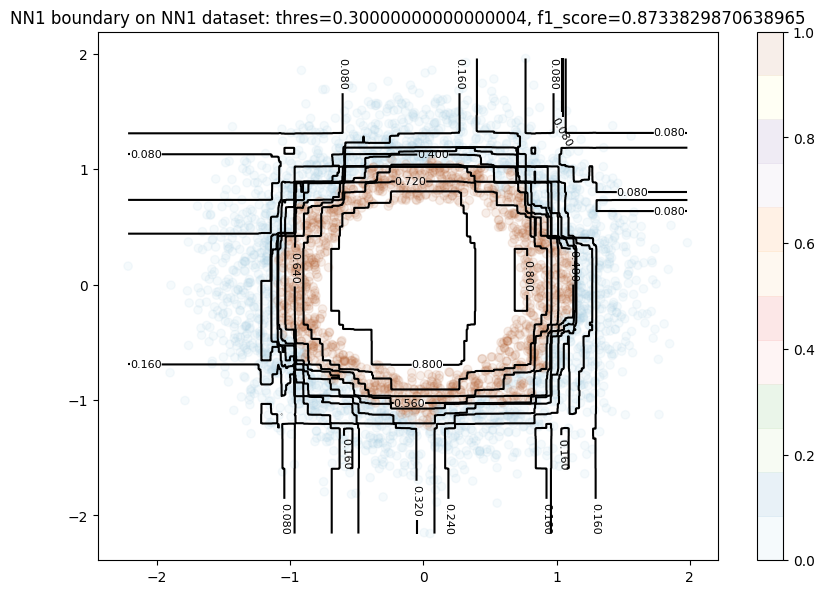

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


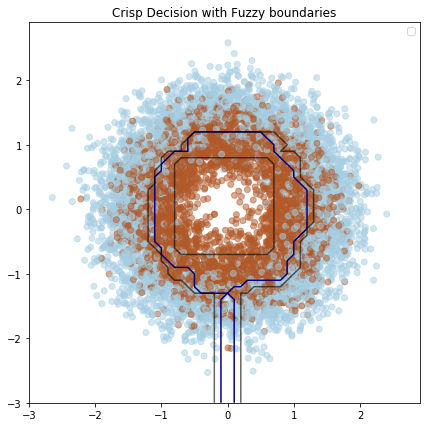

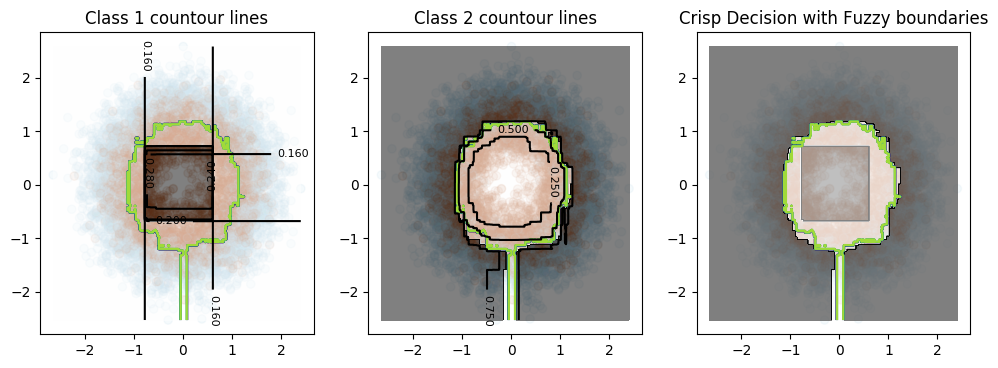

(100,)
(100,)


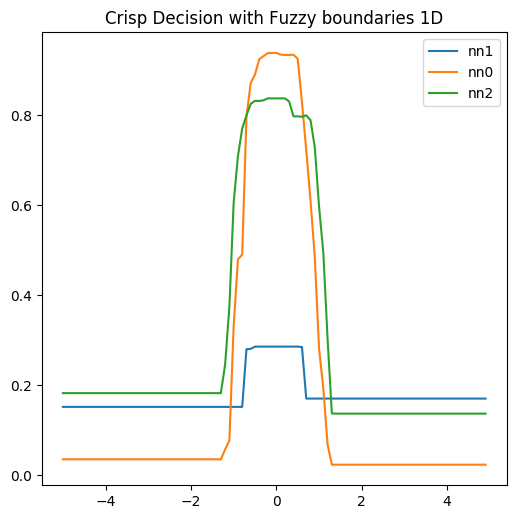

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 4,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.9, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }
  
  
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_6 - LGBM Monotone: 
- **Gradient boosting** model (**With Monotonic constraint**)
- **MAE** loss


## trash

### Experiment_1: 
- **Gradient boosting** model (**No monotonic constraint**)
- **MAE** loss
- Make Classification


In [0]:
# X, y = make_circles(n_samples=10000, random_state=SEED, factor=0.7, noise=0.25)
X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)

if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 100,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 4,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.5, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=5,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
        num_threads=4, objective='binary', random_state=None,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=0, verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


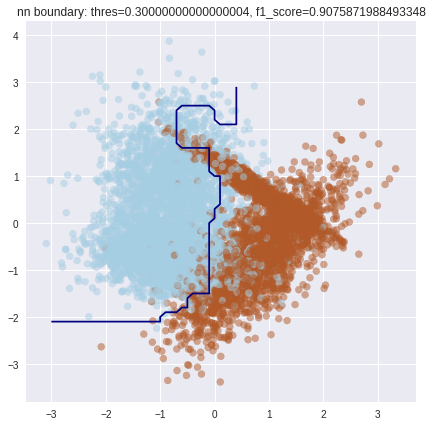

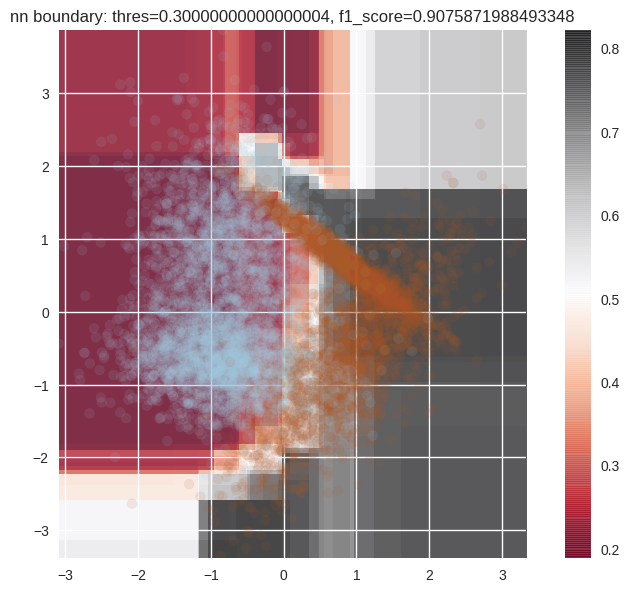

[0.18832714 0.18832714 0.80402884 ... 0.21884847 0.5594717  0.74443531]
[1 0 1 ... 0 1 1]

NN acc = 0.9145, f1 = 0.9192253188474255


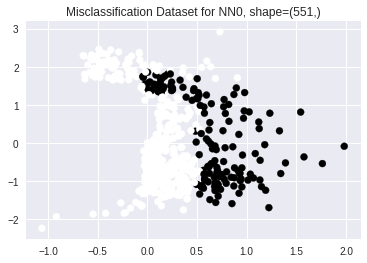

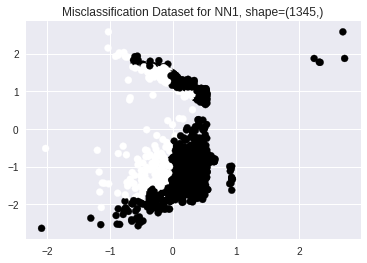

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=4,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
       num_threads=4, objective='regression', random_state=None,
       reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
       subsample_for_bin=200000, subsample_freq=0, verbosity=-1)
LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, n_estimators=300, n_jobs=-1, num_leaves=31,
       num_threads=4, objective='regression', random_state=None,
       reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
       subsample_for_bin=200000, subsample_freq=0, verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


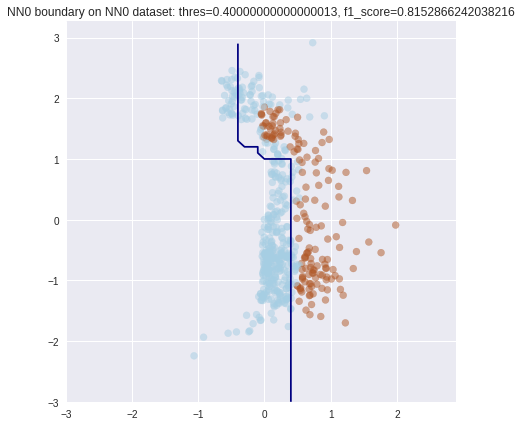

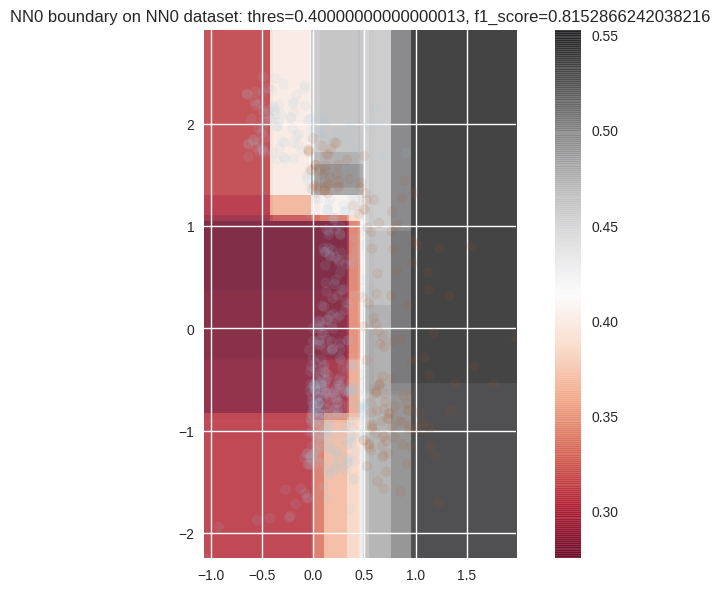

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


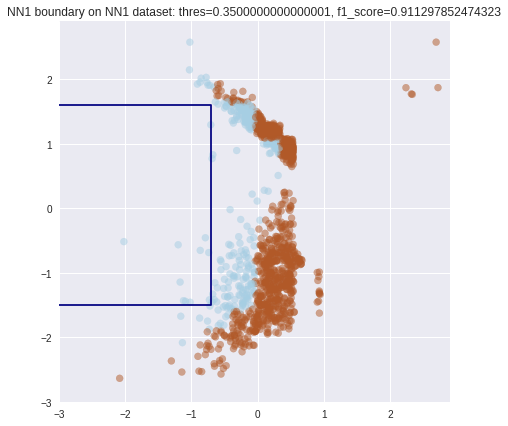

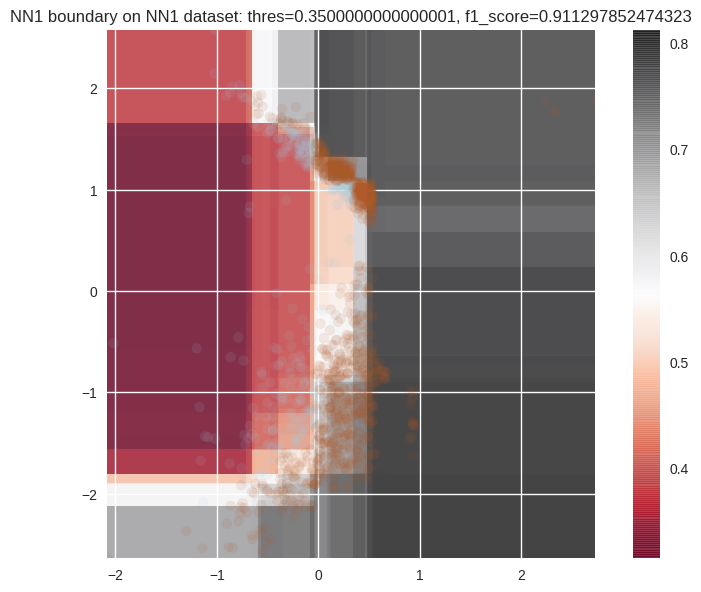

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


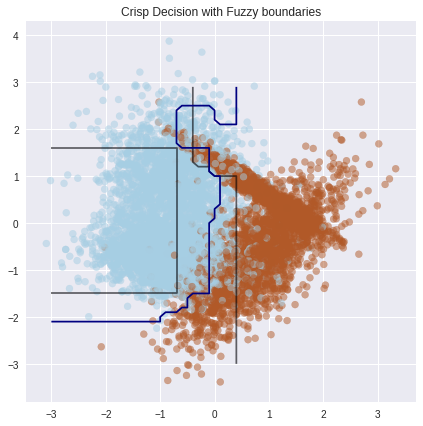

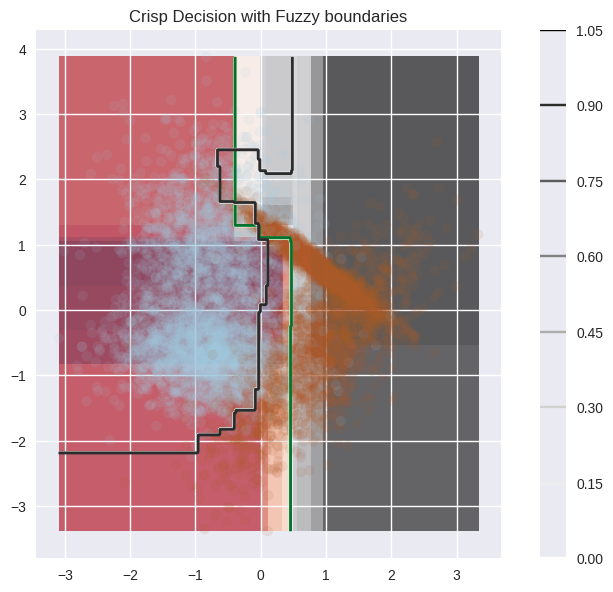

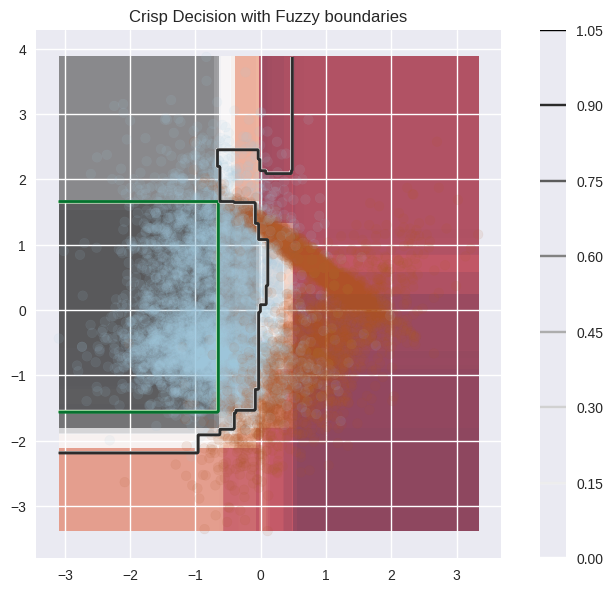

(100,)
(100,)


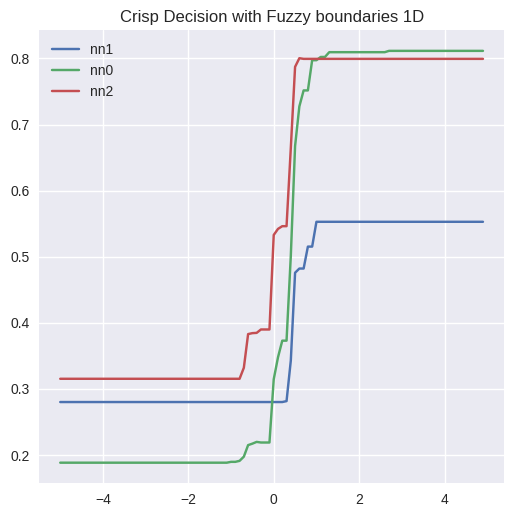

In [0]:
rf_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

In [0]:
|2

2

### Experiment_2: 
- **Gradient boosting** model (**No monotonic constraint**)
- **MAE** loss
- Make Circles


In [0]:
X, y = make_circles(n_samples=10000, random_state=SEED, factor=0.7, noise=0.25)
# X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)

if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 100,
    "max_depth": 4,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=6,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, n_estimators=500, n_jobs=-1, num_leaves=31,
        num_threads=4, objective='binary', random_state=None,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=0, verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


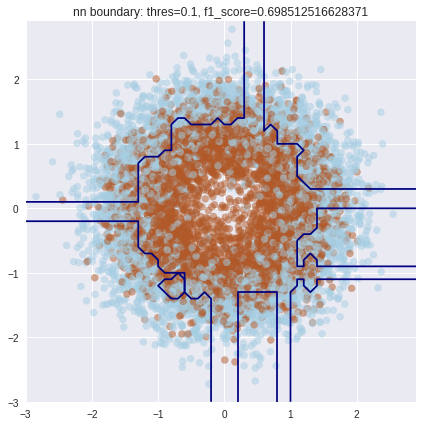

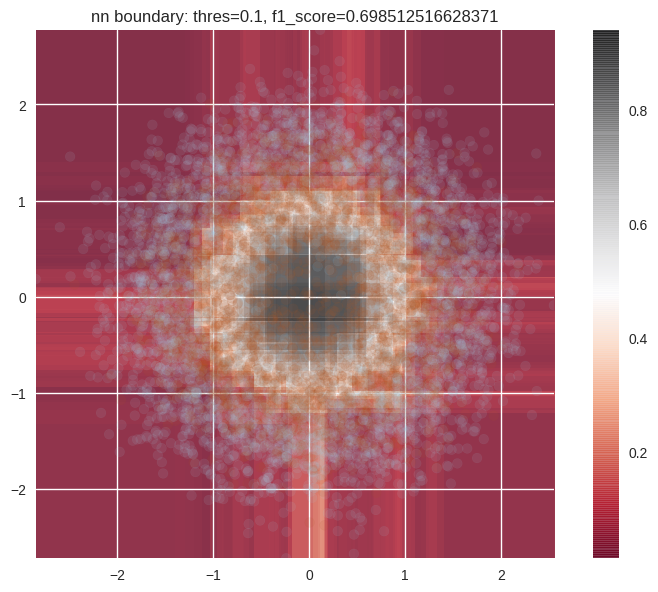

[0.05181114 0.06004721 0.58906142 ... 0.06995192 0.02714277 0.07907647]
[1 1 1 ... 1 1 1]

NN acc = 0.564, f1 = 0.6927413671599718


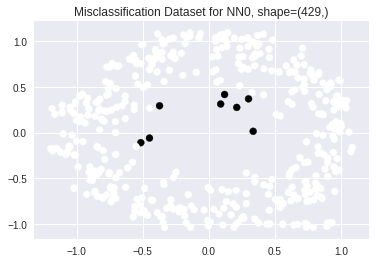

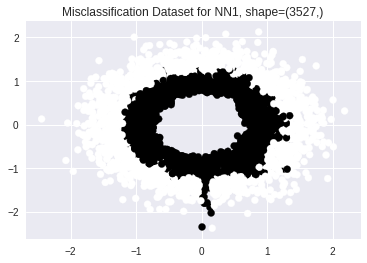

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=4,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=31,
       num_threads=4, objective='regression', random_state=None,
       reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
       subsample_for_bin=200000, subsample_freq=0, verbosity=-1)
LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, n_estimators=300, n_jobs=-1, num_leaves=31,
       num_threads=4, objective='regression', random_state=None,
       reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
       subsample_for_bin=200000, subsample_freq=0, verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


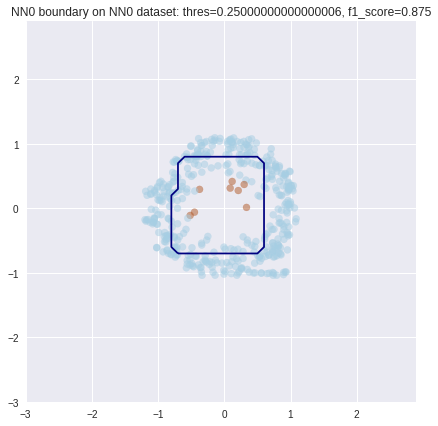

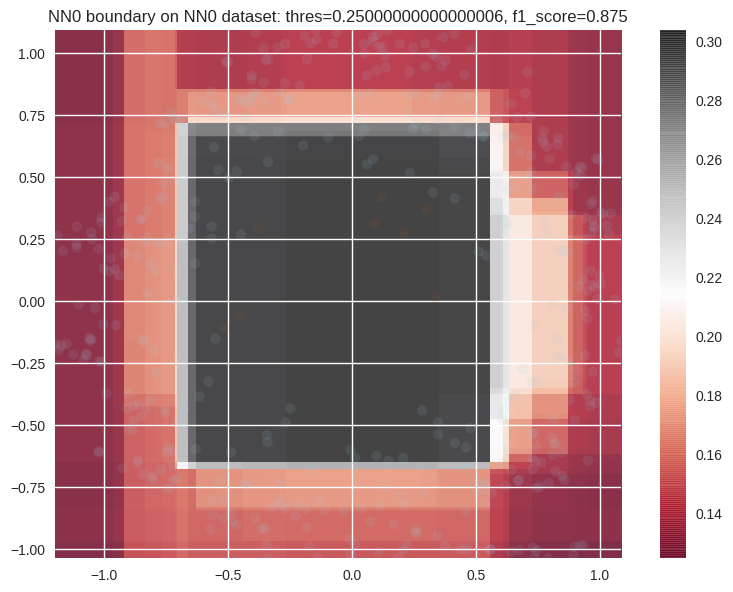

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


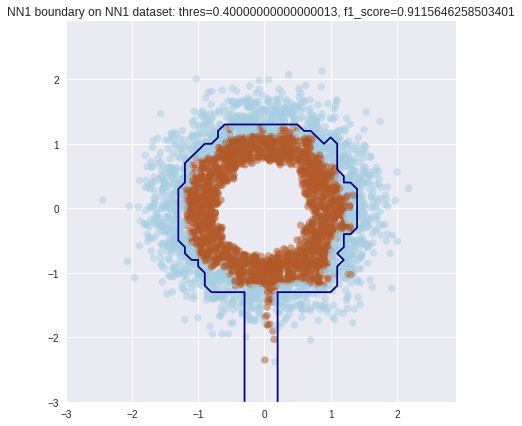

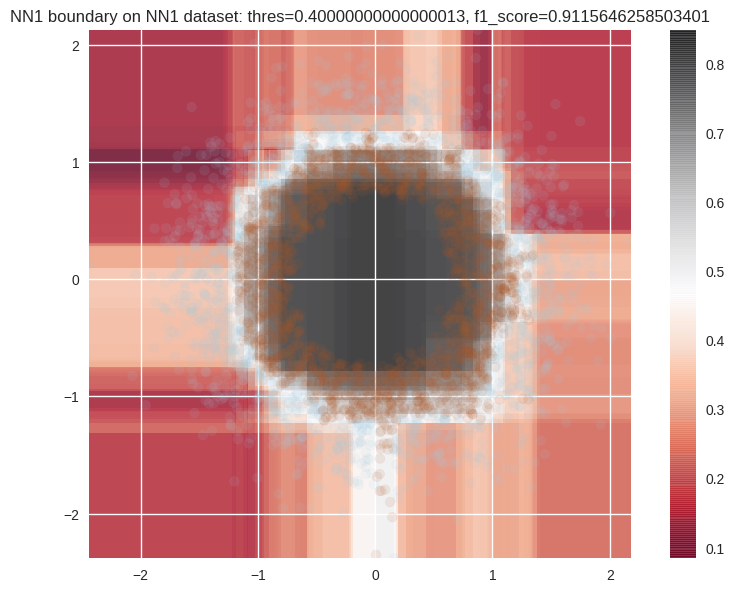

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


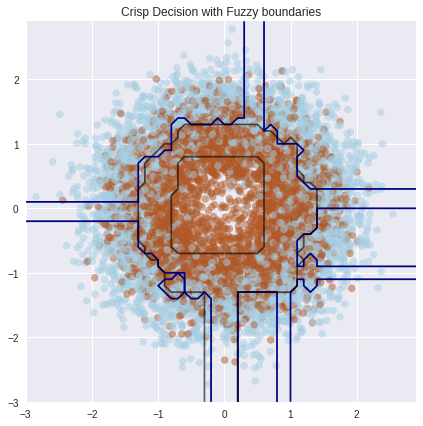

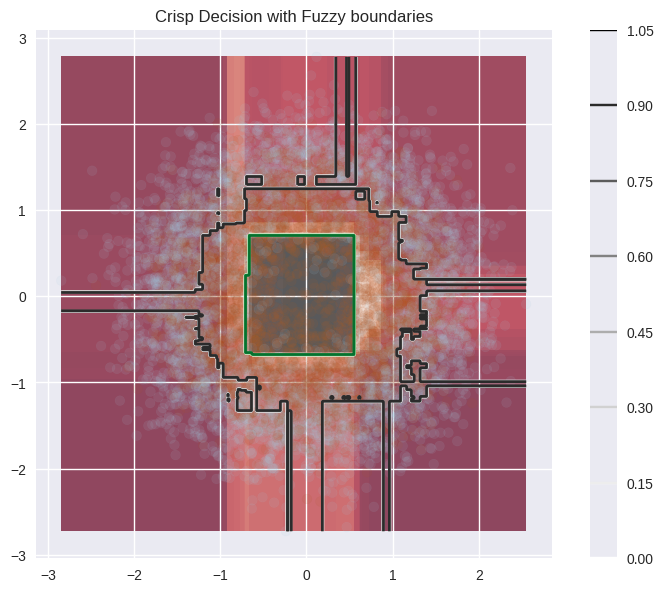

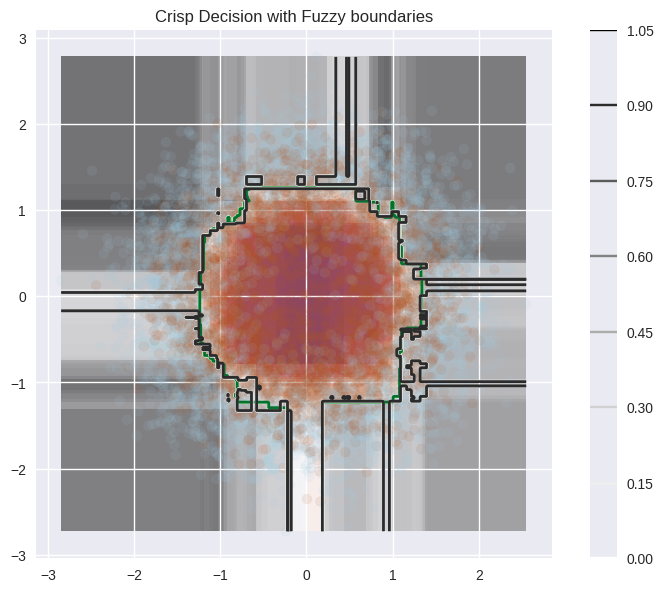

(100,)
(100,)


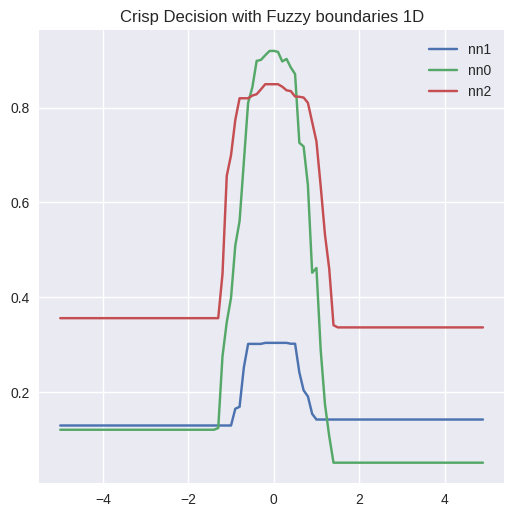

In [0]:
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_3: 
- **Gradient boosting** model (**No monotonic constraint**)
- **MAE** loss
- Make Moons


In [0]:
X, y = make_moons(n_samples=10000, noise=0.35, random_state=SEED)

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=6,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, n_estimators=500, n_jobs=-1, num_leaves=31,
        num_threads=4, objective='binary', random_state=None,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=0, verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


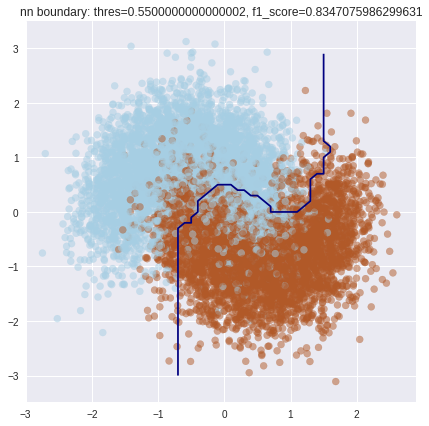

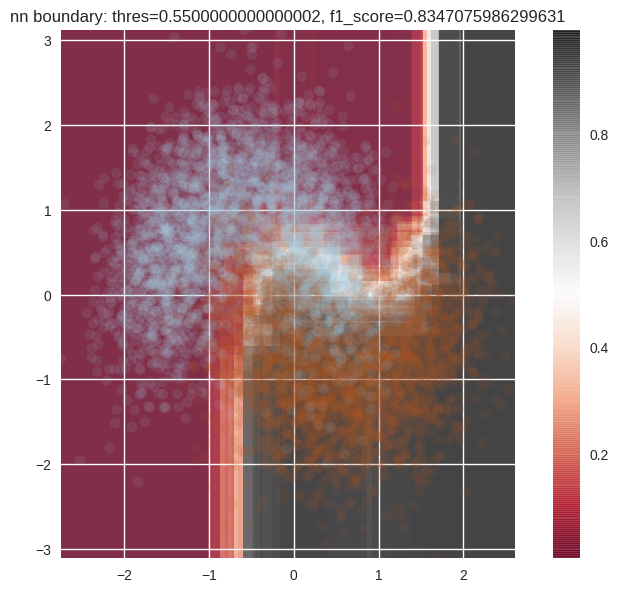

[0.02238656 0.00463737 0.90202008 ... 0.00386801 0.00647039 0.99160082]
[1 0 0 ... 0 1 1]

NN acc = 0.874, f1 = 0.8716904276985744


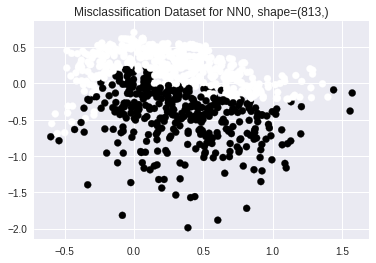

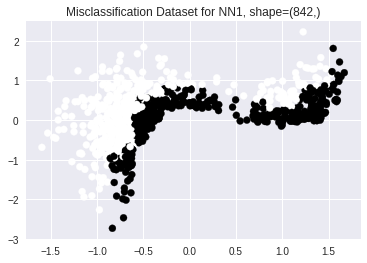

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, n_estimators=300, n_jobs=-1, num_leaves=31,
       num_threads=4, objective='regression', random_state=None,
       reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
       subsample_for_bin=200000, subsample_freq=0, verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, n_estimators=300, n_jobs=-1, num_leaves=31,
       num_threads=4, objective='regression', random_state=None,
       reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
       subsample_for_bin=200000, subsample_freq=0, verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


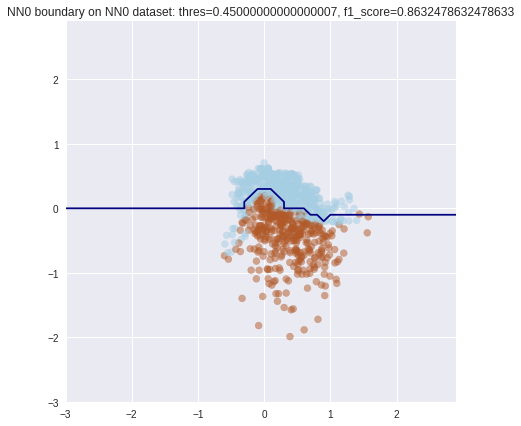

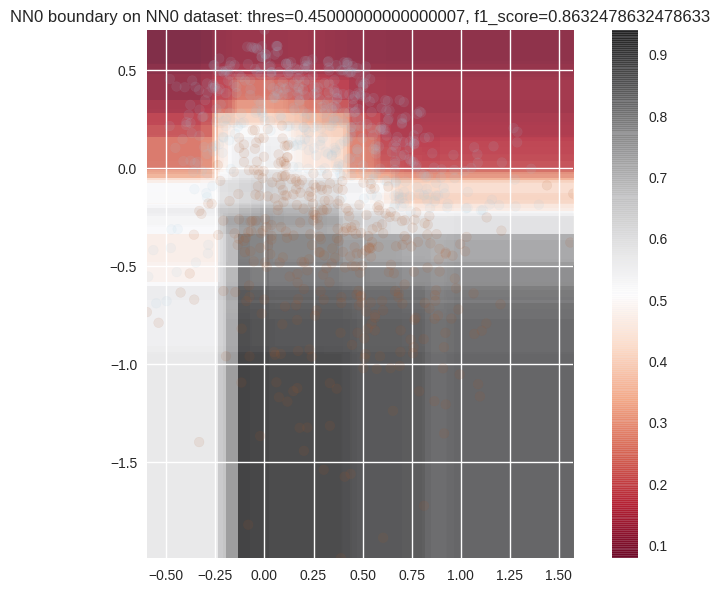

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


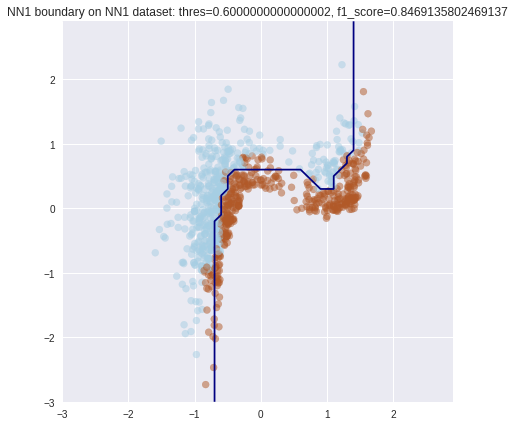

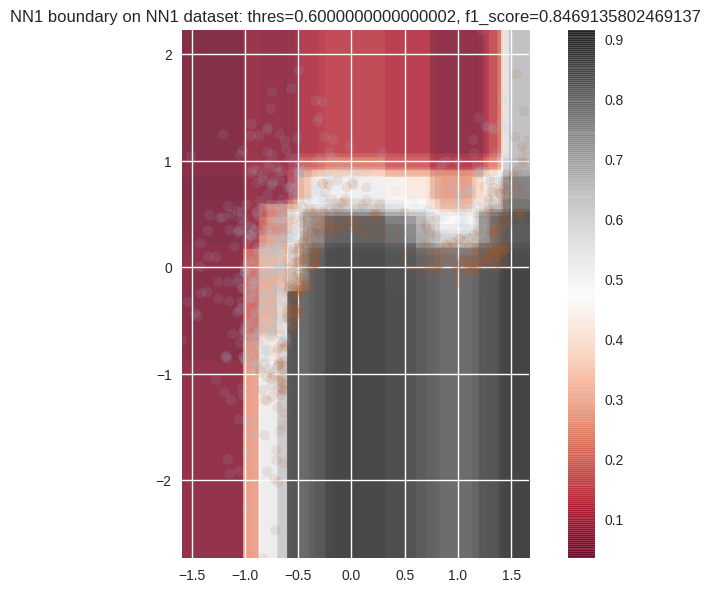

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


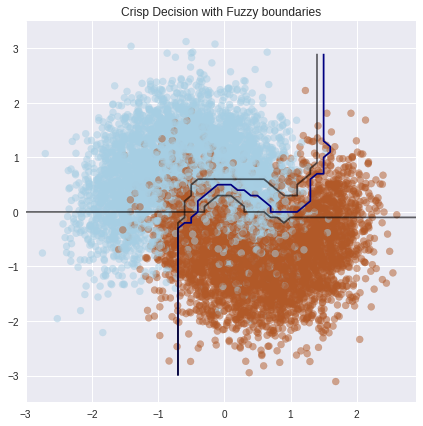

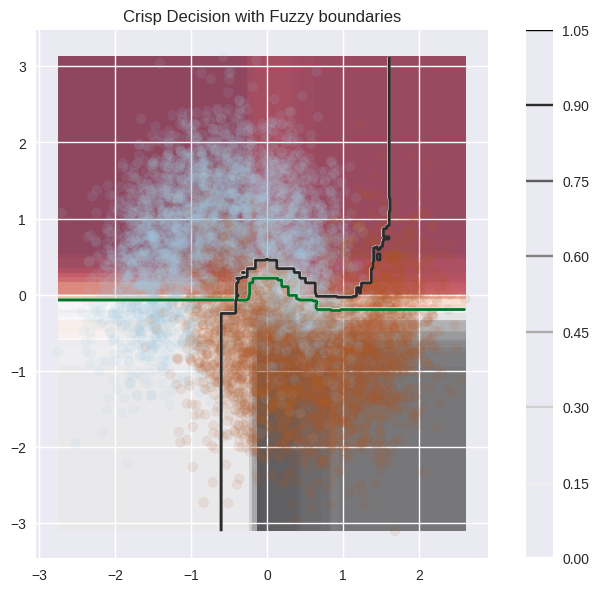

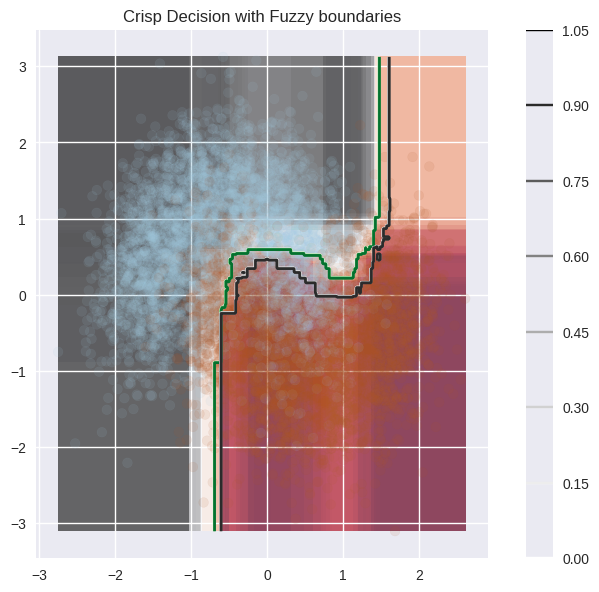

(100,)
(100,)


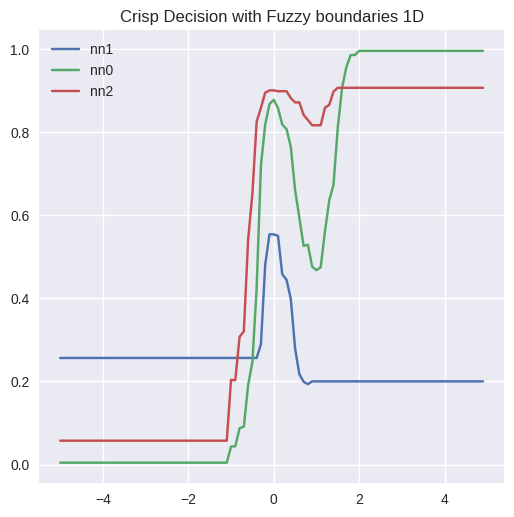

In [0]:
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_4: 
- **Gradient boosting** model (**With Monotonic constraint**)
- **MAE** loss
- Make Moons


In [0]:
X, y = make_moons(n_samples=10000, noise=0.35, random_state=SEED)

In [0]:
if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,1)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (0,1)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=6,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, monotone_constraints=(1, 1), n_estimators=500,
        n_jobs=-1, num_leaves=31, num_threads=4, objective='binary',
        random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
        subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
        verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


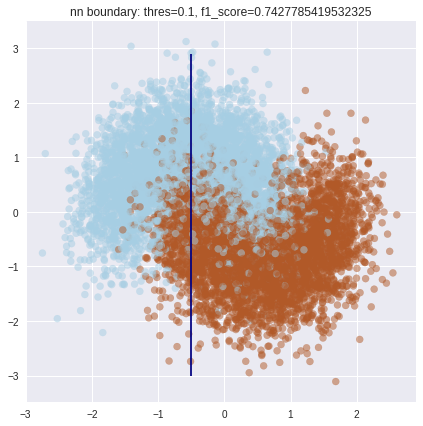

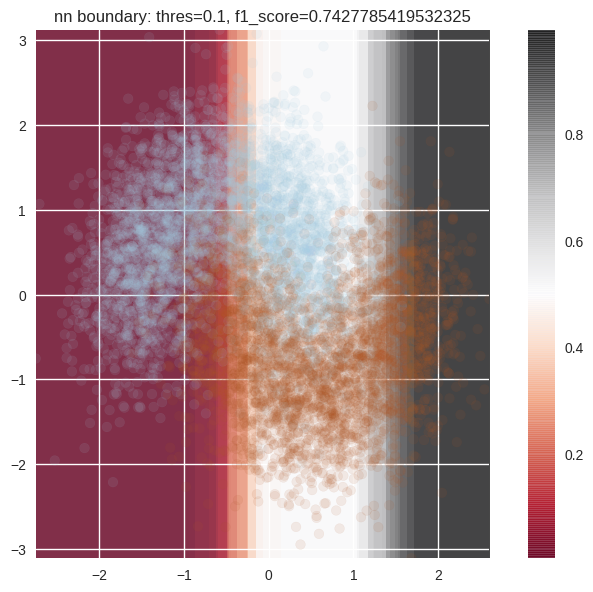

[0.49977397 0.00335734 0.09105029 ... 0.00335734 0.00335734 0.8255741 ]
[1 1 0 ... 1 1 1]

NN acc = 0.6445, f1 = 0.7355894384529565


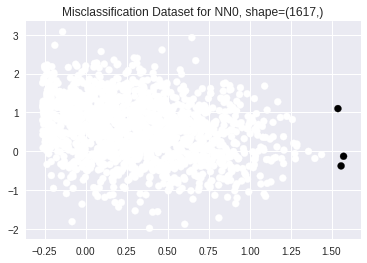

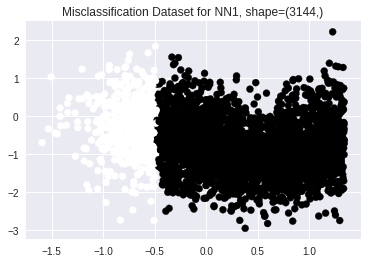

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(1, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(0, 1), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


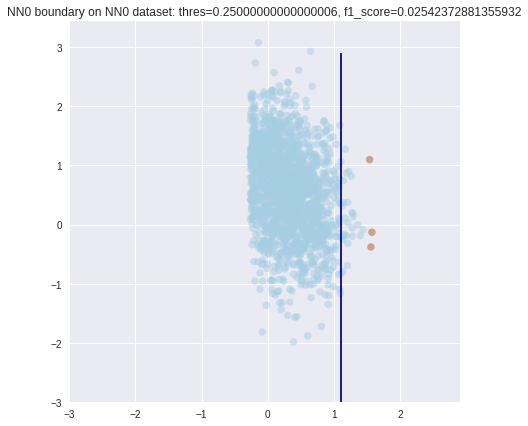

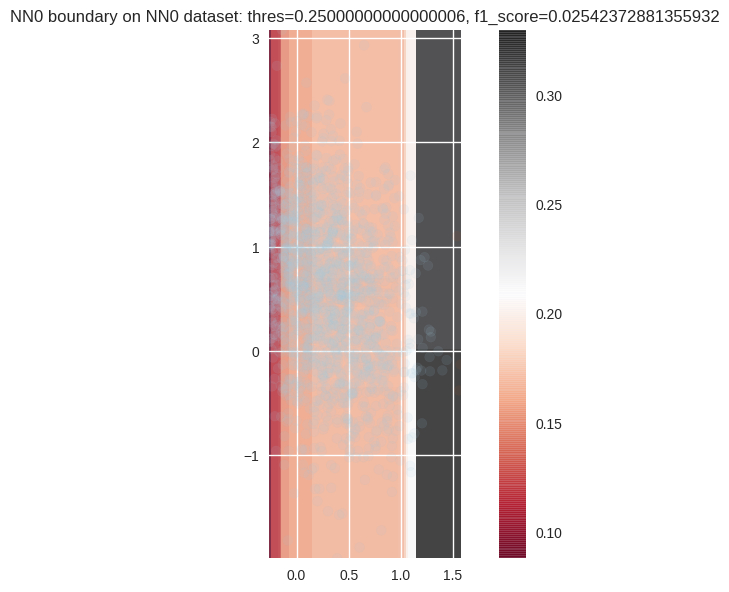

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


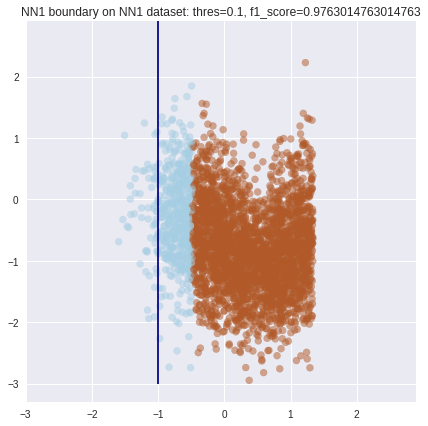

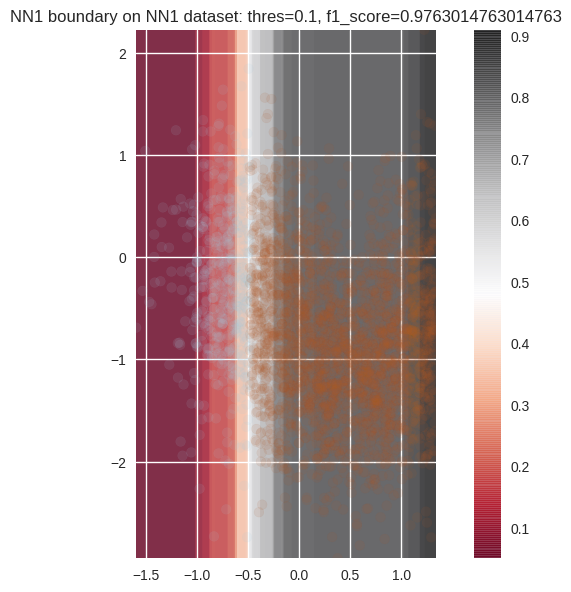

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


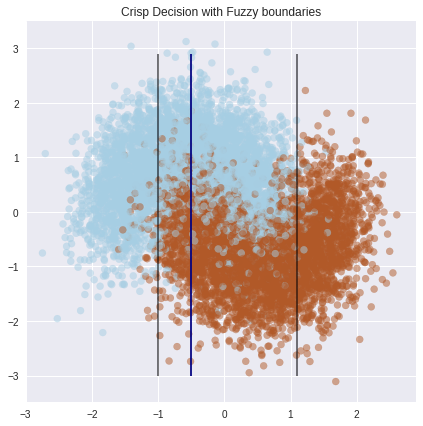

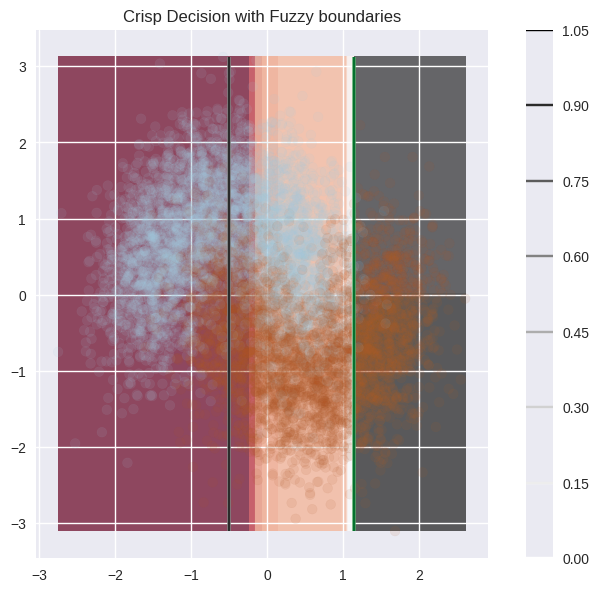

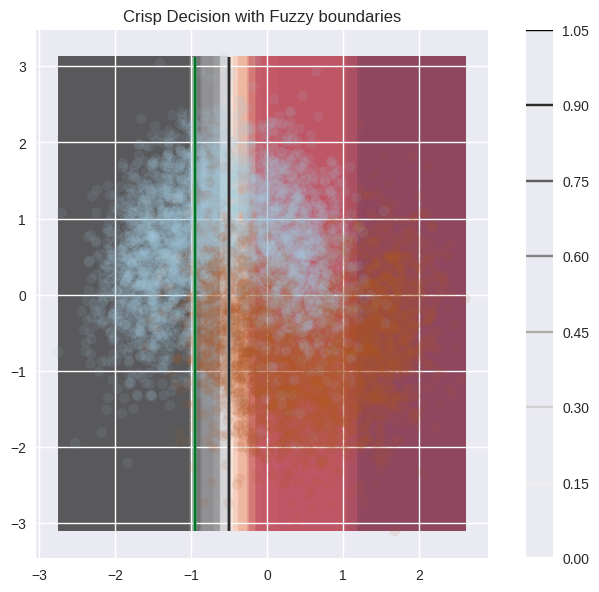

(100,)
(100,)


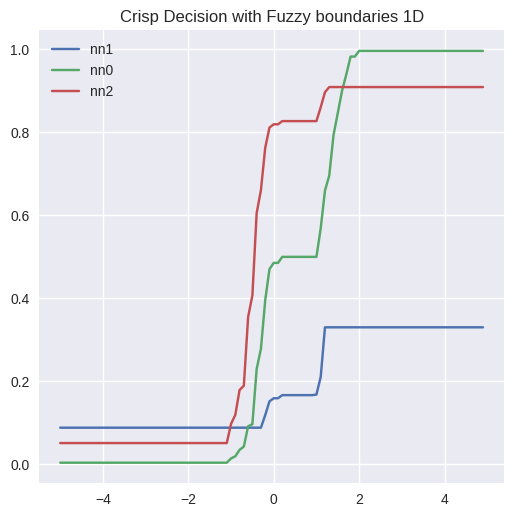

In [0]:
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])

### Experiment_5: 
- **Gradient boosting** model (**With Monotonic constraint**)
- **MAE** loss
- Make Classification


In [0]:
X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_classes=2, random_state=SEED, class_sep=1)



if not GET_MODEL_FROM_GDRIVE:
  lgbm0_config = {
    "name": "lgbm0",
    "verbose": 1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    "learning_rate": 0.01,
    "is_classification": True,
    "n_estimators": 500,
    "max_depth": 6,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,1)
  }
  
  lgbm1_config = {
    "name": "lgbm1",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1,0)
  }
  
  lgbm2_config = {
    "name": "lgbm2",
    "verbose": -1,
    "scaler": StandardScaler(),
    'boosting_type': 'gbdt',
    'metric': 'auc',
    "learning_rate": 0.01,
    "is_classification": False,
    "n_estimators": 300,
    "max_depth": 5,
    'num_threads': 4,
    'get_model_method': make_lgbm_model,
    "monotone_constraints": (1, 0)
  }
  
  # lmbd closer to 0 => fuzzy boundaries closer to decision boundary
  
  experiment_config = {
      'exp_name': 'GB_class',
      'lmbd': -0.8, 
      'thresholds': [0.5, 0.5, 0.5],
      'verbose':True,
      'left_proba': 0.3,
      'right_proba': 0.7
  }

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        importance_type='split', learning_rate=0.01, max_depth=10,
        metric='rmse', min_child_samples=20, min_child_weight=0.001,
        min_split_gain=0.0, monotone_constraints=(1, 1), n_estimators=500,
        n_jobs=-1, num_leaves=31, num_threads=4, objective='binary',
        random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
        subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
        verbosity=1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


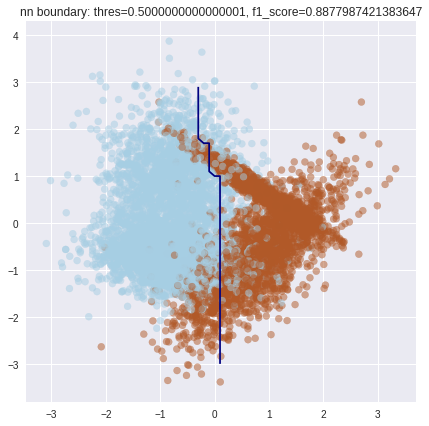

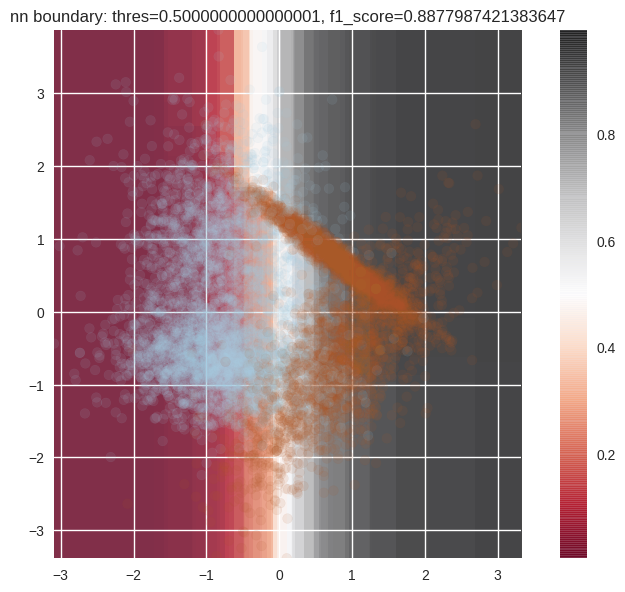

[0.02283481 0.00606314 0.9499582  ... 0.31165886 0.24752006 0.29237488]
[0 0 1 ... 0 0 1]

NN acc = 0.893, f1 = 0.8931068931068931


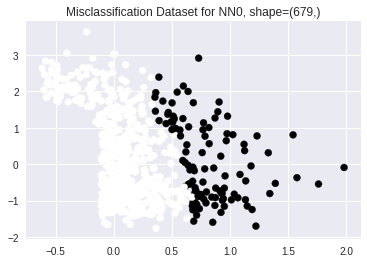

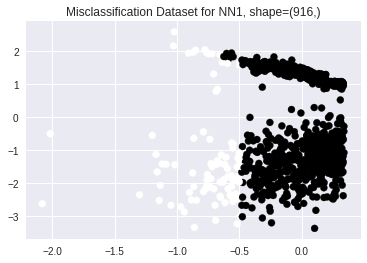

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(1, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.01, max_depth=5,
       metric='auc', min_child_samples=20, min_child_weight=0.001,
       min_split_gain=0.0, monotone_constraints=(1, 0), n_estimators=300,
       n_jobs=-1, num_leaves=31, num_threads=4, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0,
       verbosity=-1)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


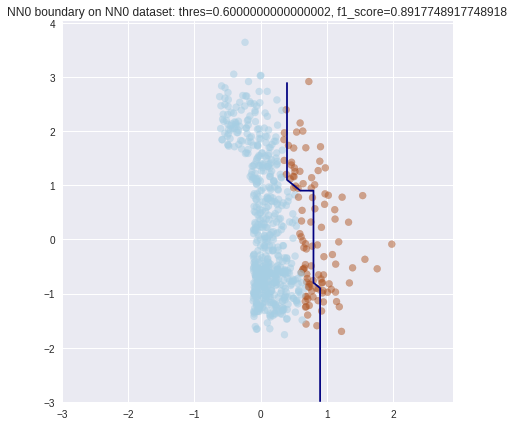

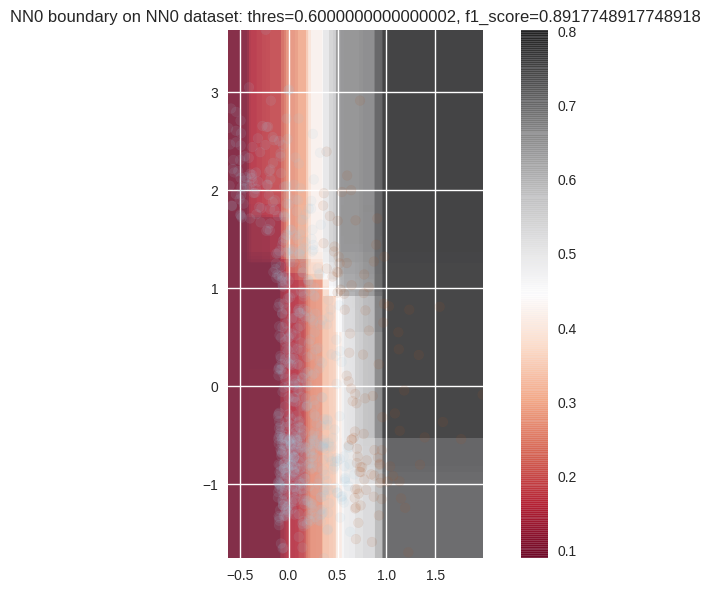

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
No handles with labels found to put in legend.


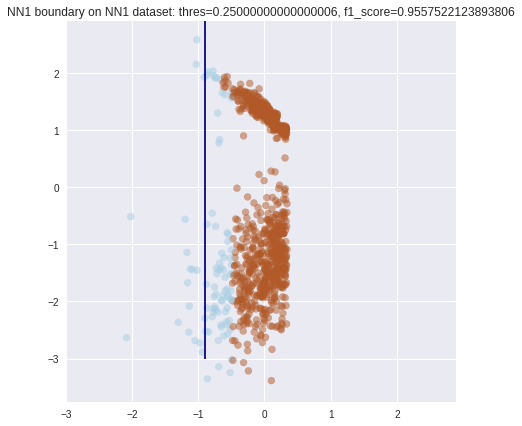

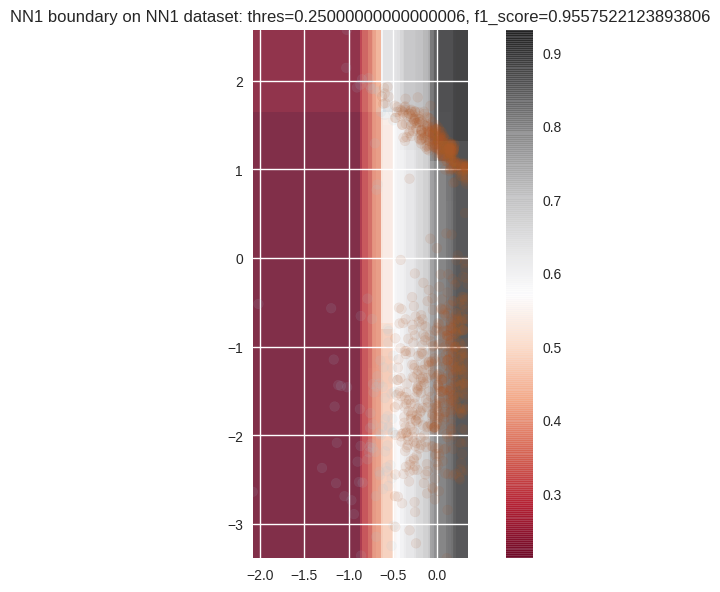

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'label'
  s)


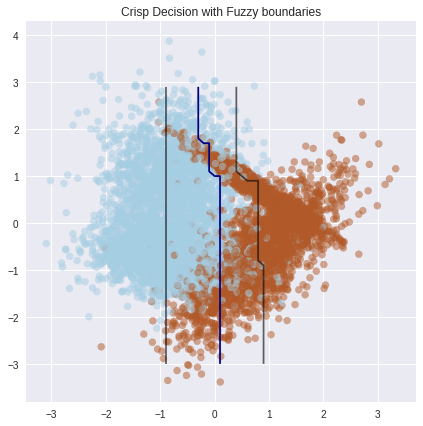

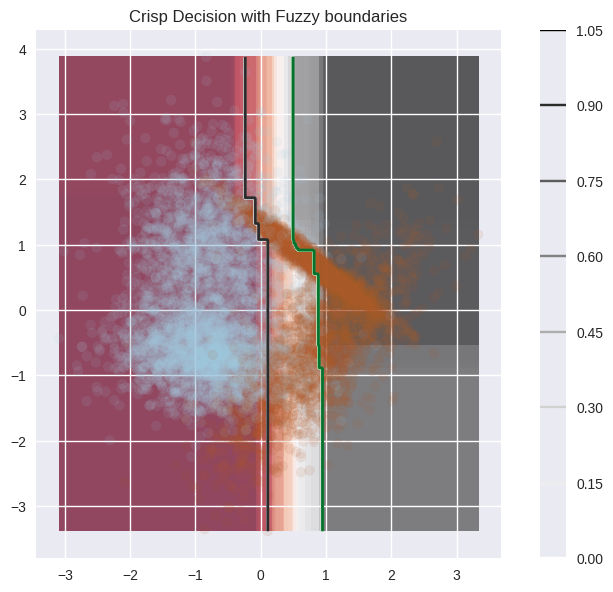

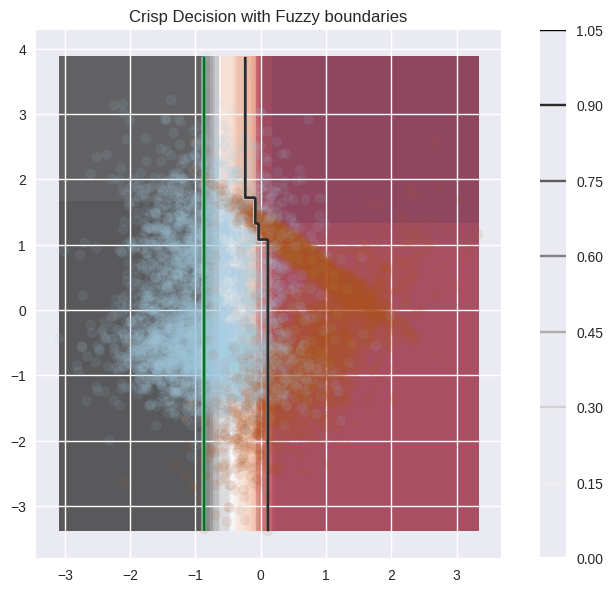

(100,)
(100,)


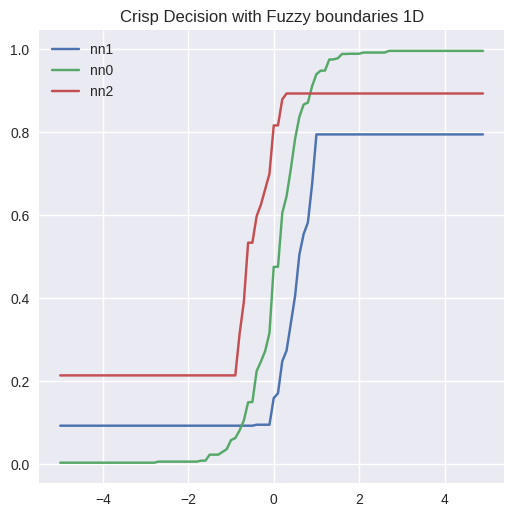

In [0]:
ml_experiment(lgbm0_config, lgbm1_config, lgbm2_config,  
              X, y, experiment_config['lmbd'], experiment_config['thresholds'],
              experiment_config['verbose'], 
              experiment_config['left_proba'], experiment_config['right_proba'])